Sovconsult DOO

# Quantitative interregional analysis of the Russian residential real estate market in apartment buildings as of 2023-12-31 based on Sberindex data (service of Sberbank PJSC) 

Option 1: St. Petersburg and Leningrad Oblast, Moscow and Moscow Oblast are treated as four separate regions

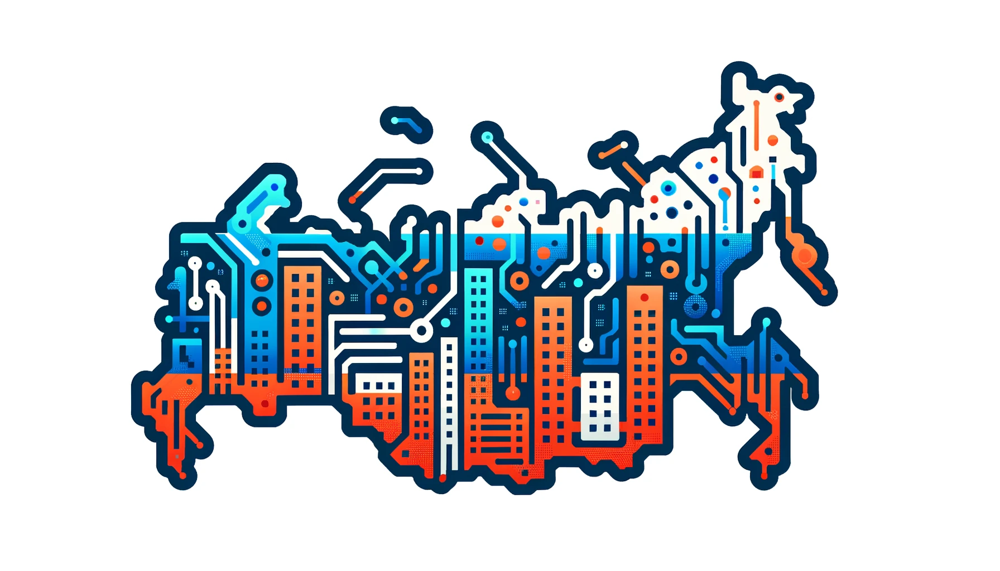

The analysis in this study is based entirely on data provided and made [publicly available](https://sberindex.ru/en/dashboards?partition=7) by [Sberindex](https://sberindex.ru/en). The author of this study, as well as the copyright holder of the [Syväjärvi© machine learning model](https://www.facebook.com/groups/1977067932456703) used in this study ([Sovconsult DOO](https://sovconsult.tech)) and the cloud infrastructure provider of this model (Meleksa Research AB) are not affiliated with Sberindex or Sberbank. Neither Sberindex nor Sberbank PJSC have any connection with this study and take no responsibility for its findings and conclusions. 

This study is distributed under the terms of the [CC BY-SA 4.0 license](https://creativecommons.org/licenses/by-sa/4.0/). All data, models, findings and results are provided "as is" and for informational purposes only. The author of the study, as well as the developer of the Syväjärvi© model or its infrastructure provider, assumes no responsibility for the consequences of using this study and makes no warranty as to the accuracy and correctness of its contents.
Any private or corporate user assumes all risks associated with the use of this study.

This study, as well as all products created using the Syväjärvi© model, is based on the following principles:
1) agreement with the validity of the [Efficient Market Hypothesis](https://en.wikipedia.org/wiki/Efficient-market_hypothesis);
2) the [KISS principle](https://en.wikipedia.org/wiki/KISS_principle);
3) compliance with the requirements of paragraph 3 of [IFRS 13 Fair Value Measurement](https://www.ifrs.org/issued-standards/list-of-standards/ifrs-13-fair-value-measurement/#about).

There are two versions of this study. In one version, St. Petersburg, Leningrad Oblast, Moscow, and Moscow Oblast are considered as four separate regions. In the second version, St. Petersburg and Leningrad Oblast are combined into the economic macro region "Ingria"; Moscow and Moscow Oblast &mdash; "Greater Moscow".

## 00 Information about the data used

|Data|Rights holder|License|URL|
| :- | :- | :- | :- |
|Quantitative data on the multifamily real estate market|Sberbank PJSC|undefined|[https://sberindex.ru/en/dashboards?partition=7](https://sberindex.ru/en/dashboards?partition=7)|
|Regional coordinate data in GeoJSON format|Sole proprietor Dmitry Evgenyevich Savostyanov|undefined|[https://mydata.biz/ru/catalog/databases/borders_ru](https://mydata.biz/ru/catalog/databases/borders_ru)|

## 0 Information on the materials resulting from this study 

Основные результаты приводятся в тексте данного исследования. Дополнительные материалы доступны по ссылкам из таблицы.

|Material|Link|
| :- | :- |
|Main repository|https://github.com/Kirill-Murashev/sberindex|
|Main text of the study in Russian with qualitative rendering |https://nbviewer.org/github/Kirill-Murashev/sberindex/blob/master/ru_flats_2023_dec_rus.ipynb|
|Main text of the study in English with qualitative rendering |https://nbviewer.org/github/Kirill-Murashev/sberindex/blob/master/ru_flats_2023_dec_eng.ipynb|
|Main text of the study in Chinese with qualitative rendering |https://nbviewer.org/github/Kirill-Murashev/sberindex/blob/master/ru_flats_2023_dec_chn.ipynb|
|Source data in UTF-8 encoding|https://web.tresorit.com/l/mhRxz#phwMYN_at8U-x1ZBHUfbjQ|
|Source data summarized into a single file in XLSX format|https://web.tresorit.com/l/BwLdB#WfcPGKOySdyvUgruGdGYig|
|PNG and HTML heat maps (interactive on OSM map base)|https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg|
|Charts and graphs|https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA|

## 1 Getting Started

Connecting Syväjärvi.

In [1]:
import pandas as pd
import syvajarvi as syv

Loading and cleansing Sberindex data.

In [2]:
# Set the display options to show all rows and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Fetch data for December 2023
primary_deals, secondary_deals, primary_offers,\
secondary_offers, primary_volumes, secondary_volumes,\
secondary_exposure = syv.read_sberindex_flats('2023-12%')

# Check data
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure = syv.check_consistency(primary_deals,\
                                                                             secondary_deals,\
                                                                             primary_offers,\
                                                                             secondary_offers,\
                                                                             primary_volumes,\
                                                                             secondary_volumes,\
                                                                             secondary_exposure)




Let's calculate discounts when moving from bid prices to transaction prices.

In [3]:
# Calculate discount rates
primary_discounts = syv.calculate_discount(primary_deals, primary_offers)
secondary_discounts = syv.calculate_discount(secondary_deals, secondary_offers)

Let's calculate the ratios between the primary and secondary markets. The ratio is calculated as the ratio of some value of the primary market to the corresponding value of the secondary market.

In [4]:
# Calculate ratios between primary and secondary markets
deals_ratios = syv.calculate_market_ratios(primary_deals, secondary_deals, 'value')
offers_ratios = syv.calculate_market_ratios(primary_offers, secondary_offers, 'value')
volumes_ratios = syv.calculate_market_ratios(primary_volumes, secondary_volumes, 'value')
discounts_ratios = syv.calculate_market_ratios(primary_discounts, secondary_discounts, 'value')

We add a variable with standardized values. Standardization was performed using the z-score method:

\begin{align}
z_{i} = \frac{x_{i} - \mu }{\sigma},
\end{align}

where $x_{i}$ &mdash; is original value of the indicator for the i-th observation, $\mu$ &mdash; is mean value of the indicator, $\sigma$ &mdash; is standard deviation of the indicator.

In [5]:
# Define a list of data frames
sberindex_data_frames = [primary_deals,\
                         secondary_deals,\
                         primary_offers,\
                         secondary_offers,\
                         primary_volumes,\
                         secondary_volumes,\
                         secondary_exposure,\
                         primary_discounts,\
                         secondary_discounts,\
                         deals_ratios,\
                         offers_ratios,\
                         volumes_ratios,\
                         discounts_ratios]

# Define the column to standardize
column_name = 'value'

# Apply the function to each data frame in the list
for i in range(len(sberindex_data_frames)):
    sberindex_data_frames[i] = syv.add_standardized_column(sberindex_data_frames[i],
                                                           column_name, exclude_regions=['Россия'])

# Update individual data frames
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure,\
primary_discounts, secondary_discounts, deals_ratios,\
offers_ratios, volumes_ratios, discounts_ratios = sberindex_data_frames



In [6]:
# Apply the smart sorting function to each data frame in the list directly
for i in range(len(sberindex_data_frames)):
    sberindex_data_frames[i] = syv.sberindex_regions_smart_sorting(sberindex_data_frames[i])
    
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure,\
primary_discounts, secondary_discounts, deals_ratios,\
offers_ratios, volumes_ratios, discounts_ratios = sberindex_data_frames


The following data frames will be used in the study.

|Name of data frame|Description|
| :- | :- |
|primary_deals|data on mean transaction prices per square meter in the primary market|
|secondary_deals|data on mean transaction prices per square meter in the secondary market|
|primary_offers|data on median asking prices per square meter in the primary market|
|secondary_offers|data on median asking prices per square meter in the secondary market|
|primary_volumes|primary market supply data|
|secondary_volumes|secondary market supply data|
|secondary_exposure|data on the mean duration of secondary market exposures|
|primary_discounts|data on the typical discount in the transition from bid to transaction prices in the primary market|
|secondary_discounts|data on the typical discount in the transition from bid to transaction prices in the secondary market|
|deals_ratios|ratio of primary market transaction prices to secondary market transaction prices|
|offers_ratios|ratio of primary market bid prices to secondary market transaction prices|
|volumes_ratios|ratio of primary market supply to secondary market supply|
|discounts_ratios|ratio of the typical value of the discount at the transition from offer prices to transaction prices in the primary market to the similar indicator in the secondary market|


## 2 Key market data

### 2.1 Tables

Data on mean transaction prices in the primary market.

In [7]:
primary_deals[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",222383,2.893341
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",160999,1.237648
2,"Москва, Moscow, 莫斯科",294745,4.845140
3,"Московская область, Moscow Oblast, 莫斯科州",177221,1.675199
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",171573,1.522857
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",109222,-0.158918
6,"Амурская область, Amur Oblast, 阿穆尔州",146185,0.838074
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",124650,0.257217
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",124954,0.265416
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",104397,-0.289062


Median primary market bid price data.

In [8]:
primary_offers[['region', 'value', 'standardized_value' ]]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",244244.0,2.655483
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",161003.0,0.792491
2,"Москва, Moscow, 莫斯科",376354.0,5.612199
3,"Московская область, Moscow Oblast, 莫斯科州",196680.0,1.590967
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",174758.0,1.100337
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",117001.0,-0.192305
6,"Амурская область, Amur Oblast, 阿穆尔州",166531.0,0.916211
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",131841.0,0.139825
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",121965.0,-0.081207
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",106772.0,-0.421237


Data on mean transaction prices in the secondary market.

In [9]:
secondary_deals[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",176875,2.629769
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",118719,0.823191
2,"Москва, Moscow, 莫斯科",278115,5.774724
3,"Московская область, Moscow Oblast, 莫斯科州",141727,1.537920
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",141424,1.528507
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",83105,-0.283135
6,"Амурская область, Amur Oblast, 阿穆尔州",121929,0.922908
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",84350,-0.244459
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",72362,-0.616859
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",78073,-0.439450


Median secondary market bid price data.

In [10]:
secondary_offers[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",201807.0,2.821604
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",153951.0,1.420048
2,"Москва, Moscow, 莫斯科",303514.0,5.800292
3,"Московская область, Moscow Oblast, 莫斯科州",163793.0,1.708290
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",130567.0,0.735202
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",97682.1,-0.227896
6,"Амурская область, Amur Oblast, 阿穆尔州",150852.0,1.329288
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",97296.8,-0.239181
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",77779.0,-0.810797
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",87981.5,-0.511997


Data on the number of offers on the primary market.

In [11]:
primary_volumes[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",30976,0.310223
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",25935,0.223048
2,"Москва, Moscow, 莫斯科",64787,0.894924
3,"Московская область, Moscow Oblast, 莫斯科州",35975,0.396672
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",64491,0.889805
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",2013,-0.190641
6,"Амурская область, Amur Oblast, 阿穆尔州",604,-0.215007
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1922,-0.192215
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",2317,-0.185384
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",521,-0.216442


Data on the number of offers on the secondary market.

In [12]:
secondary_volumes[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",35536,0.317904
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",15475,0.016965
2,"Москва, Moscow, 莫斯科",30343,0.240002
3,"Московская область, Moscow Oblast, 莫斯科州",32074,0.265969
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",75555,0.918236
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",3874,-0.157064
6,"Амурская область, Amur Oblast, 阿穆尔州",3603,-0.161130
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",3098,-0.168705
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",2739,-0.174091
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",6616,-0.115931


Data on the mean duration of secondary market exposures.

In [13]:
secondary_exposure[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",78.7843,0.627948
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",95.3276,1.381960
2,"Москва, Moscow, 莫斯科",61.2008,-0.173473
3,"Московская область, Moscow Oblast, 莫斯科州",73.9804,0.408996
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",79.1533,0.644767
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",50.6915,-0.652467
6,"Амурская область, Amur Oblast, 阿穆尔州",61.1468,-0.175935
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",86.2588,0.968622
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",51.2285,-0.627992
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",87.8147,1.039537


Data on the typical discount in the transition from bid to transaction prices in the primary market.

In [14]:
primary_discounts[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.089505,0.111710
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0.000025,-0.925774
2,"Москва, Moscow, 莫斯科",0.216841,1.588123
3,"Московская область, Moscow Oblast, 莫斯科州",0.098937,0.221077
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.018225,-0.714748
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.066487,-0.155176
6,"Амурская область, Amur Oblast, 阿穆尔州",0.122175,0.490513
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.054543,-0.293658
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.000000,-0.926062
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.022244,-0.668156


Data on the typical discount in the transition from bid to transaction prices in the secondary market.

In [15]:
secondary_discounts[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.123544,-0.113457
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0.228852,1.812526
2,"Москва, Moscow, 莫斯科",0.083683,-0.842469
3,"Московская область, Moscow Oblast, 莫斯科州",0.134719,0.090923
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.000000,-2.372950
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.149230,0.356318
6,"Амурская область, Amur Oblast, 阿穆尔州",0.191731,1.133619
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.133065,0.060677
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.069646,-1.099193
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.112620,-0.313237


Data on the ratio of primary to secondary market transaction prices (primary market as numerator).

In [16]:
deals_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",1.257289,-0.048358
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",1.356135,0.589138
2,"Москва, Moscow, 莫斯科",1.059795,-1.322071
3,"Московская область, Moscow Oblast, 莫斯科州",1.250439,-0.092535
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",1.213182,-0.332824
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",1.314265,0.319102
6,"Амурская область, Amur Oblast, 阿穆尔州",1.198935,-0.424703
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1.477771,1.373617
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",1.726790,2.979638
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",1.337172,0.466836


Data on the ratio of primary to secondary market bid prices (primary market as numerator).

In [17]:
offers_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",1.210285,0.086874
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",1.045807,-0.820290
2,"Москва, Moscow, 莫斯科",1.239989,0.250703
3,"Московская область, Moscow Oblast, 莫斯科州",1.200784,0.034472
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",1.338455,0.793781
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",1.197773,0.017866
6,"Амурская область, Amur Oblast, 阿穆尔州",1.103936,-0.499682
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1.355039,0.885253
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",1.568097,2.060351
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",1.213573,0.105010


Data on the ratio of primary to secondary market volume (primary market as numerator).

In [18]:
volumes_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.871679,0.264211
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",1.675929,1.520453
2,"Москва, Moscow, 莫斯科",2.135155,2.237767
3,"Московская область, Moscow Oblast, 莫斯科州",1.121625,0.654628
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.853564,0.235914
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.519618,-0.285711
6,"Амурская область, Amur Oblast, 阿穆尔州",0.167638,-0.835506
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.620400,-0.128288
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.845929,0.223989
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.078748,-0.974352


Data on the ratio of discounts when moving from offer prices to primary and secondary market transaction prices (primary market as numerator).

In [19]:
discounts_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.724478,0.028314
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0.000109,-0.750062
2,"Москва, Moscow, 莫斯科",2.591216,2.034229
3,"Московская область, Moscow Oblast, 莫斯科州",0.734399,0.038975
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.000000,-0.750178
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.445531,-0.271430
6,"Амурская область, Amur Oblast, 阿穆尔州",0.637223,-0.065446
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.409897,-0.309721
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.000000,-0.750178
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.197510,-0.537942


### 2.2 Charts

Let's create a chart of the top 10 regions by price per square meter of primary market transactions.

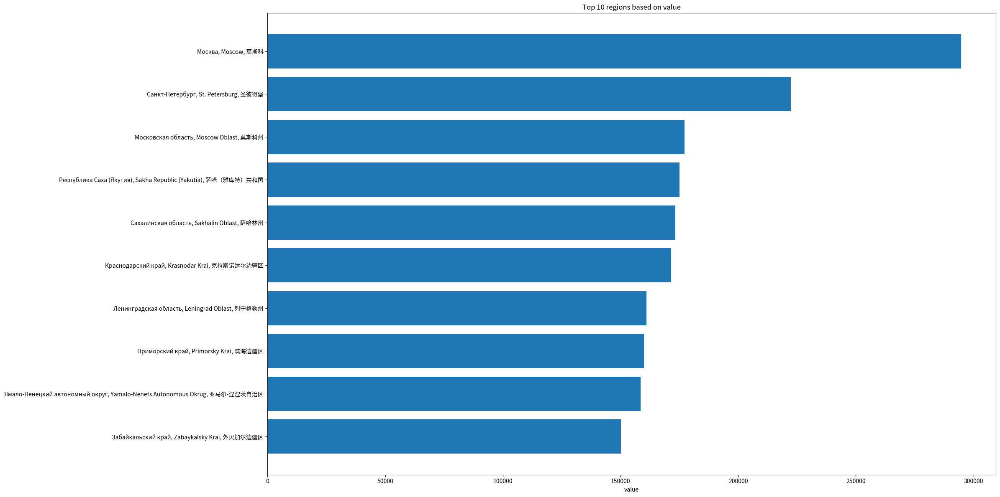

In [20]:
syv.plot_regions_barcharts(df=primary_deals,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="primary_deals")


Let's make a chart of the top 10 regions by cost per square meter of primary market listings.

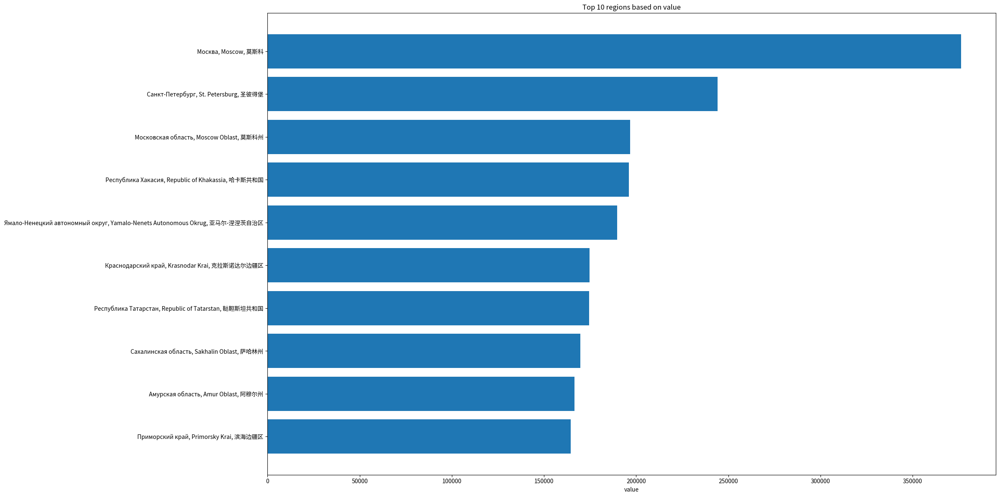

In [21]:
syv.plot_regions_barcharts(df=primary_offers,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="primary_offers")

Let's create a chart of the top 10 regions by price per square meter of secondary market transactions.

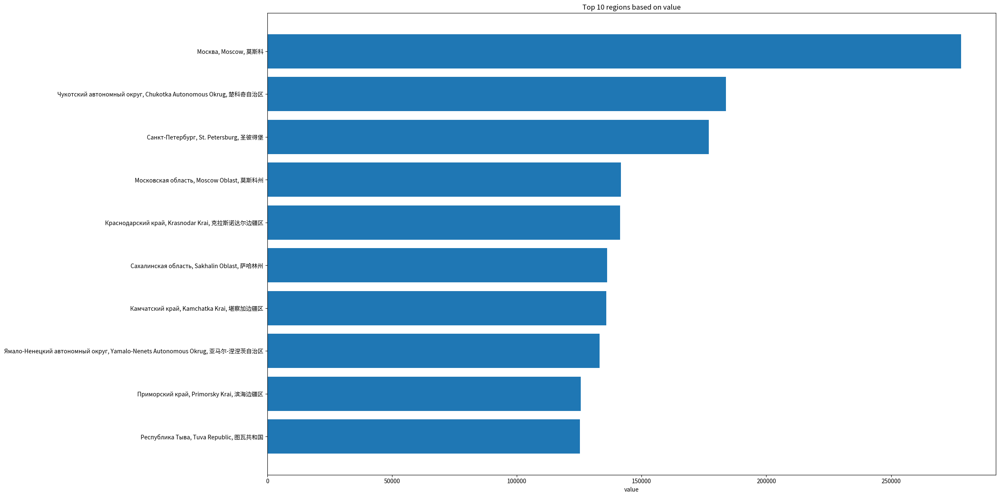

In [22]:
syv.plot_regions_barcharts(df=secondary_deals,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="secondary_deals")

Let's make a chart of the top 10 regions by cost per square meter of secondary market listings.

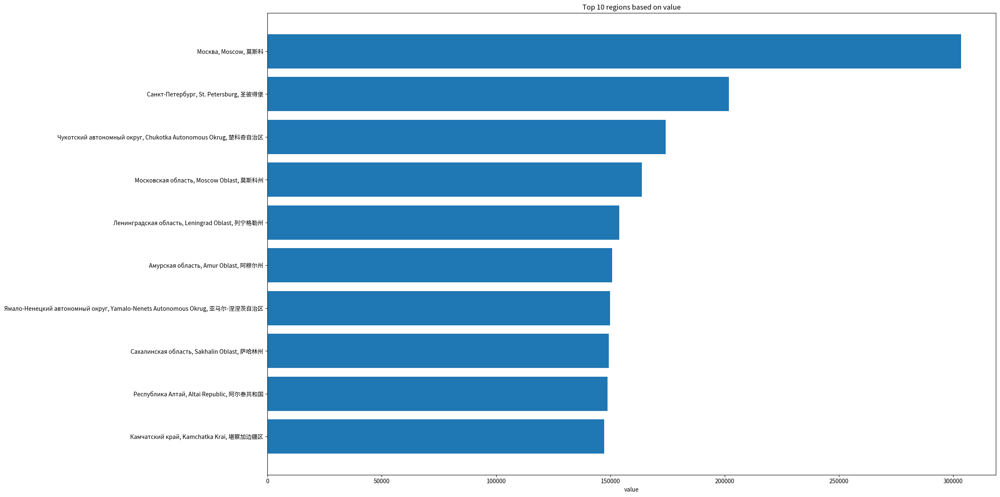

In [23]:
syv.plot_regions_barcharts(df=secondary_offers,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="secondary_offers")

Let's build a diagram of the volume of listings in the regions on the primary market.

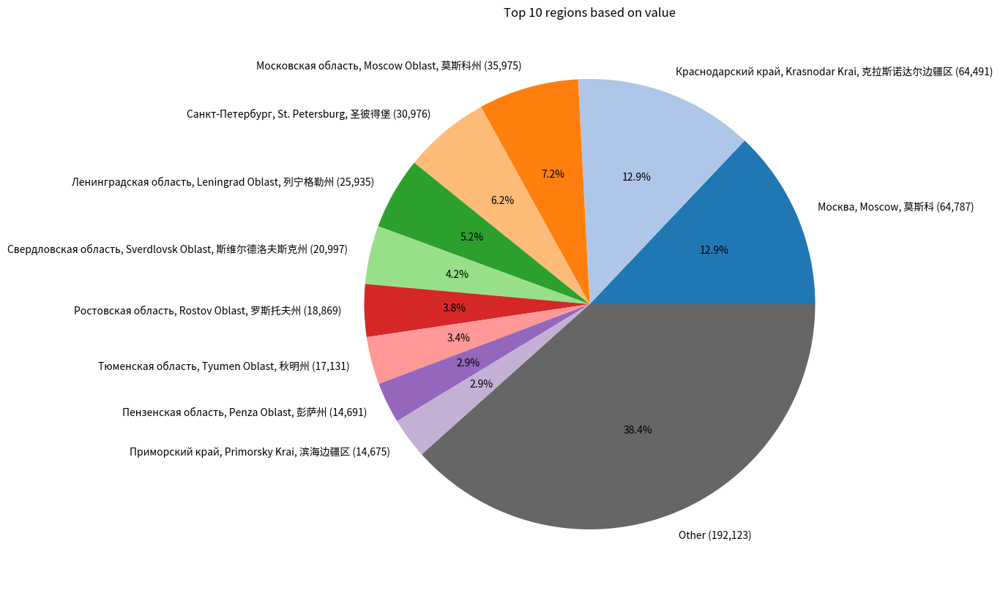

In [24]:
syv.plot_pie_chart(df=primary_volumes,\
                   column='value',\
                   exclude_regions=['Россия, Russia, 俄罗斯'],\
                   num_regions=10,\
                   data_frame_name="primary_volumes")


Let's build a diagram of the volume of listings in the regions on the secondary market.

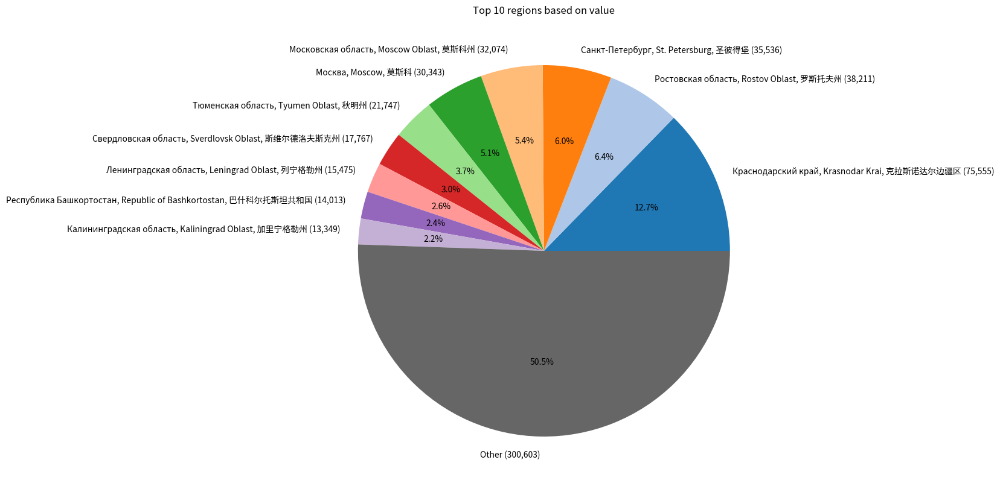

In [25]:
syv.plot_pie_chart(df=secondary_volumes,\
                   column='value',\
                   exclude_regions=['Россия, Russia, 俄罗斯'],\
                   num_regions=10,\
                   data_frame_name="secondary_volumes")

Let's make a diagram of the top 10 regions by secondary real estate liquidity.

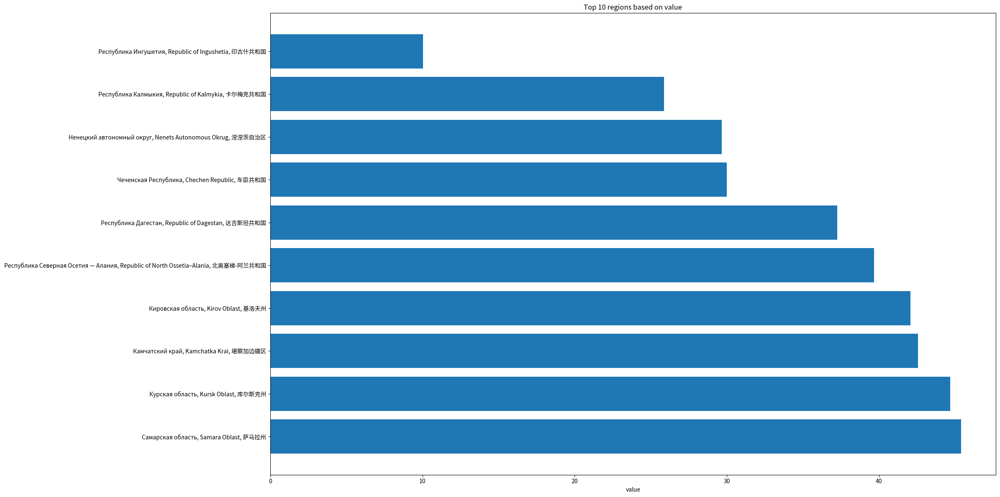

In [26]:
syv.plot_regions_barcharts(df=secondary_exposure,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="secondary_exposure")

Let's make a chart of the top 10 regions where sellers of primary real estate are willing to give the biggest discounts from the asking price.

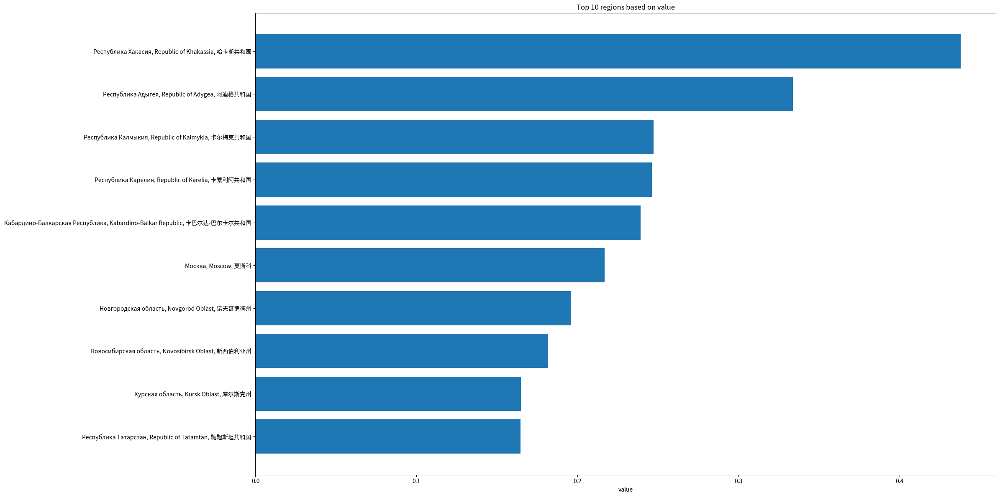

In [27]:
syv.plot_regions_barcharts(df=primary_discounts,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="primary_discounts")

Let's make a chart of the top 10 regions where sellers of secondary real estate are willing to give the biggest discounts from the asking price.

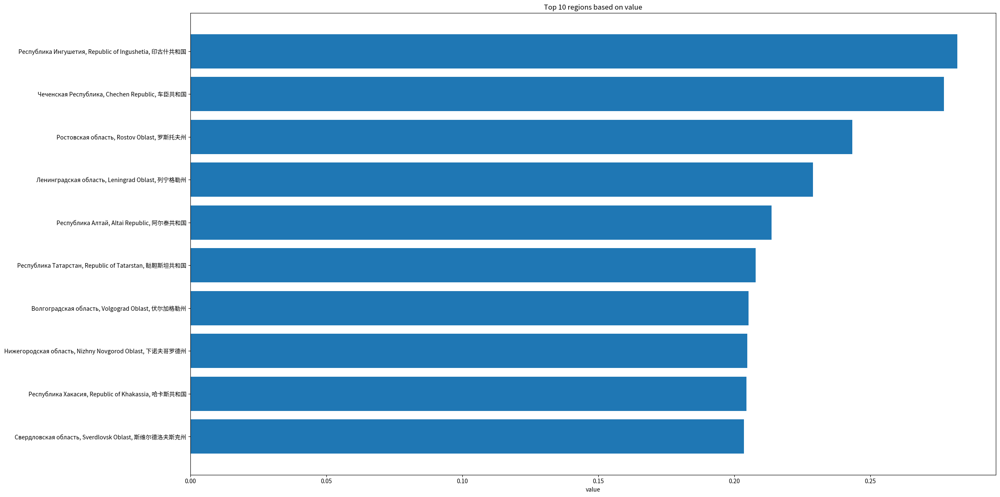

In [28]:
syv.plot_regions_barcharts(df=secondary_discounts,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="secondary_discounts")

Let's create a chart of the top 10 regions with the highest ratio of primary market transaction prices to secondary market transaction prices.

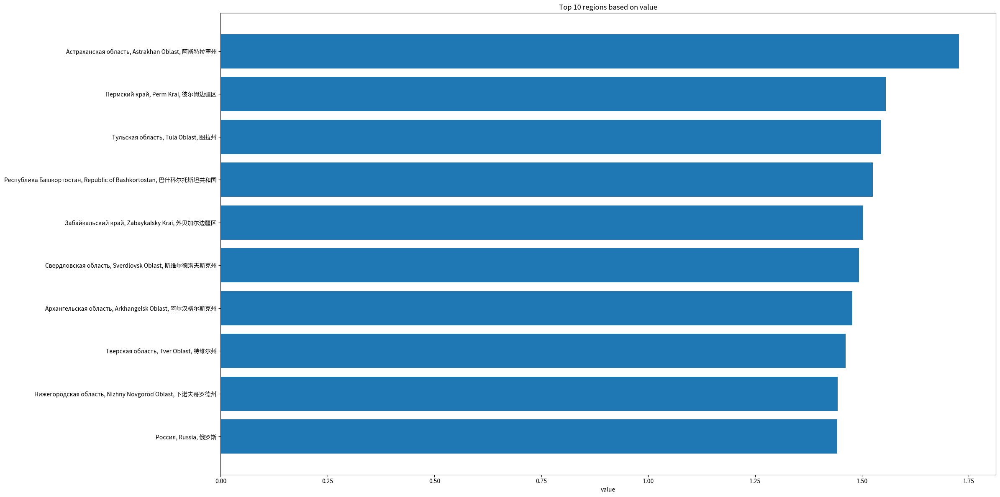

In [29]:
syv.plot_regions_barcharts(df=deals_ratios,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="deals_ratios")

Let's create a chart of the top 10 regions with the lowest ratio of primary market transaction prices to secondary market transaction prices.

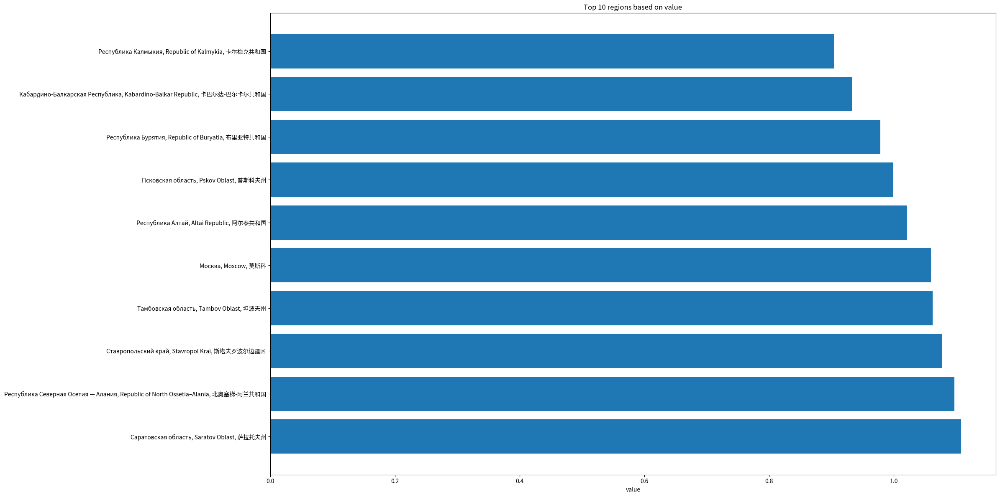

In [30]:
syv.plot_regions_barcharts(df=deals_ratios,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="deals_ratios")

Let's create a chart of the top 10 regions with the highest ratio of primary market asking prices to secondary market asking prices.

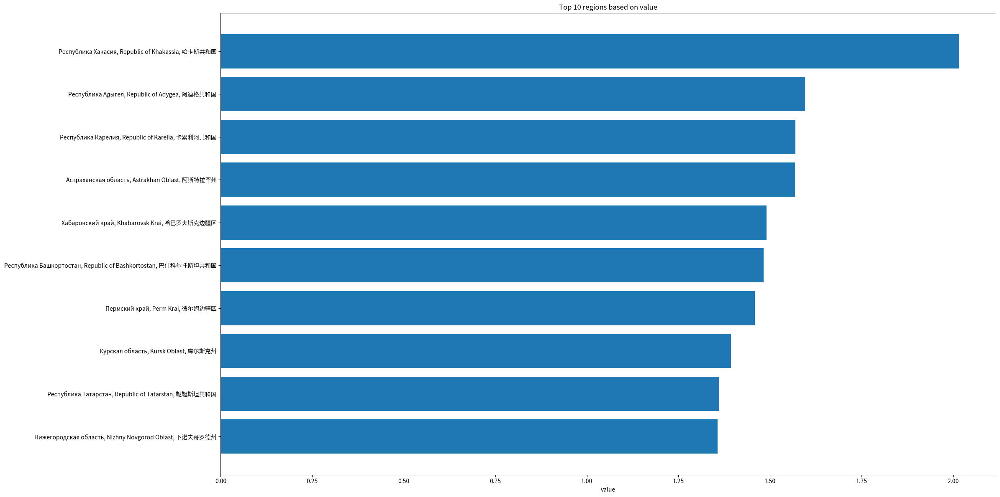

In [31]:
syv.plot_regions_barcharts(df=offers_ratios,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="offers_ratios")

Let's create a chart of the top 10 regions with the lowest ratio of primary market asking prices to secondary market asking prices.

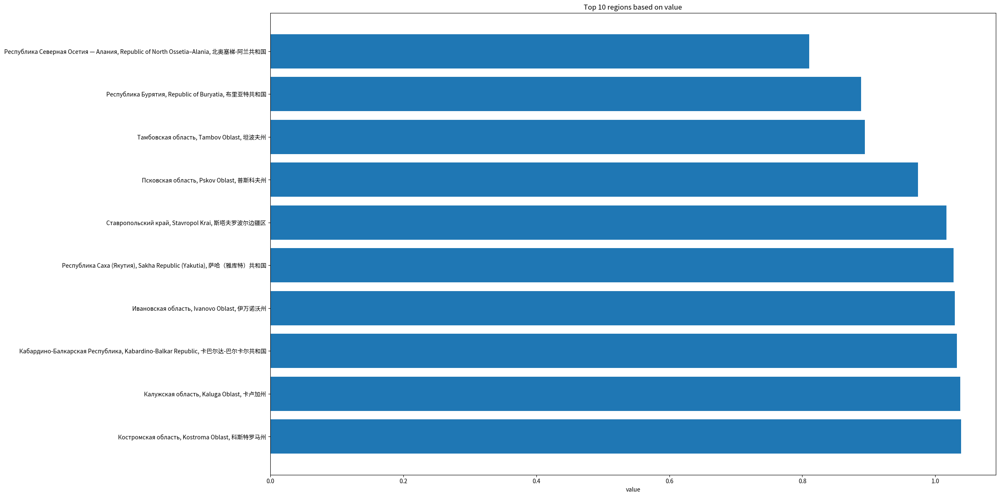

In [32]:
syv.plot_regions_barcharts(df=offers_ratios,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="offers_ratios")

Let's create a chart of the top 10 regions with the highest ratio of primary market listings to secondary market listings.

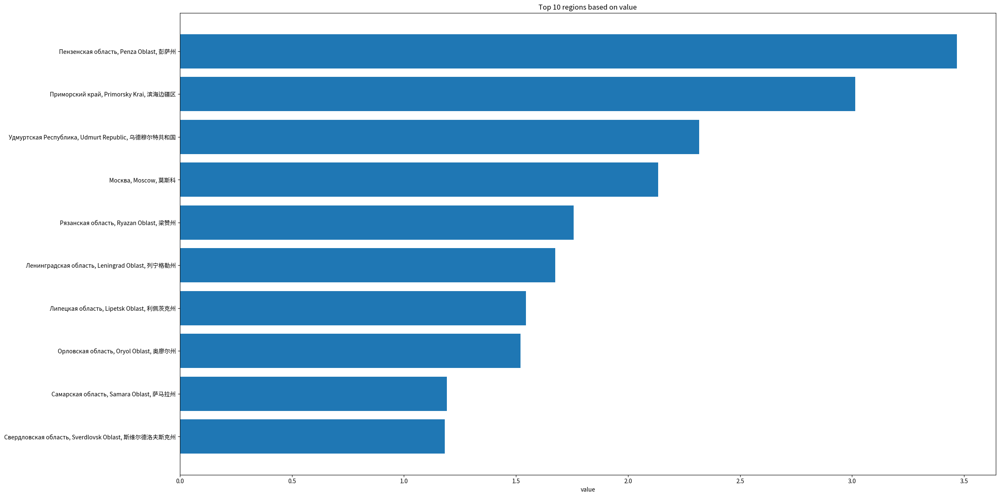

In [33]:
syv.plot_regions_barcharts(df=volumes_ratios,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="volumes_ratios")

Let's create a chart of the top 10 regions with the lowest ratio of primary market listings to secondary market listings.

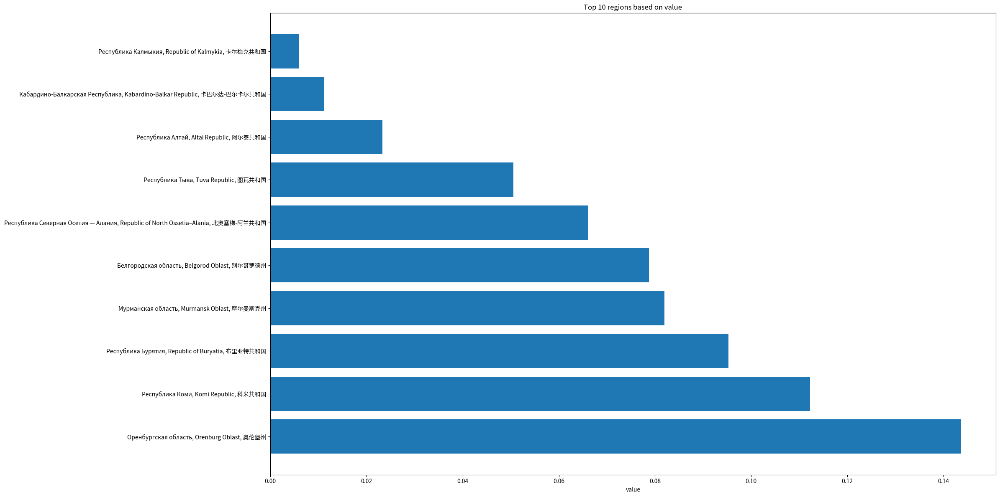

In [34]:
syv.plot_regions_barcharts(df=volumes_ratios,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="volumes_ratios")

### 2.3 Problems of Regional Inequality

To analyze the inequality of regions, we plot the kernel density estimator (these plots are an improved, more modern version of a histogram) and calculate the values of the Gini coefficient for various market indicators. The application of the Gini coefficient to the real estate market is discussed in [this material](https://nbviewer.org/github/Kirill-Murashev/gini_coef_in_valuation/blob/master/gini_coef_en.ipynb).

#### 2.3.1 Kernel density plot creating

Let's draw a diagram of the kernel density estimation of the distribution of transaction prices of the primary markets of the regions. Blue line and shaded area below it &mdash; empirical values of the kernel density estimation; red vertical dashed line &mdash; values of the indicator for Russia as a whole; red curve &mdash; theoretical curve of the normal distribution constructed on the basis of the value for Russia as the mean and empirical standard deviation calculated on the basis of data by regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


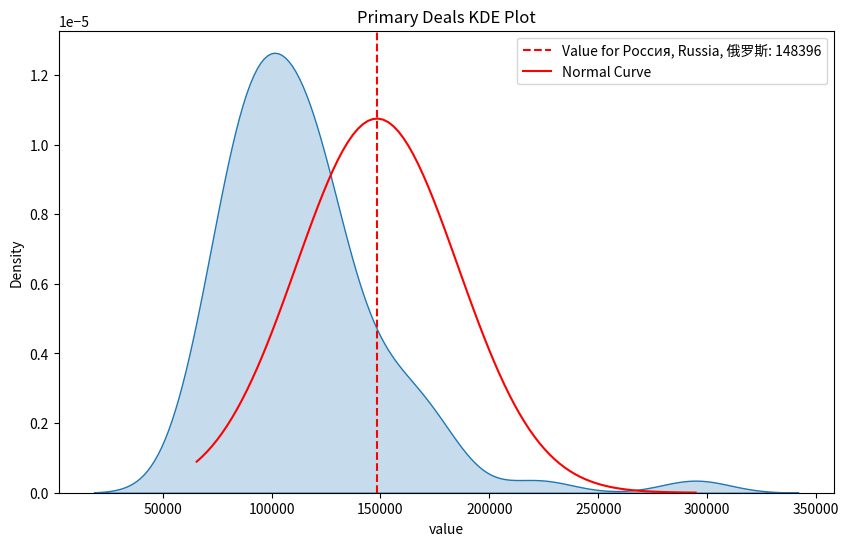

In [35]:
syv.plot_kde_single_column(df=primary_deals,\
                           title="Primary Deals KDE Plot")

Let's plot the kernel density estimate of the supply-price distribution density of the primary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


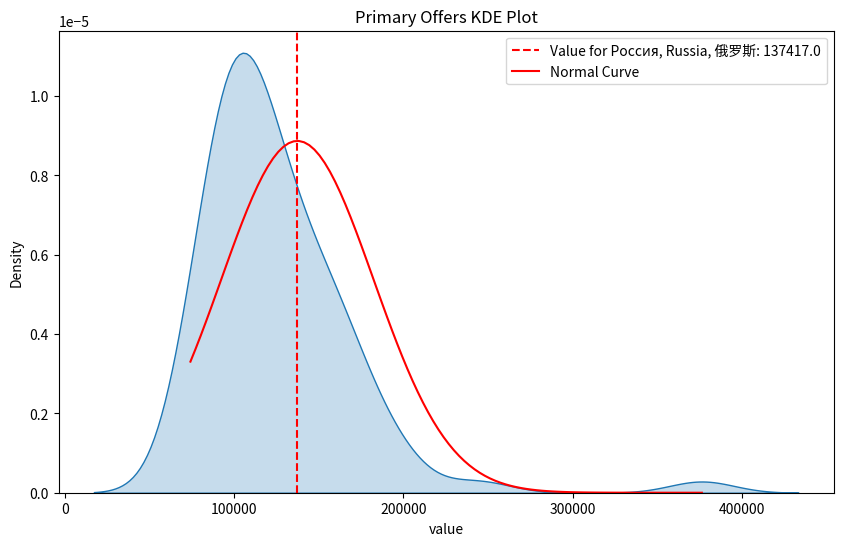

In [36]:
syv.plot_kde_single_column(df=primary_offers,\
                           title="Primary Offers KDE Plot")

Let's draw a diagram of the kernel density estimation of the distribution of transaction prices of the secondary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


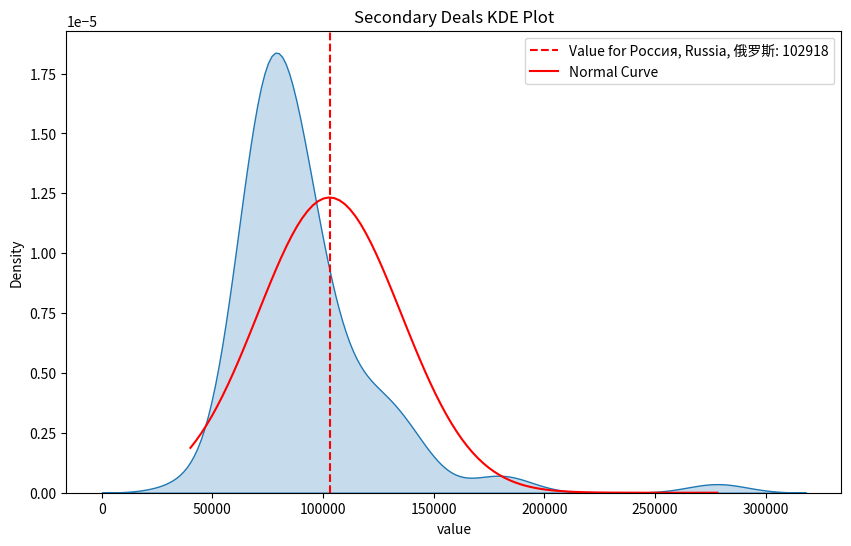

In [37]:
syv.plot_kde_single_column(df=secondary_deals,\
                           title="Secondary Deals KDE Plot")

Let's plot the kernel density estimate of the supply-price distribution density of the secondary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


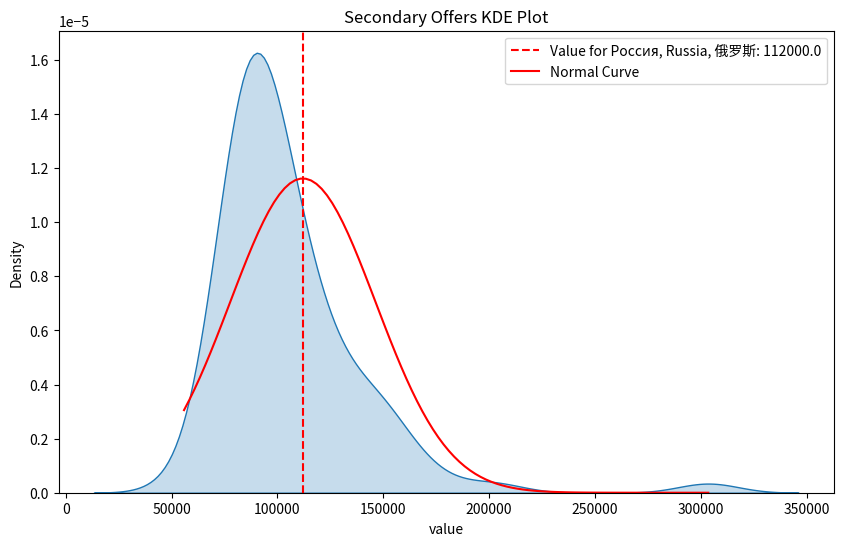

In [38]:
syv.plot_kde_single_column(df=secondary_offers,\
                           title="Secondary Offers KDE Plot")

Let us plot the kernel density estimation of the supply volume distribution density of the primary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


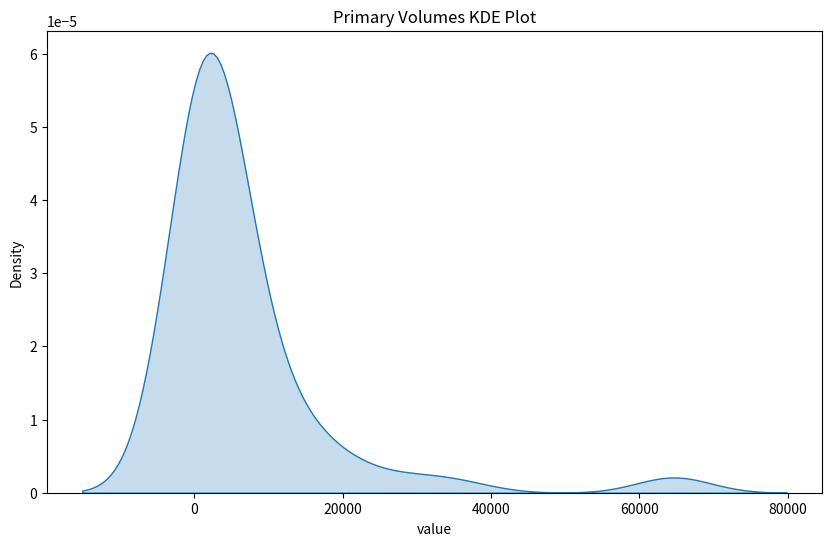

In [39]:
syv.plot_kde_single_column(df=primary_volumes,\
                           title="Primary Volumes KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Let us plot the kernel density estimation of the supply volume distribution density of the secondary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


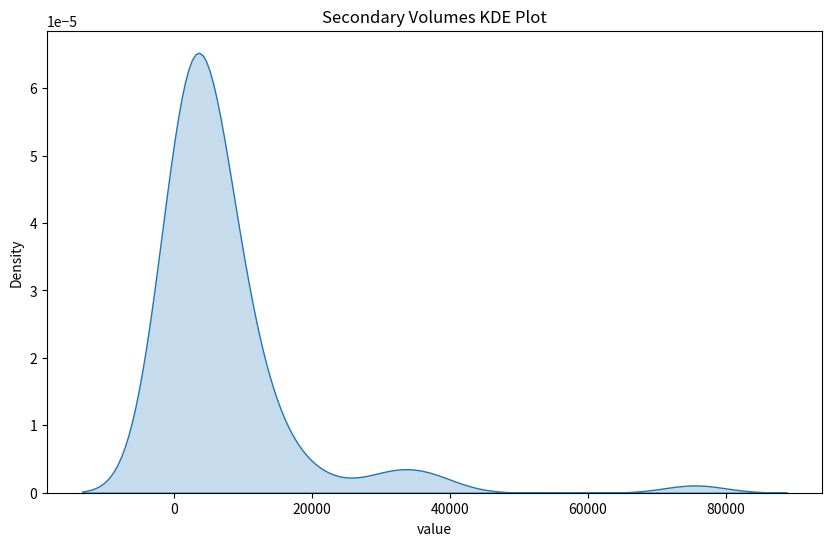

In [40]:
syv.plot_kde_single_column(df=secondary_volumes,\
                           title="Secondary Volumes KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Let's build a kernel plot to estimate the density distribution of exposure terms in the secondary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


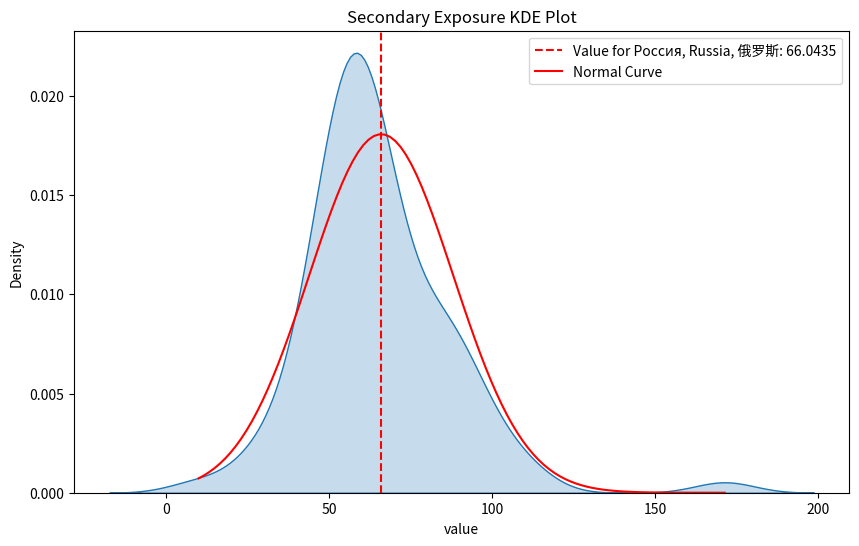

In [41]:
syv.plot_kde_single_column(df=secondary_exposure,\
                           title="Secondary Exposure KDE Plot")

Let's construct the graph of the kernel estimation of the density distribution of discounts at the transition from offer prices to transaction prices on the primary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


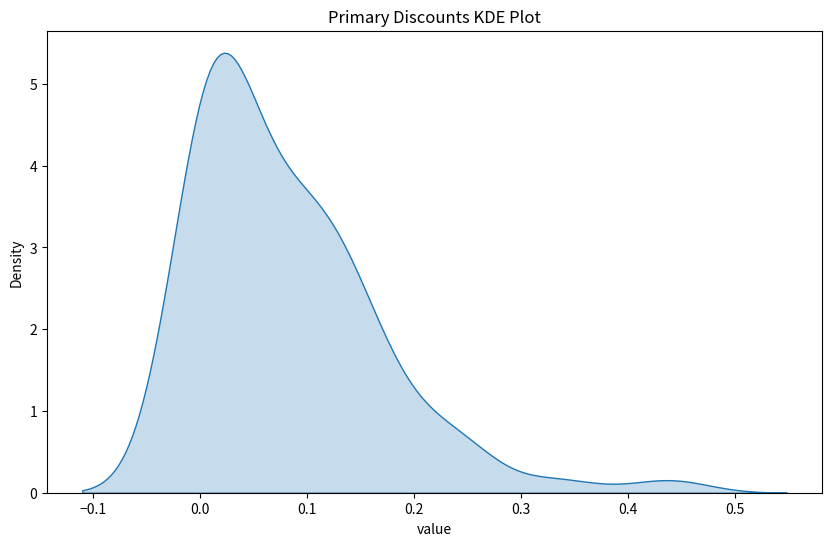

In [42]:
syv.plot_kde_single_column(df=primary_discounts,\
                           title="Primary Discounts KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Let's construct the graph of the kernel estimation of the density distribution of discounts at the transition from offer prices to transaction prices on the secondary markets of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


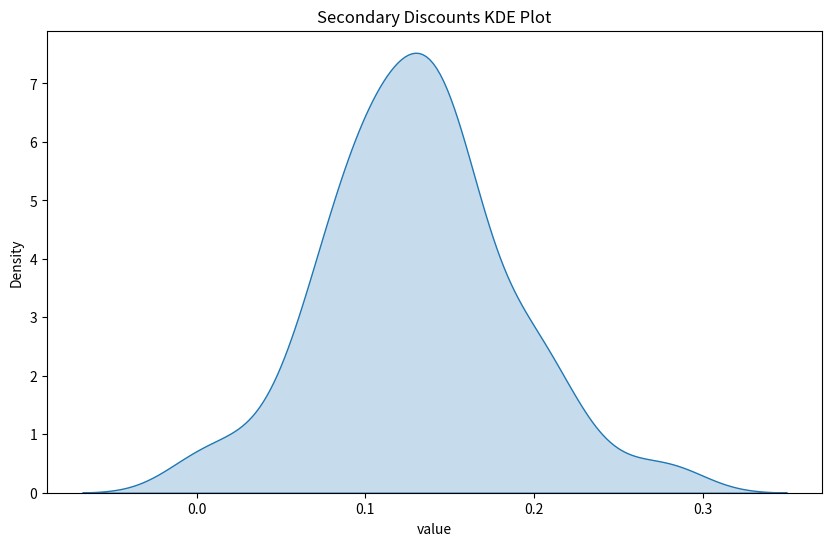

In [43]:
syv.plot_kde_single_column(df=secondary_discounts,\
                           title="Secondary Discounts KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Let us plot the kernel density estimate of the ratio of the mean primary transaction prices to the mean secondary market prices of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


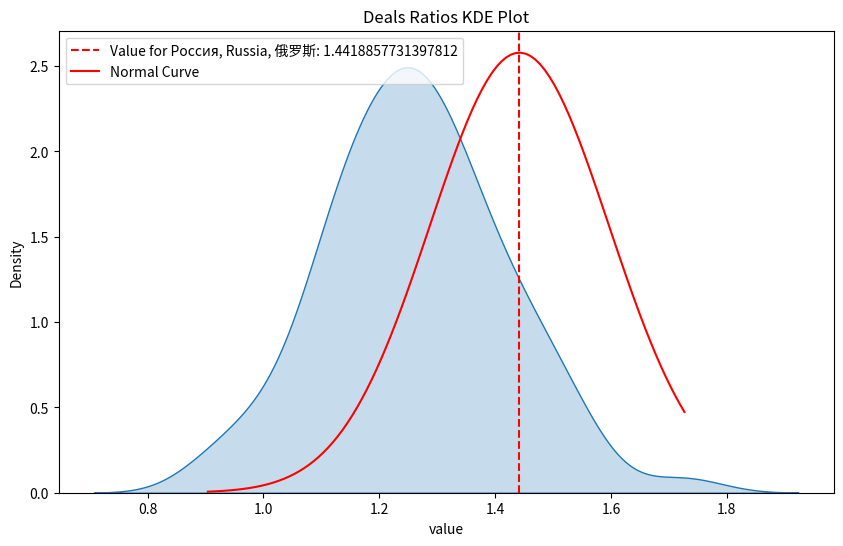

In [44]:
syv.plot_kde_single_column(df=deals_ratios,\
                           title="Deals Ratios KDE Plot")

Let us plot the kernel density estimate of the ratio of the median primary bid prices to the median secondary bid prices of the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


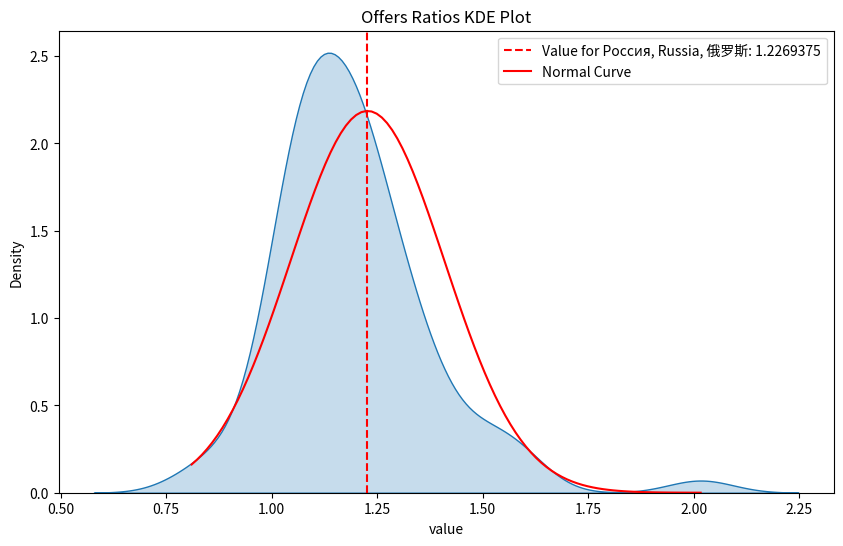

In [45]:
syv.plot_kde_single_column(df=offers_ratios,\
                           title="Offers Ratios KDE Plot")

Let's plot the kernel density estimate of the ratio of primary to secondary market supply in the regions.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


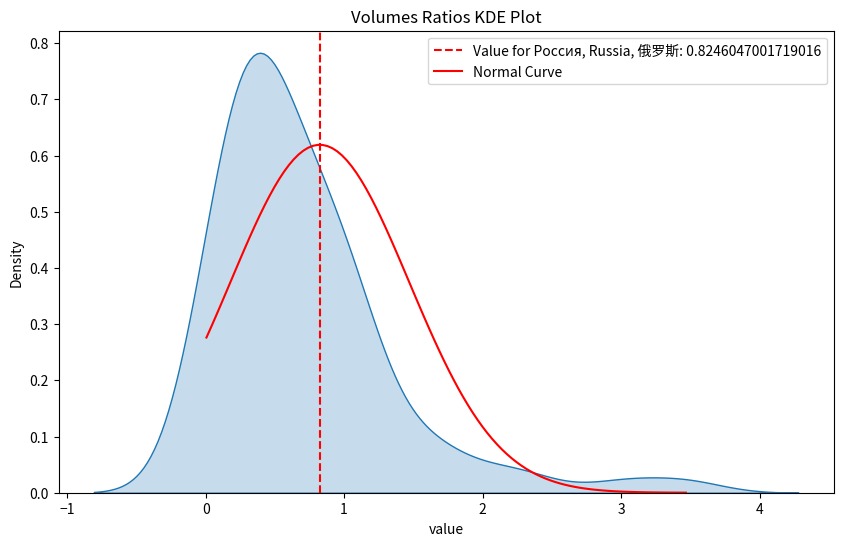

In [46]:
syv.plot_kde_single_column(df=volumes_ratios,\
                           title="Volumes Ratios KDE Plot")

#### 2.3.2 Calculating the Gini Coefficient

Let's calculate Gini coefficient values for actual and standardized values. 

In [47]:
gini_df = syv.calculate_gini_coefficients(
    [primary_deals, primary_offers, secondary_deals, secondary_offers,
     primary_volumes, secondary_volumes],
    names=['primary_deals', 'primary_offers', 'secondary_deals', 'secondary_offers',
           'primary_volumes', 'secondary_volumes']
)

gini_df


,data_frame,gini_value,gini_standardized_value
0,primary_deals,0.161416,0.377056
1,primary_offers,0.170702,0.418197
2,secondary_deals,0.158656,0.281014
3,secondary_offers,0.151551,0.322416
4,primary_volumes,0.689320,0.689133
5,secondary_volumes,0.577668,0.580856


## 3 Clustering

Clustering was performed using hierarchical cluster analysis. Euclidean distance between objects and Ward's distance between clusters were used. We perform clustering based on standardized values of four price and two volume market indicators. Clustering was performed only for regions with values in all of the above six columns. 

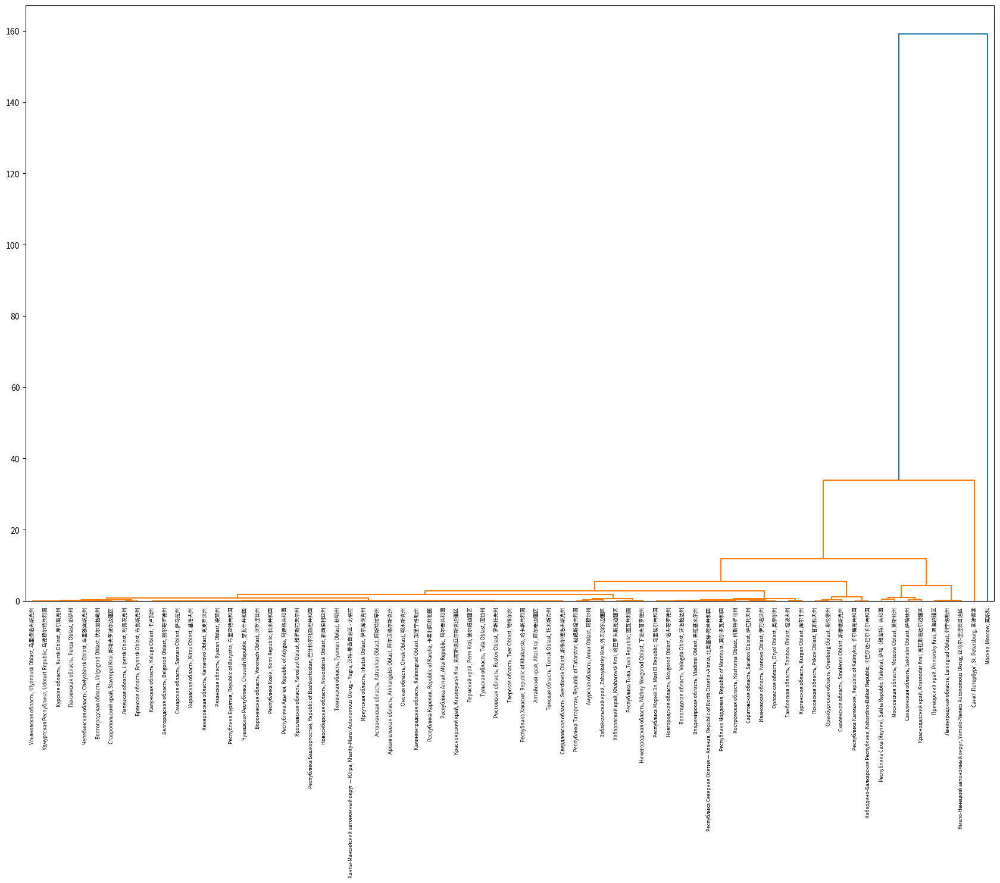

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_agglomerative.py:1006: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


,region,cluster_label
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",2
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0
2,"Москва, Moscow, 莫斯科",3
3,"Московская область, Moscow Oblast, 莫斯科州",0
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",1
6,"Амурская область, Amur Oblast, 阿穆尔州",1
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",1
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",1


In [48]:
# List of data frames to be used in clustering
data_frames_to_cluster = [primary_deals, primary_offers, secondary_deals,
                          secondary_offers, primary_volumes, secondary_volumes]

# Columns to be used in clustering
columns_to_cluster = ['standardized_value']

# Number of clusters
num_clusters = 5

# Affinity
affinity_type = 'euclidean'

# Linkage method
linkage_method = 'ward'

# Calling the hierarchical_clustering function
clustered_data_hier = syv.hierarchical_clustering(data_frames=data_frames_to_cluster, 
                                        columns=columns_to_cluster, 
                                        n_clusters=num_clusters, 
                                        affinity=affinity_type, 
                                        linkage_method=linkage_method)

# Displaying the resulting DataFrame with cluster labels
clustered_data_hier


The clustering results can be interpreted in the following ways, among others

|||
| :- | :- |
|Cluster number|Description|
|3|This cluster includes a single region &mdash; the city of Moscow, which is a [Global Alpha City](https://en.wikipedia.org/wiki/Global_city) and has an exceptionally high residential real estate market performance|
|2|This cluster includes a single region &mdash; the city of St. Petersburg, which is a [Global Beta City](https://en.wikipedia.org/wiki/Globalization_and_World_Cities_Research_Network) and also has a high residential real estate market development, as well as living standards and people's well-being|
|0|This cluster includes both prosperous regions with a high standard of living (for example, the Leningrad region and the Krasnodar region) and regions with a "northern" level of nominal wages. Such wages increase nominal prices without any real maintenance of the quality of life (e.g. Zabaikalsky Krai and Yakutia)|
|1|This cluster contains the majority of regions with an average level of real estate market development|
|4|This cluster includes regions with relatively low levels of real estate market development and quality of life|
|No number|The remaining regions are characterized by a relatively small number of real estate objects, making it impossible to assign them to any of the clusters|

It should be noted that the numbering of clusters in itself does not have a meaningful interpretation and is of a technical nature associated with the moment of the first unification of regions in the cluster.

## 4 Geo-analysis

Create heat maps of various indicators by region. High-resolution versions of the maps, as well as interactive, scalable maps, are available at the links above. A total of 13 heat maps are created. Price indicators are expressed in nominal rubles.

|Indicator|Name of the map and the corresponding file in the [catalog](https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg)|
| :- | :- |
|Mean primary market transaction price|Primary Deals|
|Mean secondary market transaction price|Secondary Deals|
|Median primary market bid price|Primary Offers|
|Median secondary market bid price|Secondary Offers|
|Supply volume on the primary market|Primary Volumes|
|Supply volume on the secondary market|Secondary Volumes|
|Mean duration of housing exposure on the secondary market|Secondary Exposure|
|Typical discount in the transition from bid price to transaction price in the primary market|Primary Discounts|
|Typical discount in the transition from bid price to transaction price in the secondary market|Secondary Discounts|
|Ratio of mean transaction prices in the primary market to the same indicator in the secondary market|Deals Ratios|
|Ratio of median bid prices in the primary market to the same indicator in the secondary market|Offers Ratios|
|Ratio of supply volume in the primary market to the same indicator in the secondary market|Volumes Ratios|
|Ratio of the typical discount at the transition from offer price to transaction price in the primary market to the similar indicator in the secondary market|Discounts Ratios|


### 4.1 Static maps

We get GeoJSON with coordinates of boundaries and polygons of regions.

In [49]:
# Load the default GeoJSON data
gdf = syv.get_rf_geojson()
# Keeping only the 'name' and 'geometry' columns
gdf = gdf[['name', 'geometry']]
# Unify column names
gdf.rename(columns={'name': 'region'}, inplace=True)


Data integrity check.

In [50]:
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure,\
primary_discounts, secondary_discounts, deals_ratios,\
offers_ratios, volumes_ratios, discounts_ratios = syv.check_consistency(
    primary_deals, 
    secondary_deals, 
    primary_offers, 
    secondary_offers,
    primary_volumes,
    secondary_volumes,
    secondary_exposure,
    primary_discounts,
    secondary_discounts,
    deals_ratios,
    offers_ratios,
    volumes_ratios,
    discounts_ratios
)

Find and correct mismatches in region names between Sberindex and GeoJSON databases.

In [51]:
# Harmonize regions names
geojson_regions = syv.get_all_regions_from_geojson(gdf)
gdf = syv.harmonize_geojson_names(gdf)
primary_deals = syv.harmonize_sql_names(primary_deals)
secondary_deals = syv.harmonize_sql_names(secondary_deals)
primary_offers = syv.harmonize_sql_names(primary_offers)
secondary_offers = syv.harmonize_sql_names(secondary_offers)
primary_volumes = syv.harmonize_sql_names(primary_volumes)
secondary_volumes = syv.harmonize_sql_names(secondary_volumes)
secondary_exposure = syv.harmonize_sql_names(secondary_exposure)
primary_discounts = syv.harmonize_sql_names(primary_discounts)
secondary_discounts = syv.harmonize_sql_names(secondary_discounts)
deals_ratios = syv.harmonize_sql_names(deals_ratios)
offers_ratios = syv.harmonize_sql_names(offers_ratios)
volumes_ratios = syv.harmonize_sql_names(volumes_ratios)
discounts_ratios = syv.harmonize_sql_names(discounts_ratios)

# Create object
sberindex_regions = syv.get_all_regions_from_sql(primary_deals,\
                                                 secondary_deals,\
                                                 primary_offers,\
                                                 secondary_offers,\
                                                 primary_volumes,\
                                                 secondary_volumes,\
                                                 secondary_exposure,\
                                                 primary_discounts,\
                                                 secondary_discounts,\
                                                 deals_ratios,\
                                                 offers_ratios,\
                                                 volumes_ratios,\
                                                 discounts_ratios
                                                )

# Remove redundant regions
gdf = syv.remove_redundant_from_geojson(gdf)

# Create list of regions from GeoJSON
geojson_regions = syv.get_all_regions_from_geojson(gdf)

# Recreate object
sberindex_regions = syv.get_all_regions_from_sql(primary_deals,\
                                                 secondary_deals,\
                                                 primary_offers,\
                                                 secondary_offers,\
                                                 primary_volumes,\
                                                 secondary_volumes,\
                                                 secondary_exposure,\
                                                 primary_discounts,\
                                                 secondary_discounts,\
                                                 deals_ratios,\
                                                 offers_ratios,\
                                                 volumes_ratios,\
                                                 discounts_ratios
                                                )

Let's compare the lists of regions in Sberindex and in GeoJSON.

In [52]:
mismatches_sql_geojson, mismatches_geojson_sql = syv.find_region_mismatches(sberindex_regions, geojson_regions)

print("Regions in data frames but not in GeoJSON:", mismatches_sql_geojson)
print("Regions in GeoJSON but not in data frames:", mismatches_geojson_sql)

Regions in data frames but not in GeoJSON: ['Россия, Russia, 俄罗斯']
Regions in GeoJSON but not in data frames: []


Let's define the list of maps for plotting.

In [53]:
# Add to datasets
datasets_plt = [
    (primary_deals, 'value', 'Primary Deals', 'primary_deals.png'),
    (secondary_deals, 'value', 'Secondary Deals', 'secondary_deals.png'),
    (primary_offers, 'value', 'Primary Offers', 'primary_offers.png'),
    (secondary_offers, 'value', 'Secondary Offers', 'secondary_offers.png'),
    (primary_volumes, 'value', 'Primary Volume', 'primary_volumes.png'),
    (secondary_volumes, 'value', 'Secondary Volume', 'secondary_volumes.png'),
    (secondary_exposure, 'value', 'Secondary Exposure', 'secondary_exposure.png'),
    (primary_discounts, 'value', 'Primary Discount Rate', 'primary_discount.png'),
    (secondary_discounts, 'value', 'Secondary Discount Rate', 'secondary_discount.png'),
    (deals_ratios, 'value', 'Primary to Secondary Market Deals Ratios', 'deals_ratios.png'),
    (offers_ratios, 'value', 'Primary to Secondary Market Offers Ratios', 'offers_ratios.png'),
    (volumes_ratios, 'value', 'Primary to Secondary Market Volumes Ratios', 'volumes_ratios.png'),
    (discounts_ratios, 'value', 'Primary to Secondary Market Discounts Ratios', 'discounts_ratios.png')
]


Let's adjust the coordinates to create a map with Chukotka partially in the Western Hemisphere.

In [54]:
shifted_gdf = syv.shift_geometry(gdf.copy())

Let's create static heat maps of 13 indicators of the residential real estate market in Russia as of the date of the study. These maps are available as separate files on the [link](https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg).

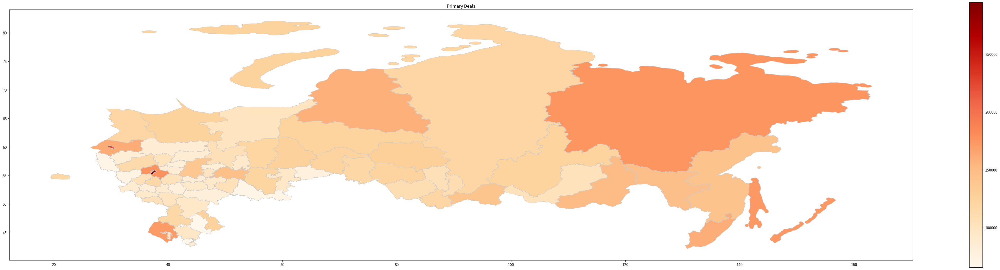

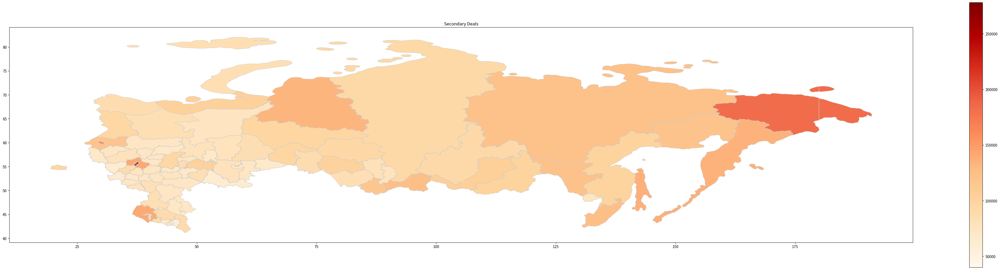

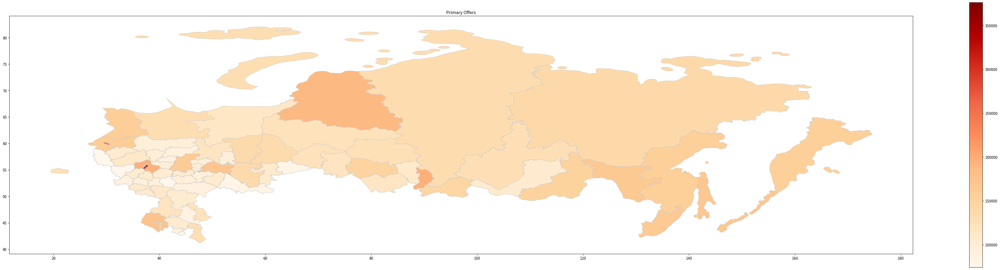

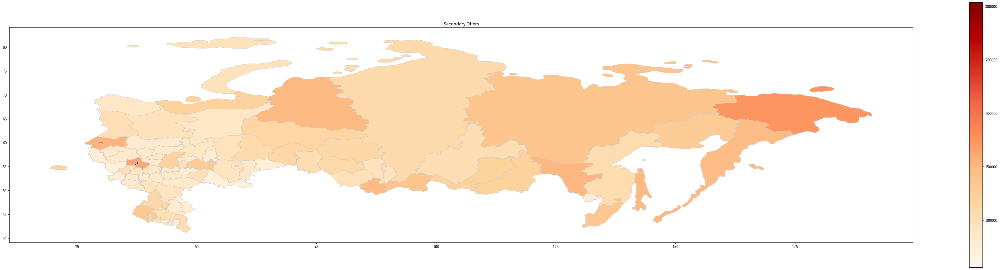

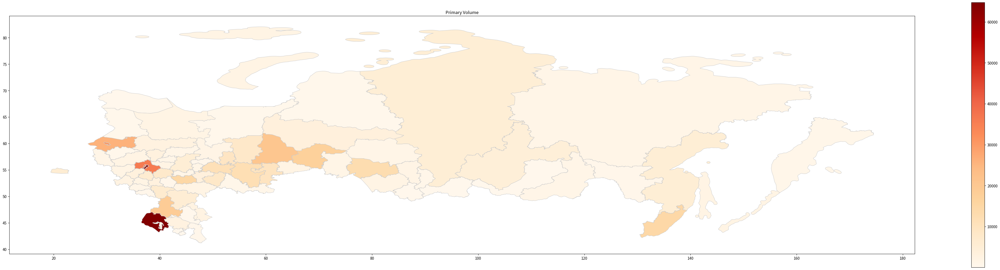

...

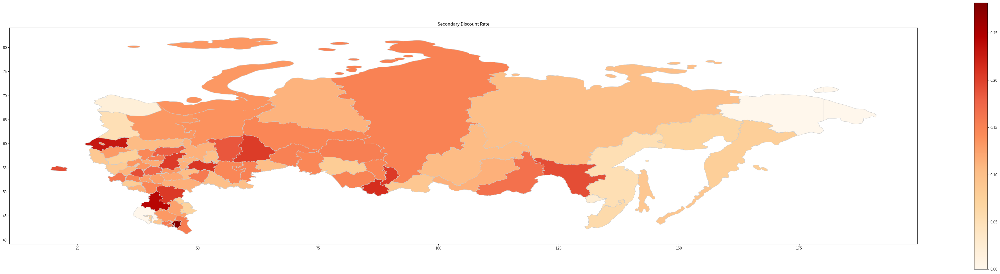

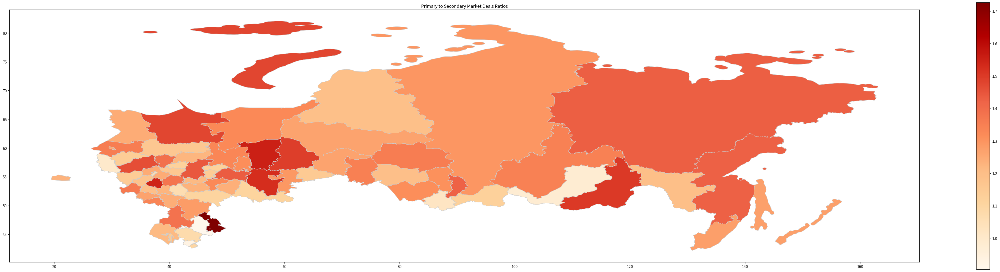

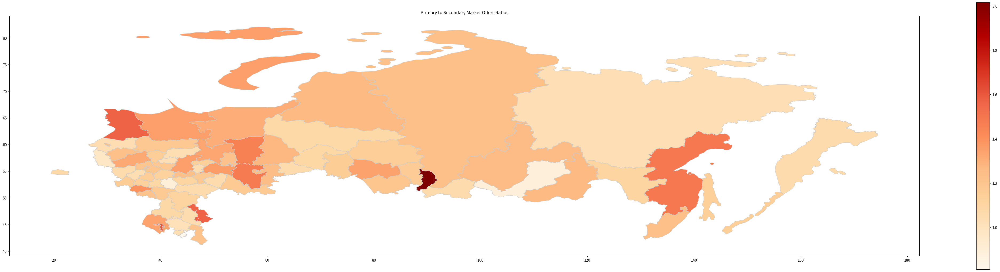

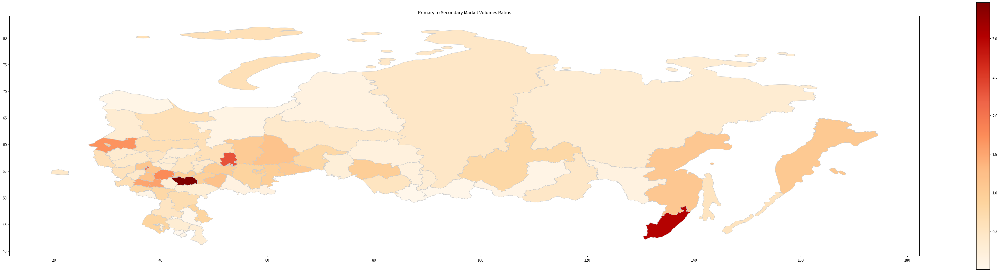

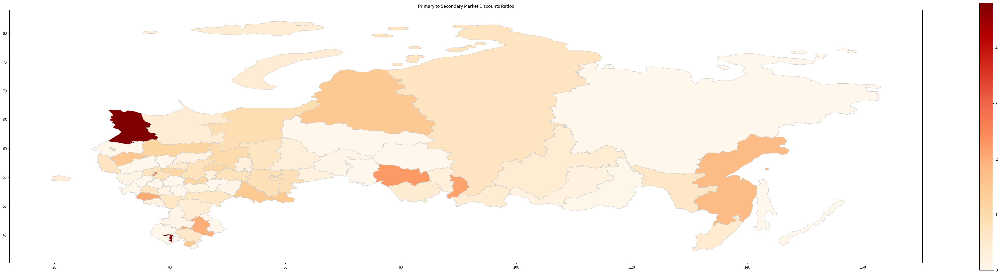

In [55]:
# Looping over each dataset in datasets_plt
for data, column_name, display_name, filename in datasets_plt:
    # Calling the function with the appropriate arguments
    syv.create_and_display_heatmaps_sberindex(data, column_name, display_name, filename, shifted_gdf)


### 4.2 Interactive maps

Let's also plot interactive maps. They are available as html files at [link](https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg).

In [56]:
# Add to datasets
datasets_folium = [
    (primary_deals, 'value', 'Primary Deals', 'primary_deals.png'),
    (secondary_deals, 'value', 'Secondary Deals', 'secondary_deals.png'),
    (primary_offers, 'value', 'Primary Offers', 'primary_offers.png'),
    (secondary_offers, 'value', 'Secondary Offers', 'secondary_offers.png'),
    (primary_volumes, 'value', 'Primary Volume', 'primary_volumes.png'),
    (secondary_volumes, 'value', 'Secondary Volume', 'secondary_volumes.png'),
    (secondary_exposure, 'value', 'Secondary Exposure', 'secondary_exposure.png'),
    (primary_discounts, 'value', 'Primary Discount Rate', 'primary_discount.png'),
    (secondary_discounts, 'value', 'Secondary Discount Rate', 'secondary_discount.png'),
    (deals_ratios, 'value', 'Primary to Secondary Market Deals Ratios', 'deals_ratios.png'),
    (offers_ratios, 'value', 'Primary to Secondary Market Offers Ratios', 'offers_ratios.png'),
    (volumes_ratios, 'value', 'Primary to Secondary Market Volumes Ratios', 'volumes_ratios.png'),
    (discounts_ratios, 'value', 'Primary to Secondary Market Discounts Ratios', 'discounts_ratios.png')
]

In [57]:
for data, column_name, display_name, filename in datasets_folium:
    syv.create_and_save_choropleth_sberindex(data, column_name, display_name, gdf, display_name)


## 5 Time series analysis

### 5.1 Data preparation

Creation of data frames containing data for the whole observation period on the Sberindex side. Integrity check.

In [58]:
# Fetch data for the entire period
primary_deals_ts, secondary_deals_ts, primary_offers_ts,\
secondary_offers_ts, primary_volumes_ts, secondary_volumes_ts,\
secondary_exposure_ts = syv.read_sberindex_flats()

# Check data
primary_deals_ts, secondary_deals_ts, primary_offers_ts,\
secondary_offers_ts, primary_volumes_ts, secondary_volumes_ts,\
secondary_exposure_ts = syv.check_consistency(primary_deals_ts,\
                                              secondary_deals_ts,\
                                              primary_offers_ts,\
                                              secondary_offers_ts,\
                                              primary_volumes_ts,\
                                              secondary_volumes_ts,\
                                              secondary_exposure_ts)


Calculate discounts when moving from bid prices to transaction prices.

In [59]:
primary_discount_rates_ts = syv.calculate_discount_rates_ts(primary_deals_ts, primary_offers_ts, 'primary')
secondary_discount_rates_ts = syv.calculate_discount_rates_ts(secondary_deals_ts, secondary_offers_ts, 'secondary')

Calculate ratios between primary and secondary markets.

In [60]:
deals_ratios_ts = syv.calculate_market_ratios_ts(primary_deals_ts, secondary_deals_ts, 'value')
offers_ratios_ts = syv.calculate_market_ratios_ts(primary_offers_ts, secondary_offers_ts, 'value')
volumes_ratios_ts = syv.calculate_market_ratios_ts(primary_volumes_ts, secondary_volumes_ts, 'value')
discounts_ratios_ts = syv.calculate_market_ratios_ts(primary_discount_rates_ts, secondary_discount_rates_ts, 'value')

Calculate gaps between primary and secondary markets.

In [61]:
deals_gaps_ts = syv.calculate_market_gaps_ts(primary_deals_ts, secondary_deals_ts, 'value')
offers_gaps_ts = syv.calculate_market_gaps_ts(primary_offers_ts, secondary_offers_ts, 'value')
volumes_gaps_ts = syv.calculate_market_gaps_ts(primary_volumes_ts, secondary_volumes_ts, 'value')
discounts_gaps_ts = syv.calculate_market_gaps_ts(primary_discount_rates_ts, secondary_discount_rates_ts, 'value')

Calculate the Gini coefficient for market indicators.

In [62]:
primary_deals_gini_ts, primary_offers_gini_ts, secondary_deals_gini_ts,\
secondary_offers_gini_ts, primary_volumes_gini_ts, secondary_volumes_gini_ts,\
secondary_exposure_gini_ts = syv.calculate_gini_over_time(primary_deals_ts,\
                                                          primary_offers_ts,\
                                                          secondary_deals_ts,\
                                                          secondary_offers_ts,\
                                                          primary_volumes_ts,\
                                                          secondary_volumes_ts,\
                                                          secondary_exposure_ts)

primary_deals_gini_ts, primary_offers_gini_ts, secondary_deals_gini_ts,\
secondary_offers_gini_ts, primary_volumes_gini_ts, secondary_volumes_gini_ts,\
secondary_exposure_gini_ts = syv.sort_dataframe_by_date(primary_deals_gini_ts,\
                                                            primary_offers_gini_ts,\
                                                            secondary_deals_gini_ts,\
                                                            secondary_offers_gini_ts,\
                                                            primary_volumes_gini_ts,\
                                                            secondary_volumes_gini_ts,\
                                                            secondary_exposure_gini_ts)

primary_deals_gini_ts, primary_offers_gini_ts, secondary_deals_gini_ts,\
secondary_offers_gini_ts, primary_volumes_gini_ts, secondary_volumes_gini_ts,\
secondary_exposure_gini_ts = syv.convert_date_to_month_year(primary_deals_gini_ts,\
                                                            primary_offers_gini_ts,\
                                                            secondary_deals_gini_ts,\
                                                            secondary_offers_gini_ts,\
                                                            primary_volumes_gini_ts,\
                                                            secondary_volumes_gini_ts,\
                                                            secondary_exposure_gini_ts)

### 5.2 Analysis of nominal ruble and physical indicators

#### 5.2.1 Nominal ruble prices

Let us chart the dynamics of nominal ruble prices for five key regions: St. Petersburg, Leningrad Oblast, Moscow, Moscow Oblast, Krasnodar Krai.

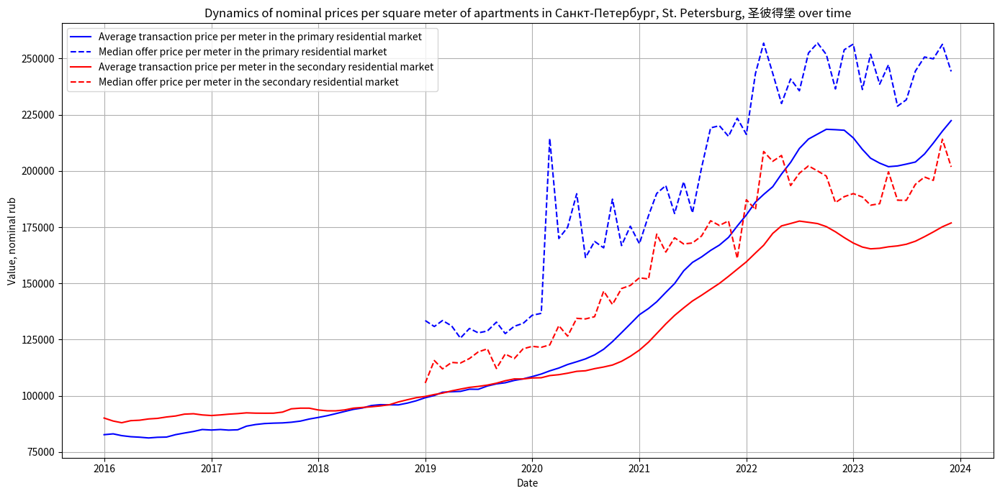

In [63]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Санкт-Петербург, St. Petersburg, 圣彼得堡')

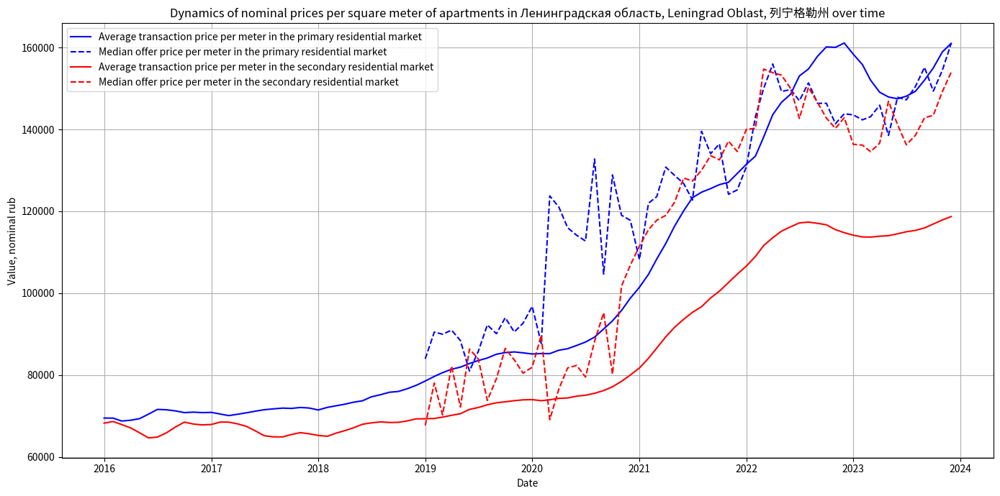

In [64]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Ленинградская область, Leningrad Oblast, 列宁格勒州')

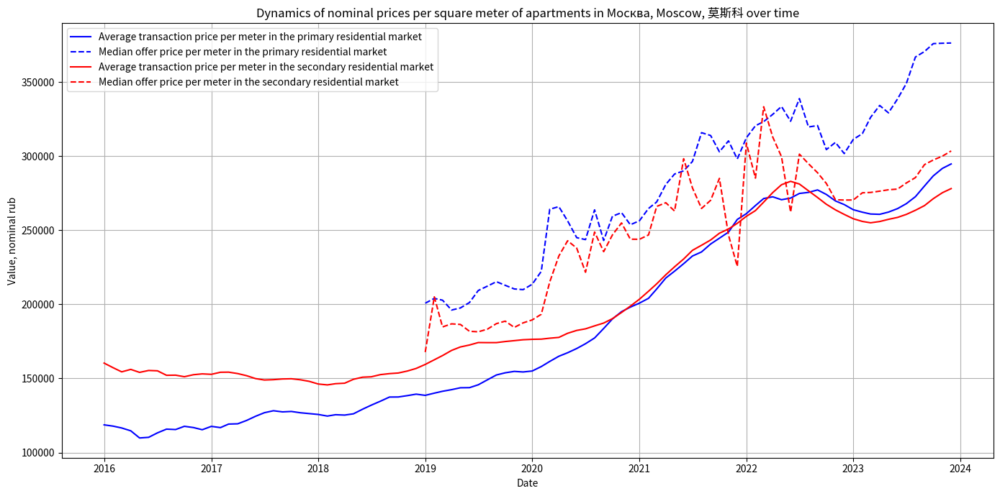

In [65]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Москва, Moscow, 莫斯科')

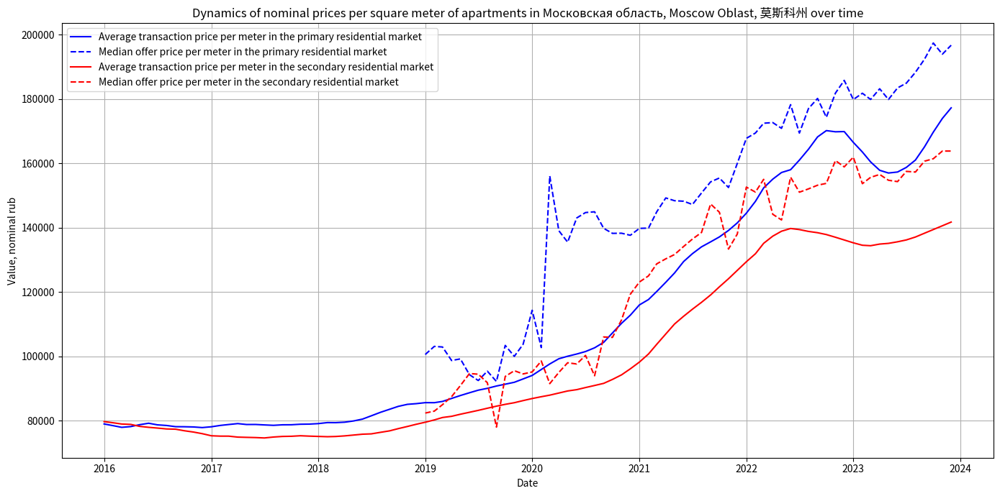

In [66]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Московская область, Moscow Oblast, 莫斯科州')

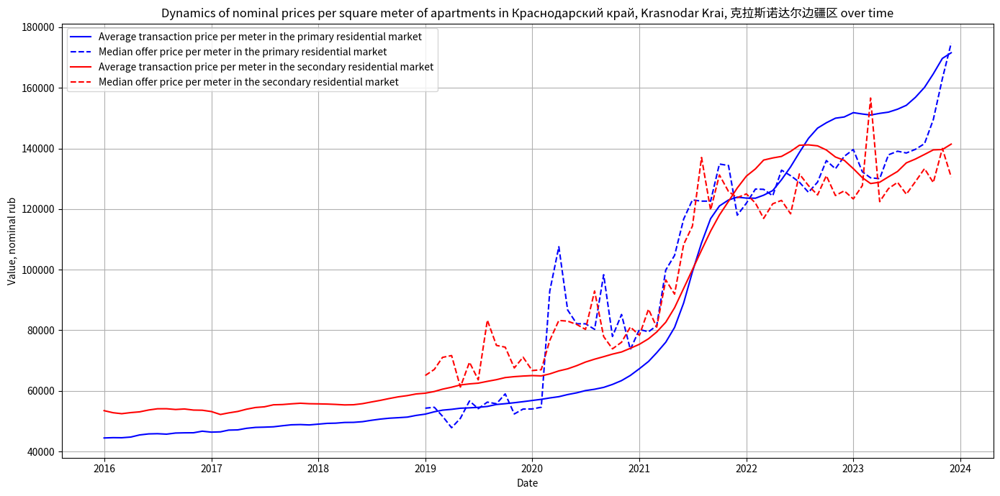

In [67]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [68]:
syv.save_prices_plots(primary_deals_ts, primary_offers_ts,\
                      secondary_deals_ts, secondary_offers_ts,\
                      column_name='value')

#### 5.2.2 Volume in lots

Let's create charts for the dynamics of volume in lots for five key regions: St. Petersburg, Leningrad Oblast, Moscow, Moscow Oblast, Krasnodar Krai.

In [69]:
volume_labels = ['Primary market', 'Secondary market']

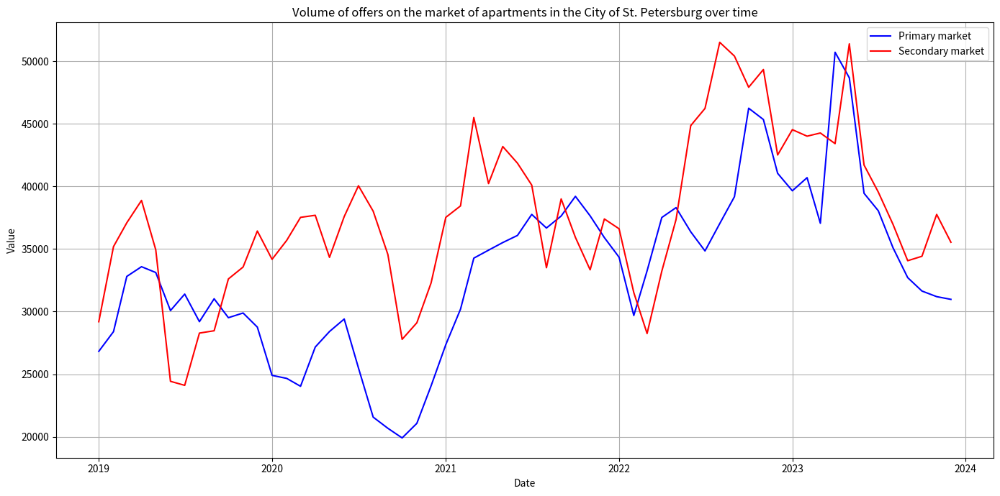

In [70]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in the City of St. Petersburg over time')

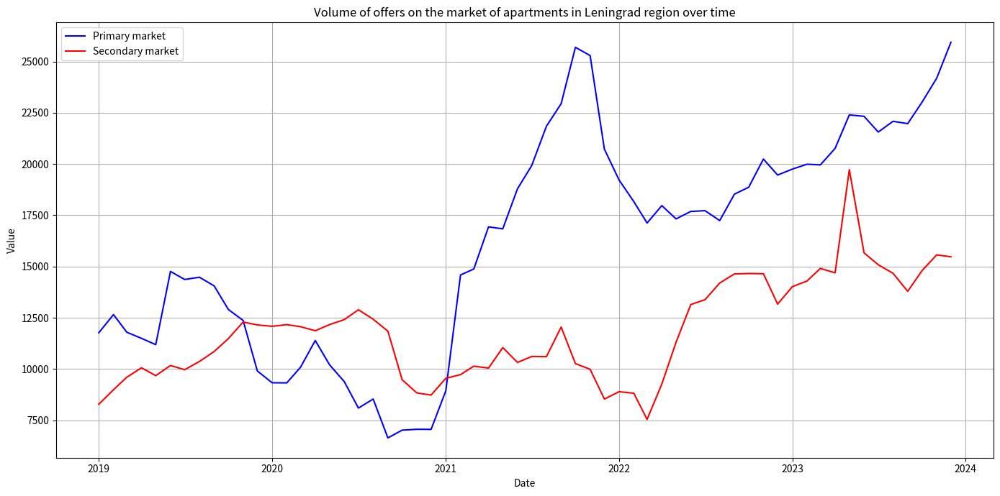

In [71]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in Leningrad region over time')

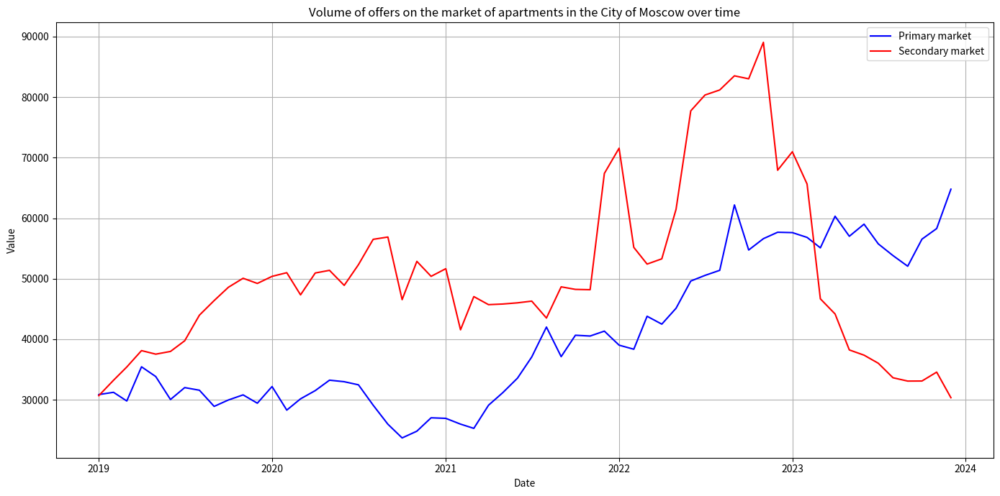

In [72]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in the City of Moscow over time')

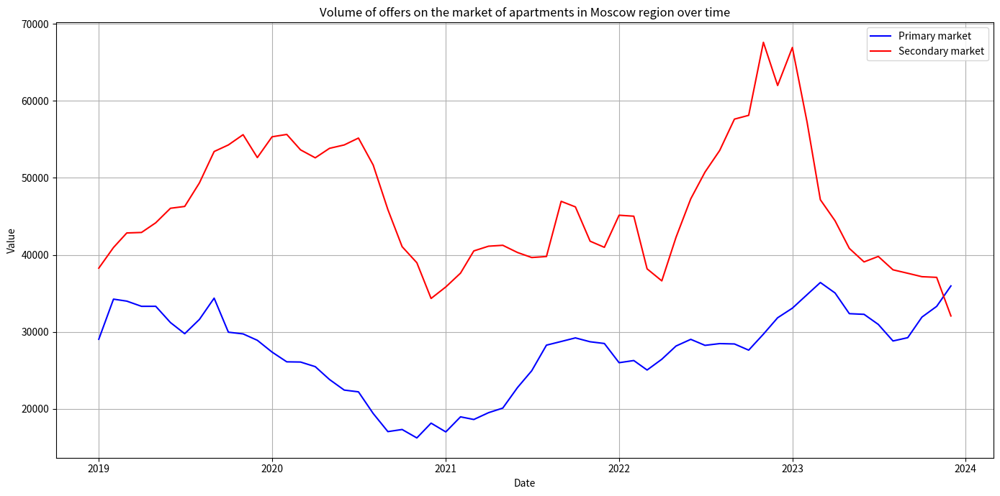

In [73]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in Moscow region over time')

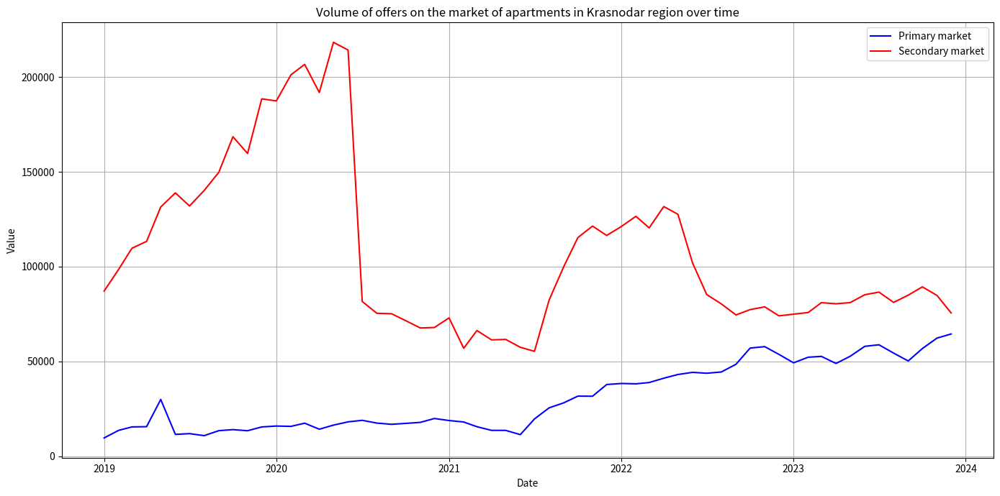

In [74]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in Krasnodar region over time')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [75]:
syv.save_volumes_plots(primary_volumes_ts,\
                       secondary_volumes_ts,\
                       column_name='value')

#### 5.2.3 Exposure periods on secondary markets


Create graphs of the dynamics of exposure times on the secondary market in days for five key regions: St. Petersburg, Leningrad Oblast, Moscow, Moscow Oblast, Krasnodar Krai.

In [76]:
exposure_labels = ['Secondary market']

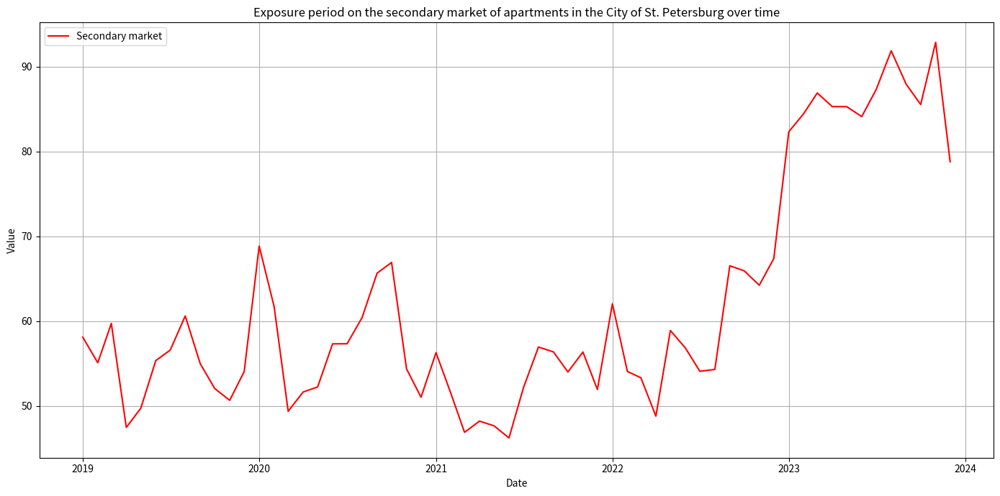

In [77]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in the City of St. Petersburg over time')

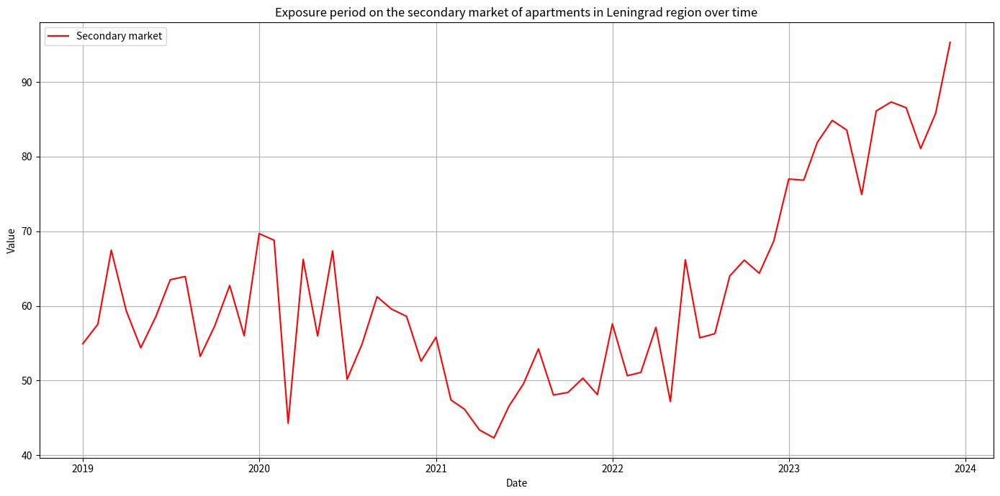

In [78]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in Leningrad region over time')

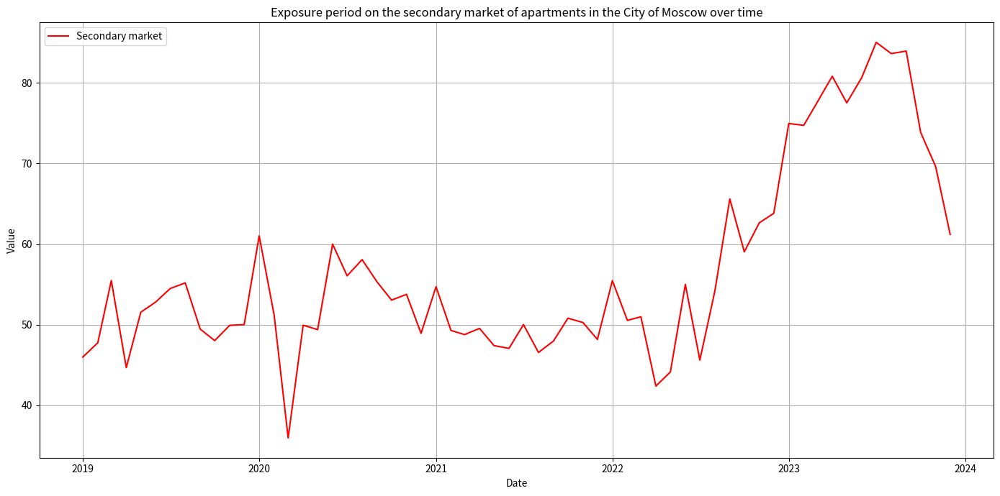

In [79]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in the City of Moscow over time')

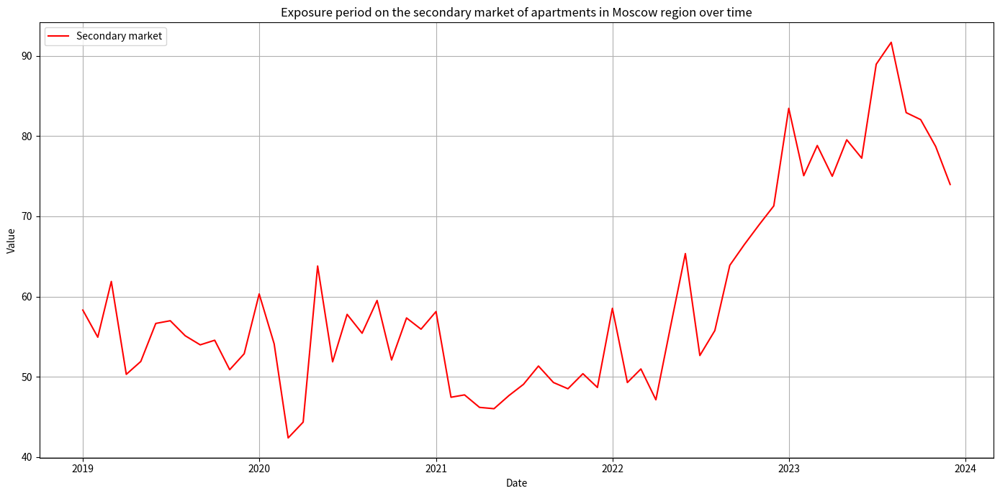

In [80]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in Moscow region over time')

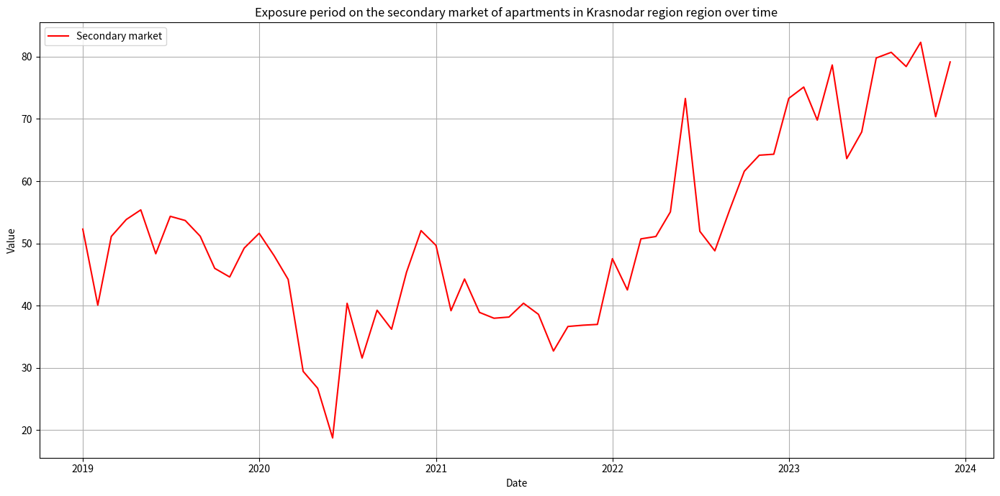

In [81]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',\
                           labels=exposure_labels, colors=['red'],\
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in Krasnodar region region over time')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [82]:
syv.save_exposure_plots(secondary_exposure_ts,\
                       column_name='value')

#### 5.2.4 Discounts when moving from bid prices to transaction prices

Plot charts of the dynamics of discount rates when moving from bid prices to transaction prices for five key regions: St. Petersburg, Leningrad Oblast, Moscow, Moscow Oblast, Krasnodar Krai.

In [83]:
discounts_labels = ['Primary Market',
                   'Secondary market']

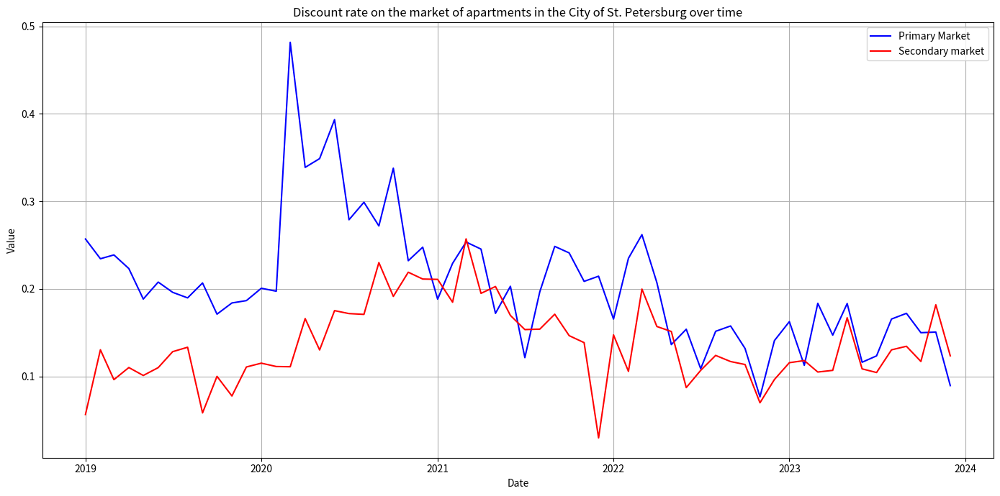

In [84]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in the City of St. Petersburg over time')

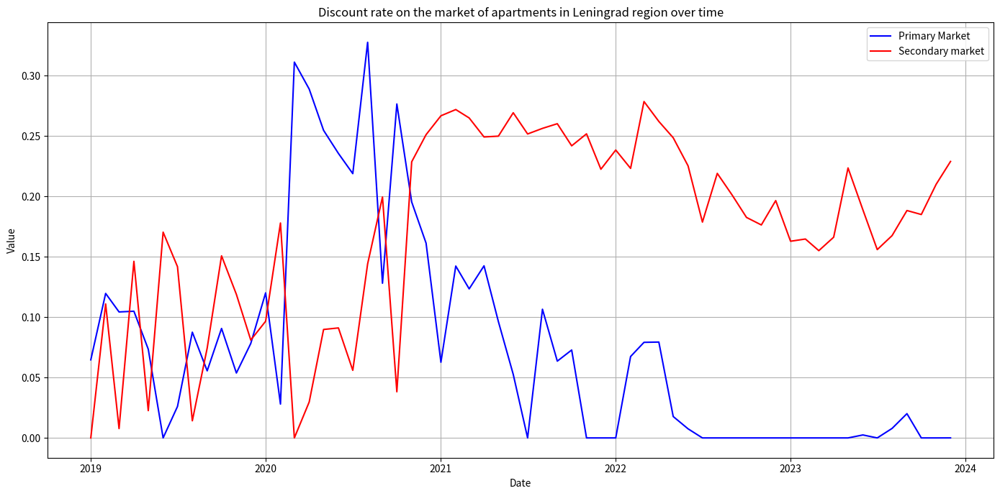

In [85]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',\
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],\
                           title=f'Discount rate on the market of apartments in Leningrad region over time')

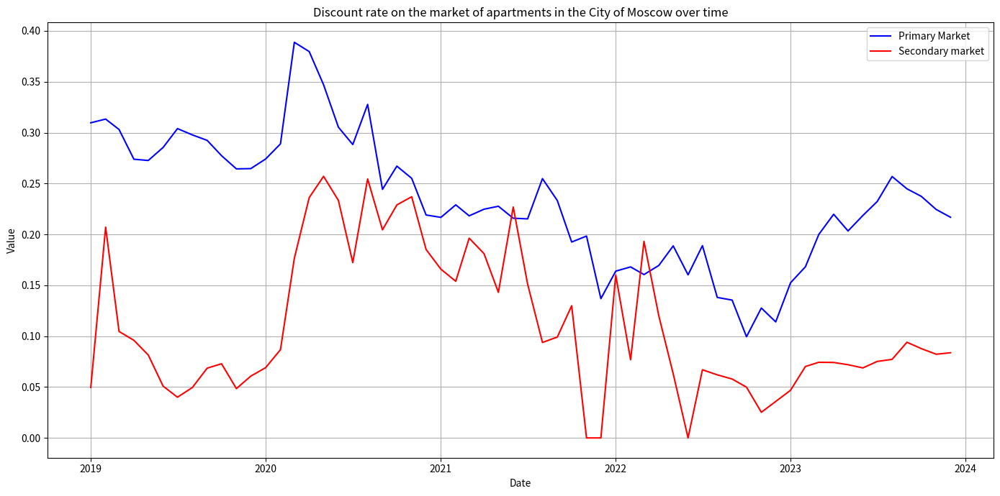

In [86]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in the City of Moscow over time')

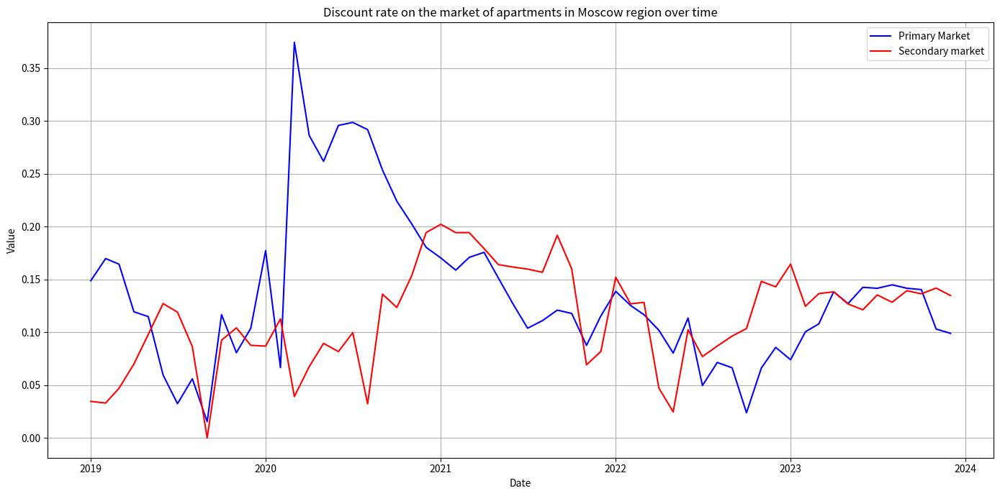

In [87]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in Moscow region over time')

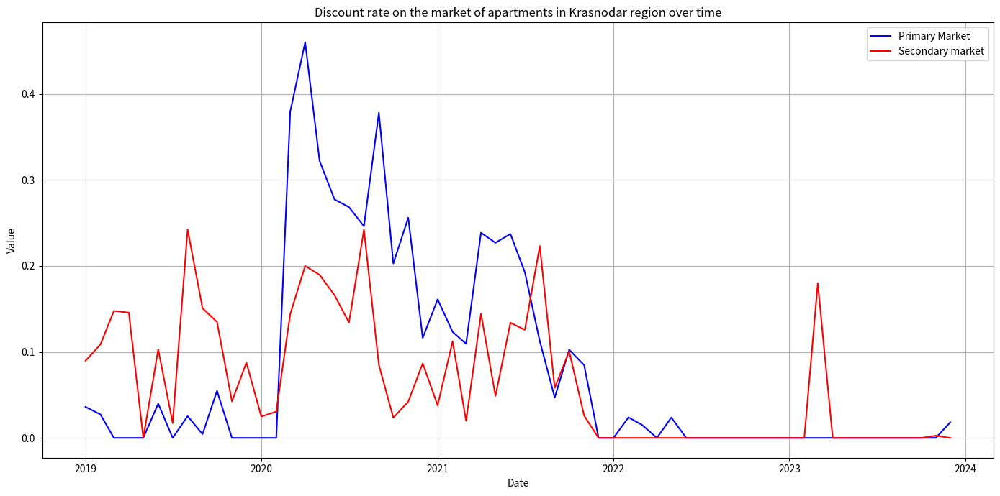

In [88]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in Krasnodar region over time')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [89]:
syv.save_discounts_plots(primary_discount_rates_ts,
                         secondary_discount_rates_ts,
                         column_name='value')

#### 5.2.5 Ratios of primary and secondary market indicators

Let us plot the ratios of price, volume, and discount indicators of primary and secondary markets in five key regions: St. Petersburg, Leningrad Region, Moscow, Moscow Region, Krasnodar Territory. When calculating the ratio indicator, the primary market data are used in the numerator. Thus, the value of the indicator, for example, 1.21 means that the value of the primary market indicator is 0.21 higher than a similar indicator of the secondary market.

In [90]:
ratios_labels_1 = ['Deals',
                  'Offers']
ratios_labels_2 = ['Offers']
ratios_labels_3 = ['Mean deal price/Median offer price']

##### 5.2.5.1 Price indicator ratios

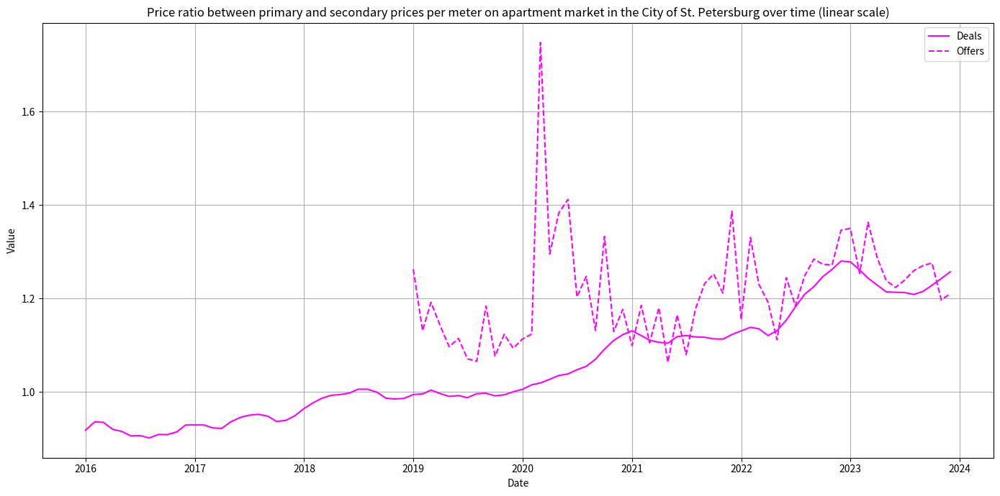

In [91]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in the City of St. Petersburg over time (linear scale)')

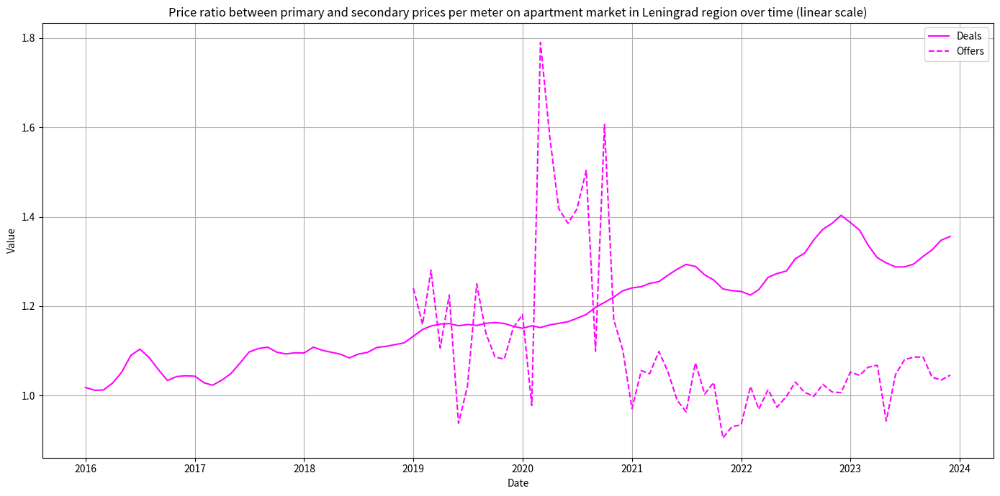

In [92]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in Leningrad region over time (linear scale)')

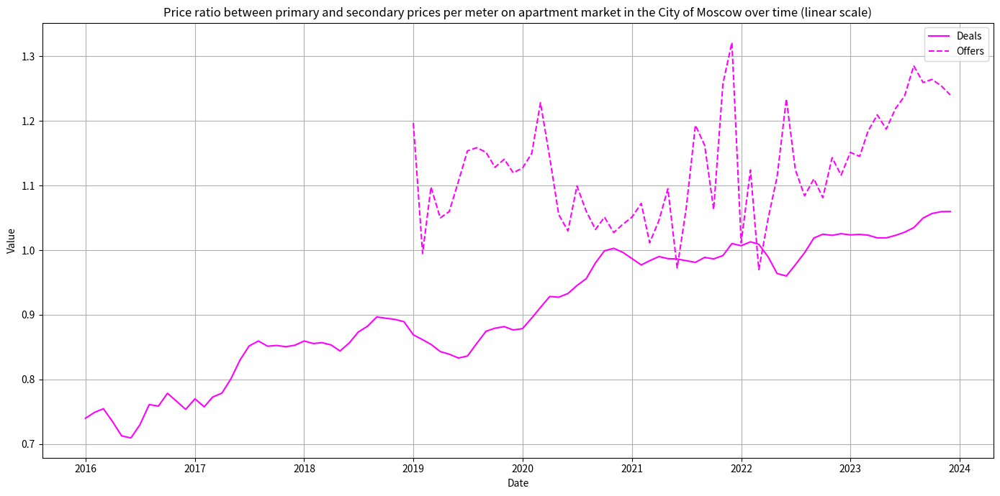

In [93]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in the City of Moscow over time (linear scale)')

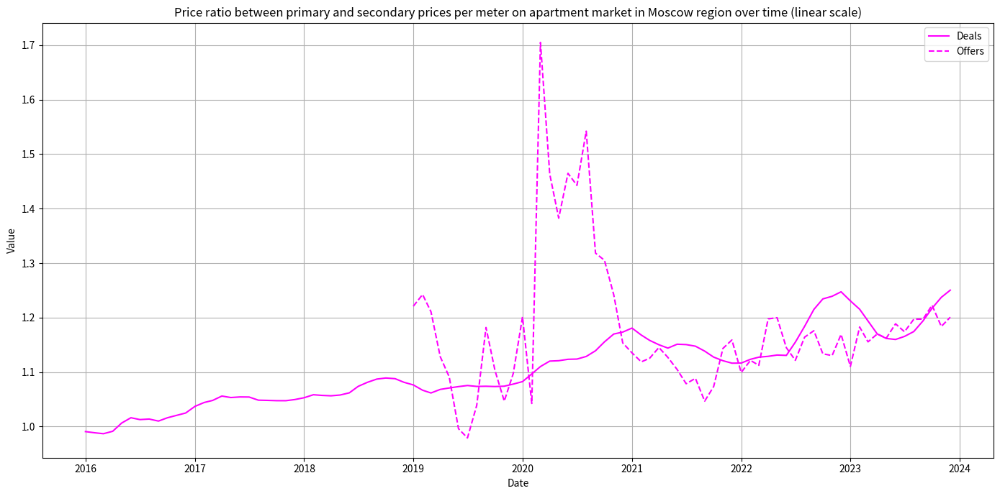

In [94]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in Moscow region over time (linear scale)')

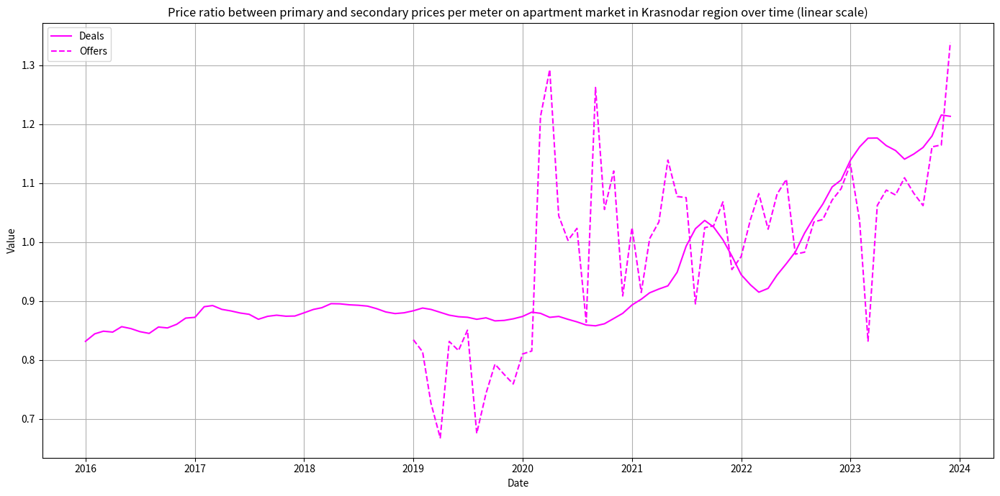

In [95]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in Krasnodar region over time (linear scale)')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [96]:
syv.save_price_ratios_plots(deals_ratios_ts,
                         offers_ratios_ts,
                         column_name='value')

##### 5.2.5.2 Volume indicators ratios

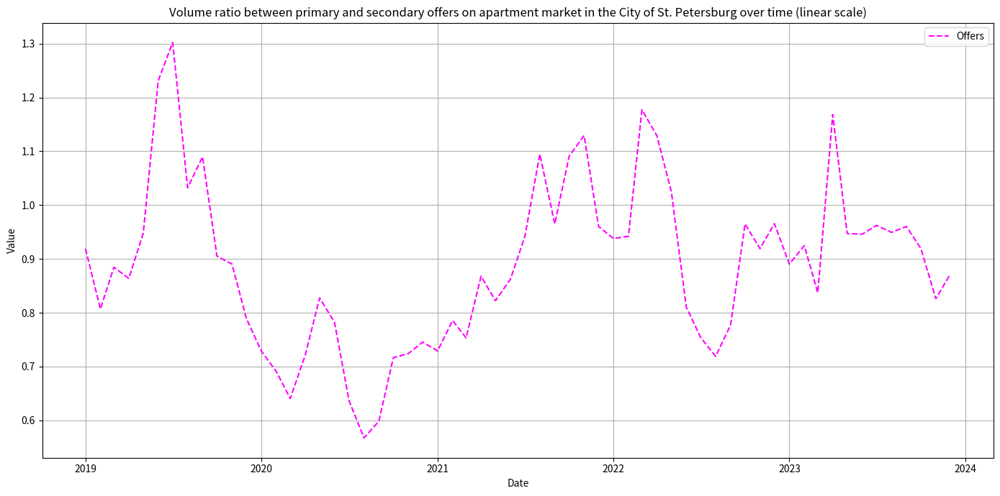

In [97]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in the City of St. Petersburg over time (linear scale)')

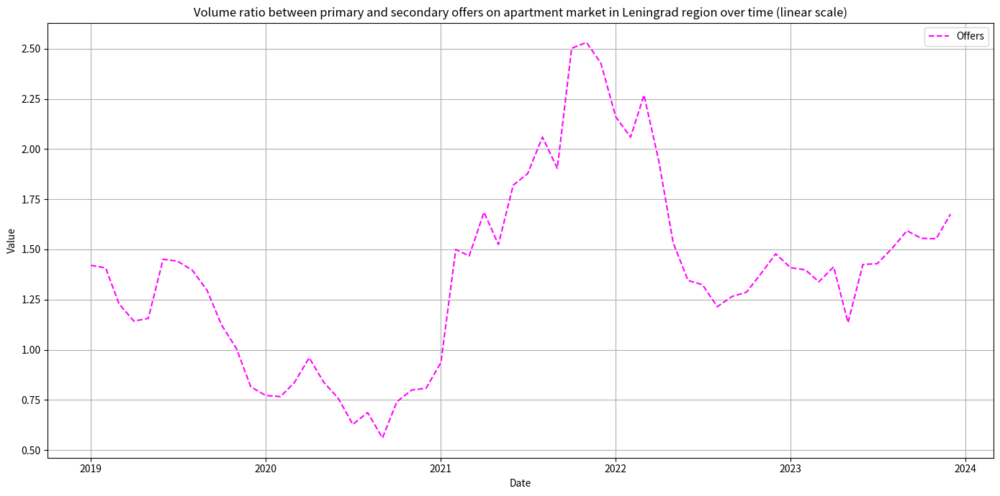

In [98]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in Leningrad region over time (linear scale)')

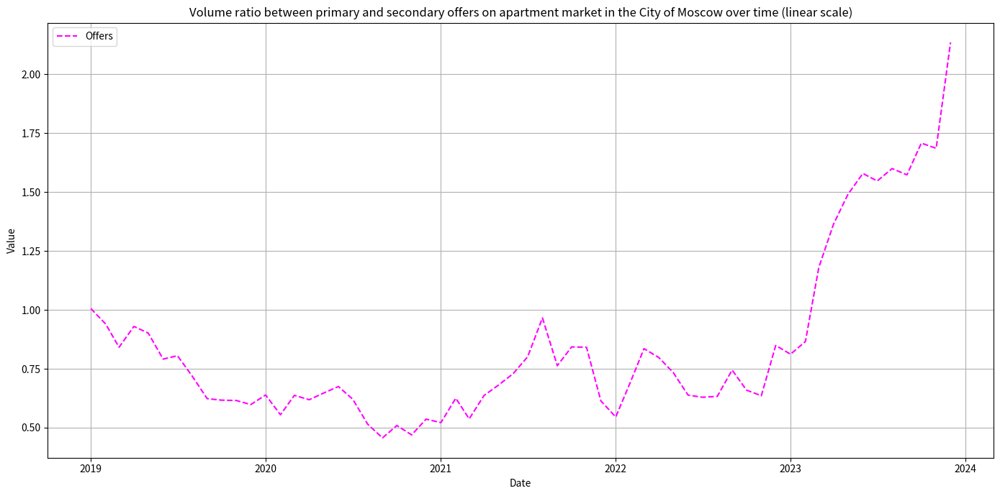

In [99]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in the City of Moscow over time (linear scale)')

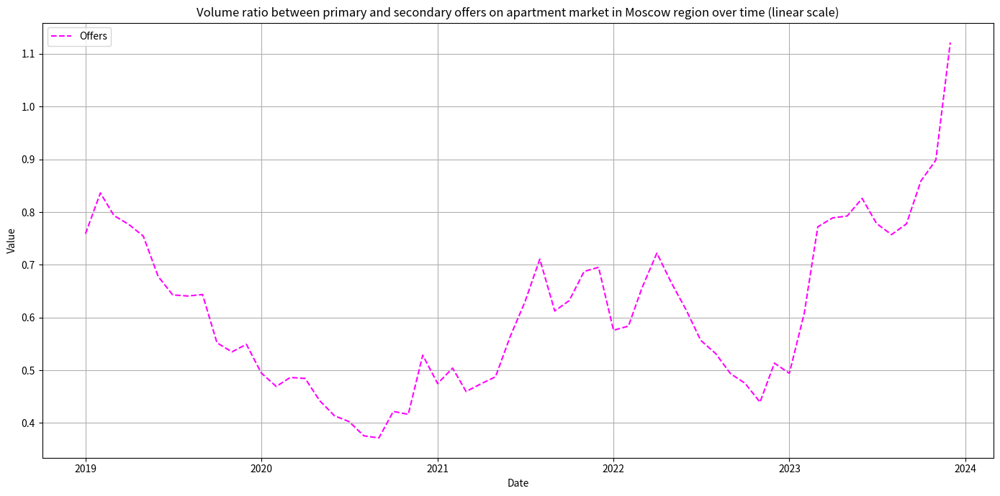

In [100]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in Moscow region over time (linear scale)')

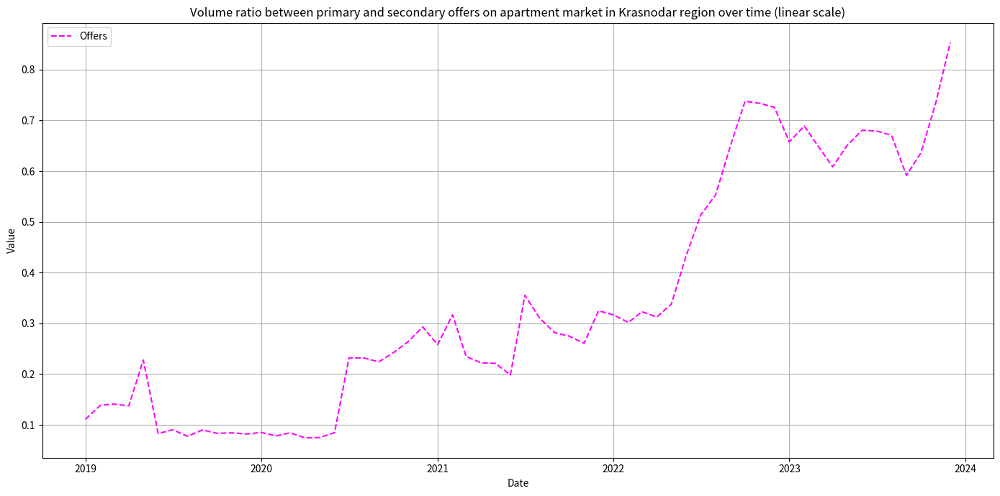

In [101]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in Krasnodar region over time (linear scale)')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [102]:
syv.save_volume_ratios_plots(volumes_ratios_ts,
                           column_name='value')

##### 5.2.5.3 Discount indicator ratios

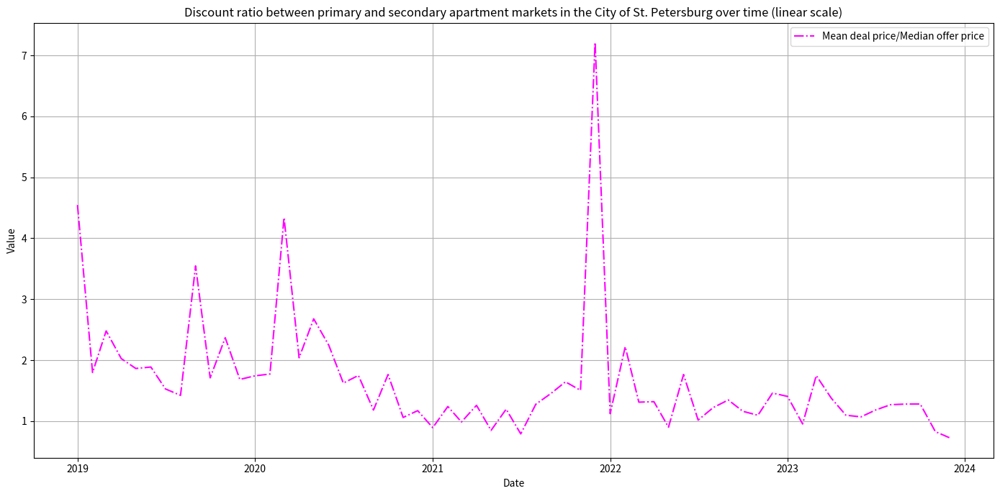

In [103]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in the City of St. Petersburg over time (linear scale)')

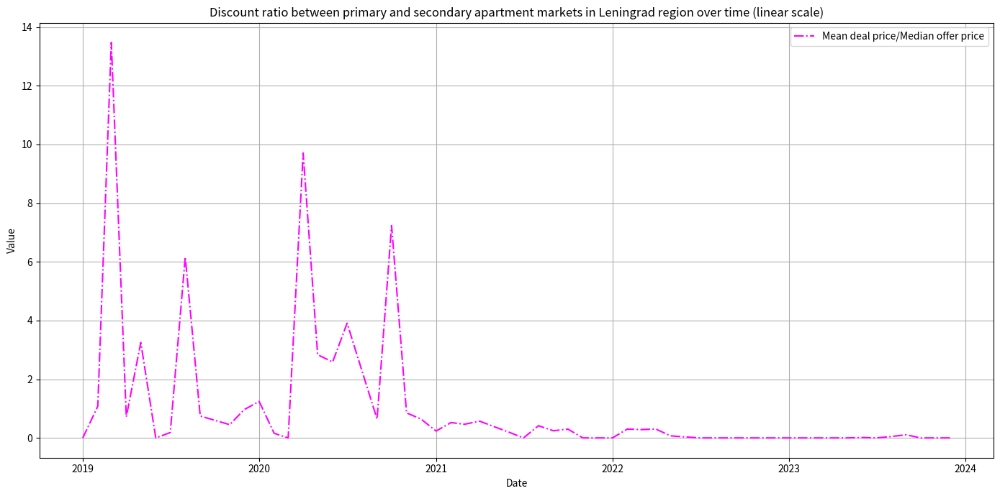

In [104]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in Leningrad region over time (linear scale)')

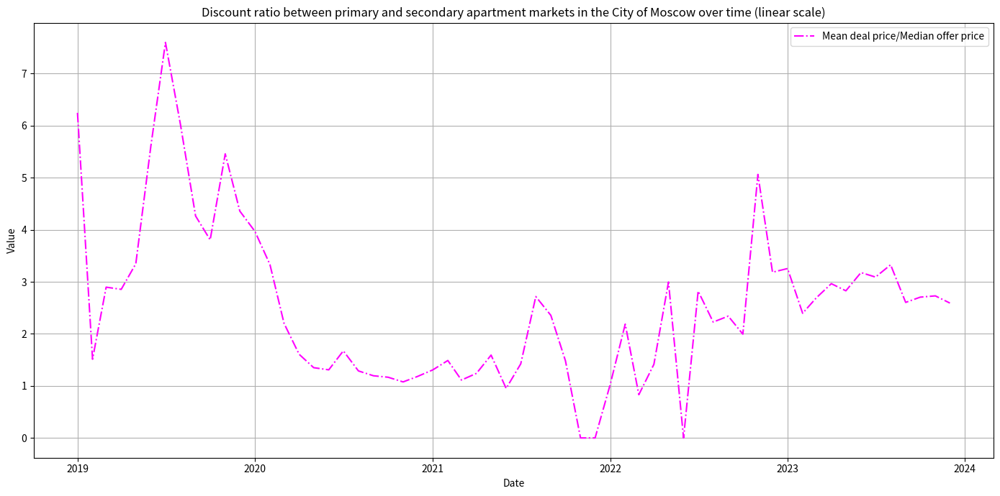

In [105]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in the City of Moscow over time (linear scale)')

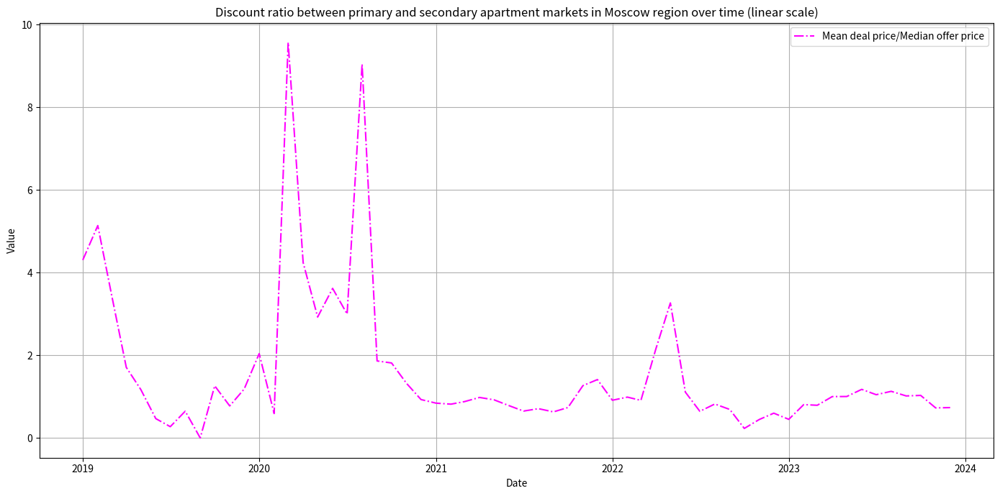

In [106]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in Moscow region over time (linear scale)')

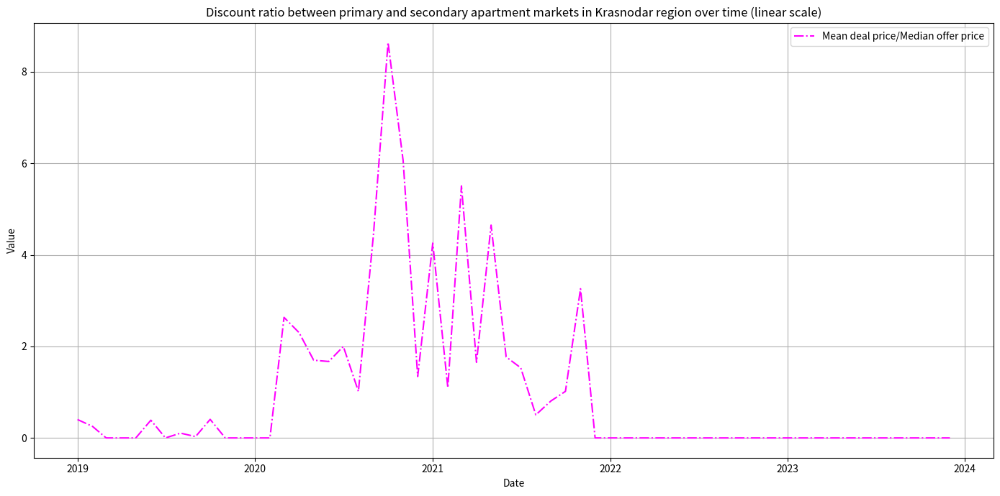

In [107]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in Krasnodar region over time (linear scale)')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [108]:
syv.save_discount_ratios_plots(discounts_ratios_ts,\
                           column_name='value')

#### 5.2.6 Gaps between primary and secondary market indicators

Let us plot the gaps between price, volume, and discount indicators of primary and secondary markets of five key regions: St. Petersburg, Leningrad region, Moscow, Moscow region, Krasnodar region. When calculating the ratio indicator, the data of the primary market are used in decreasing order. Thus, the value of the indicator is greater than zero, which means that the value of the primary market indicator is greater than the same indicator of the secondary market.

In [109]:
gaps_labels_1 = ['Deals',
                  'Offers']
gaps_labels_2 = ['Offers']
gaps_labels_3 = ['Mean deal price - Median offer price']

##### 5.2.6.1 Gaps between price indicators

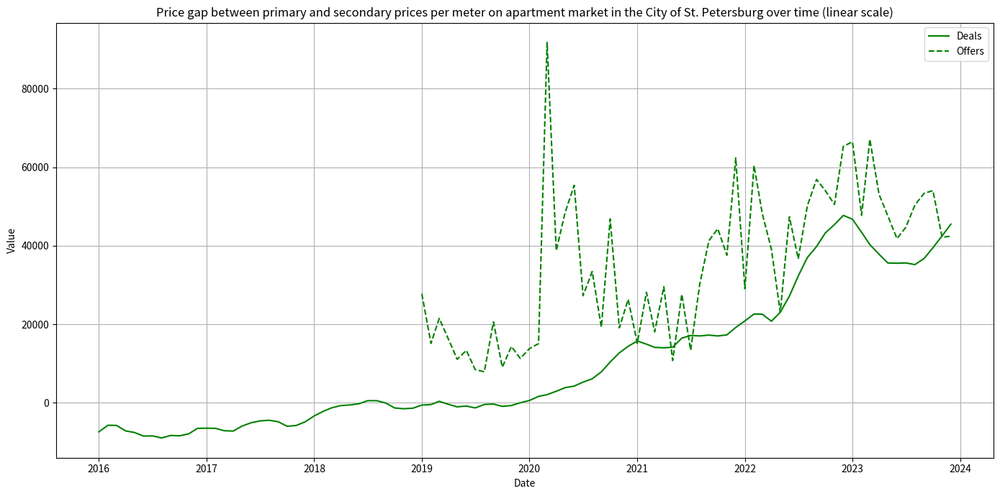

In [110]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in the City of St. Petersburg over time (linear scale)')

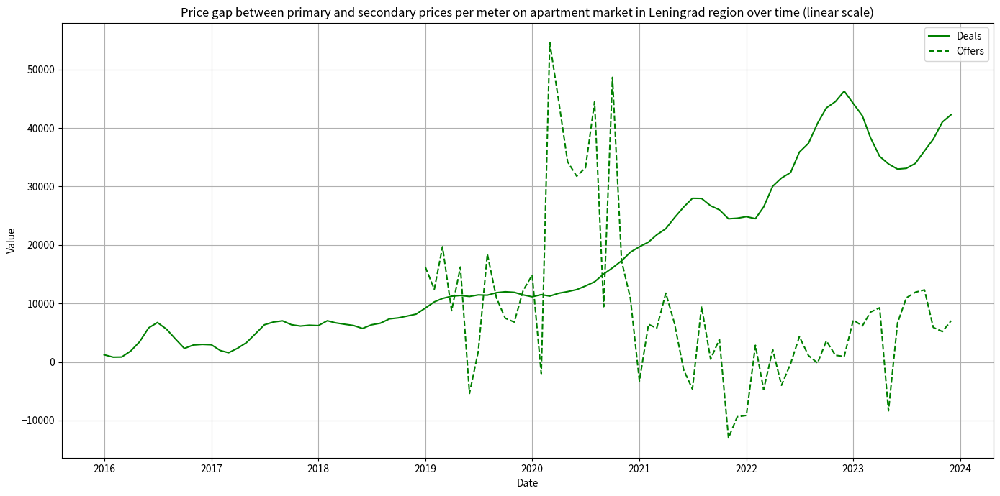

In [111]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in Leningrad region over time (linear scale)')

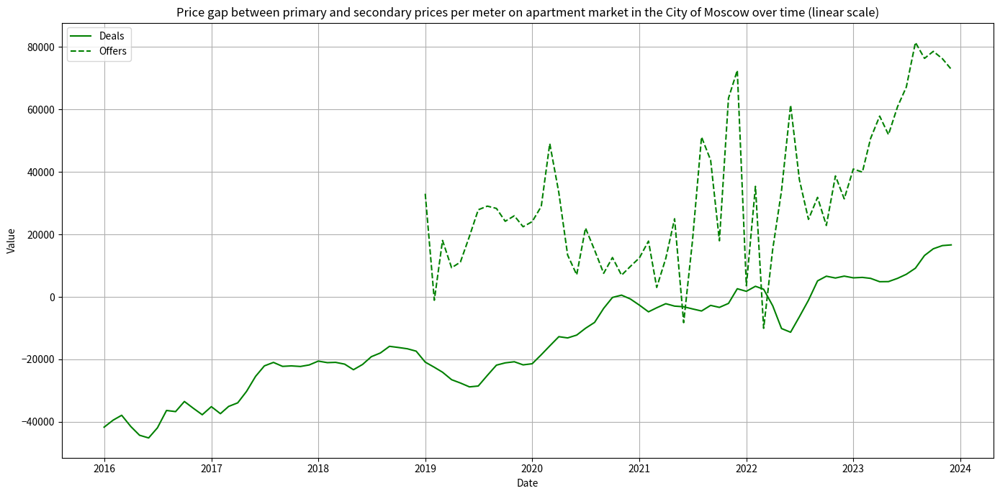

In [112]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in the City of Moscow over time (linear scale)')

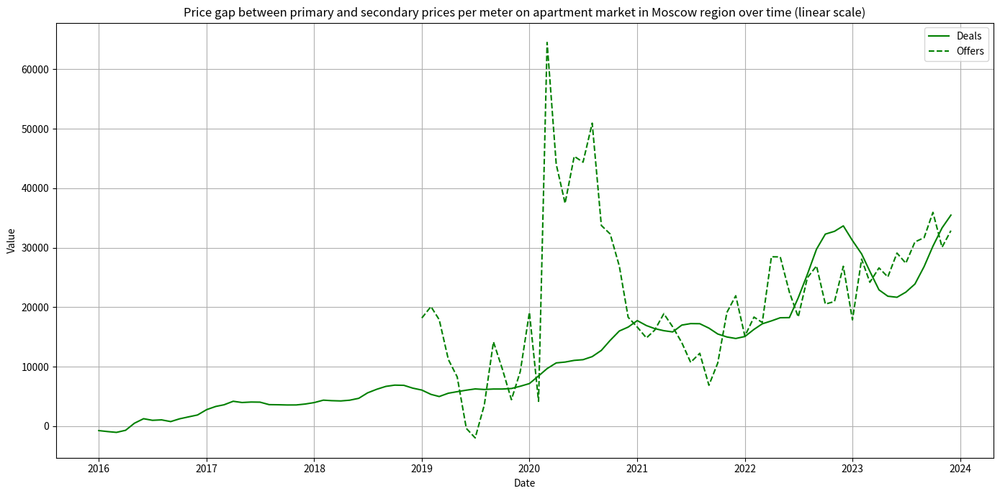

In [113]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in Moscow region over time (linear scale)')

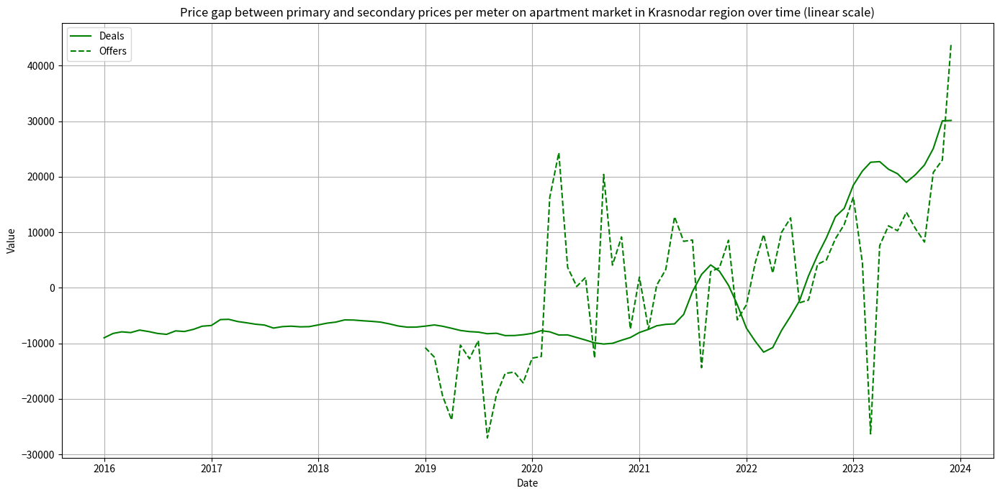

In [114]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in Krasnodar region over time (linear scale)')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [115]:
syv.save_price_gaps_plots(deals_gaps_ts,\
                         offers_gaps_ts,\
                         column_name='value')

##### 5.2.6.2 Gaps between volume indicators

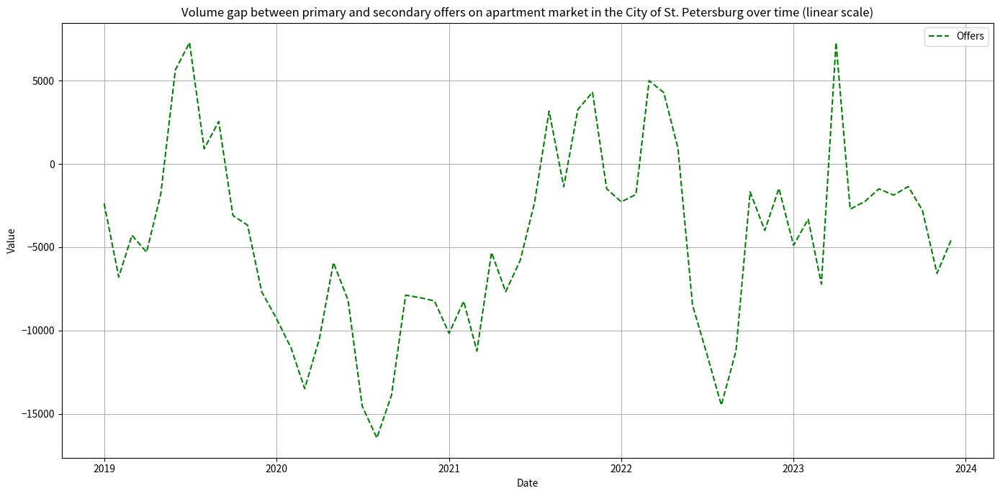

In [116]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in the City of St. Petersburg over time (linear scale)')

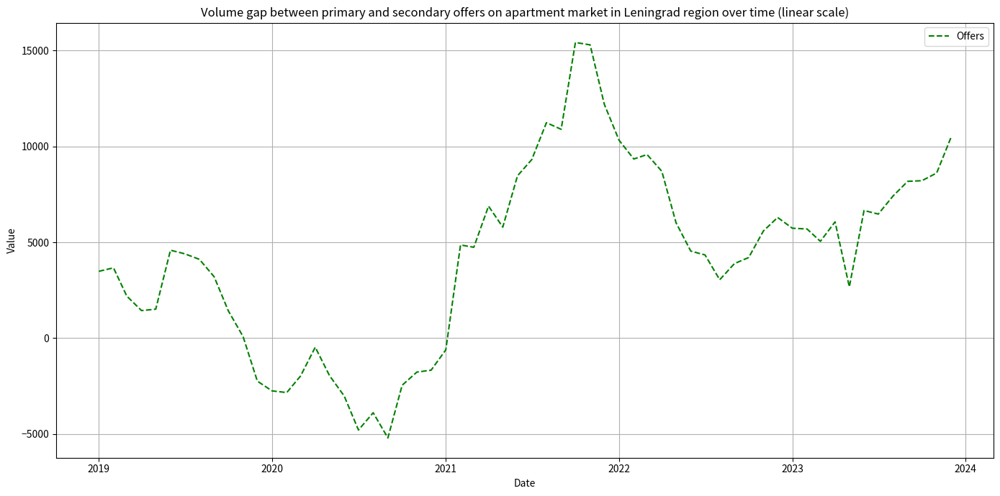

In [117]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in Leningrad region over time (linear scale)')

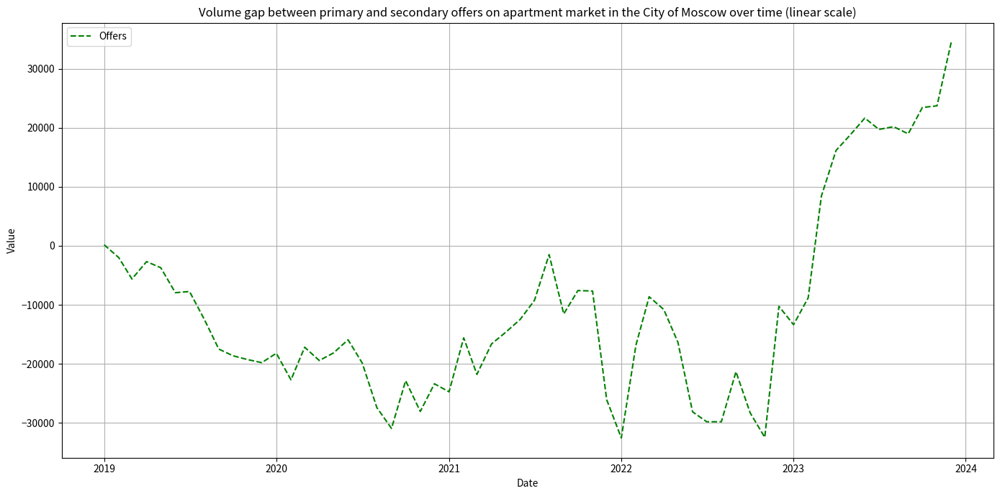

In [118]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in the City of Moscow over time (linear scale)')

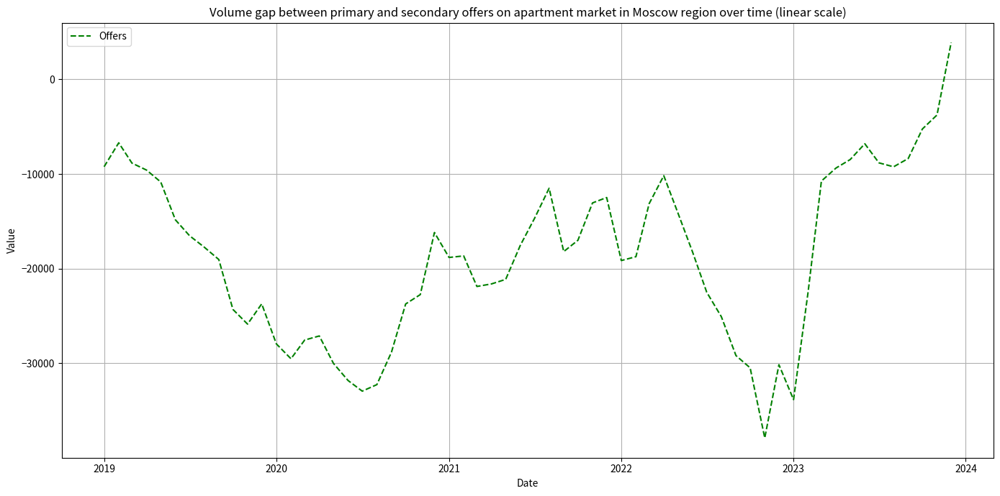

In [119]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in Moscow region over time (linear scale)')

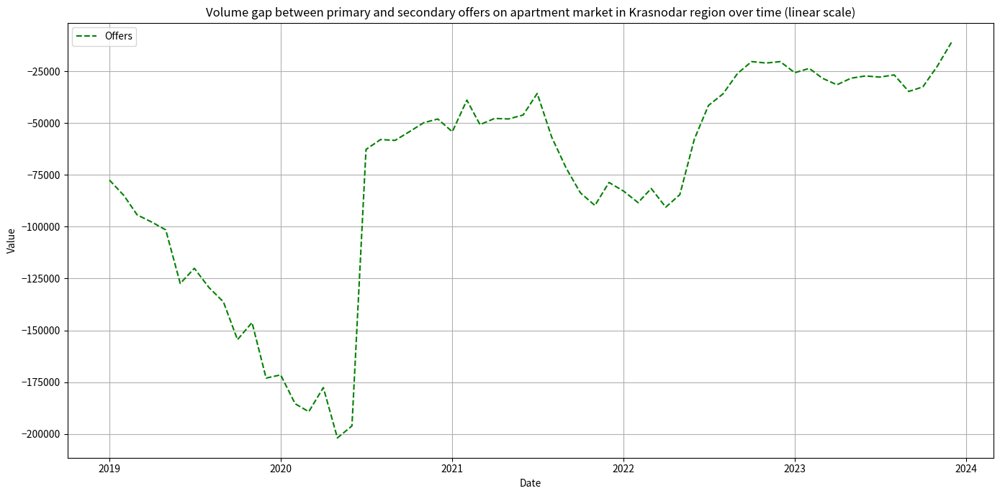

In [120]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in Krasnodar region over time (linear scale)')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [121]:
syv.save_volume_gaps_plots(volumes_gaps_ts,
                          column_name='value')

##### 5.2.6.3 Gaps between discount indicators

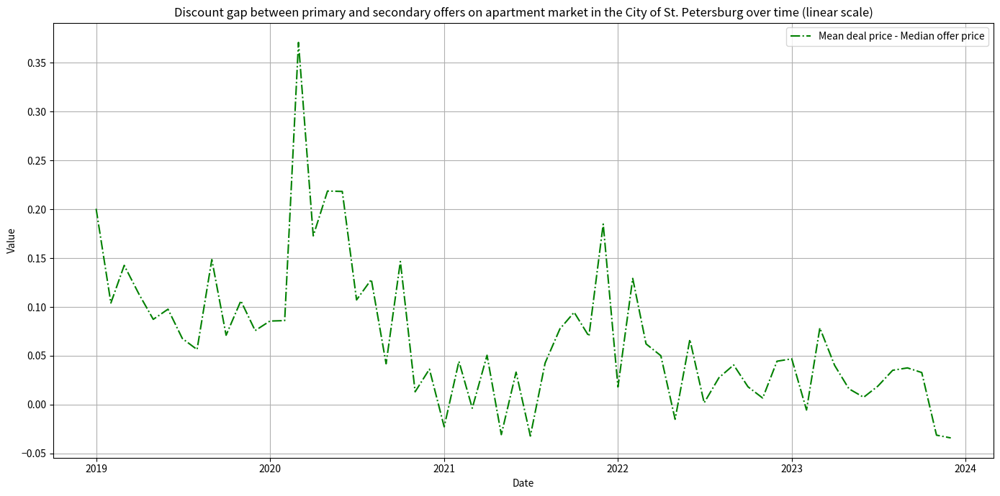

In [122]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in the City of St. Petersburg over time (linear scale)')

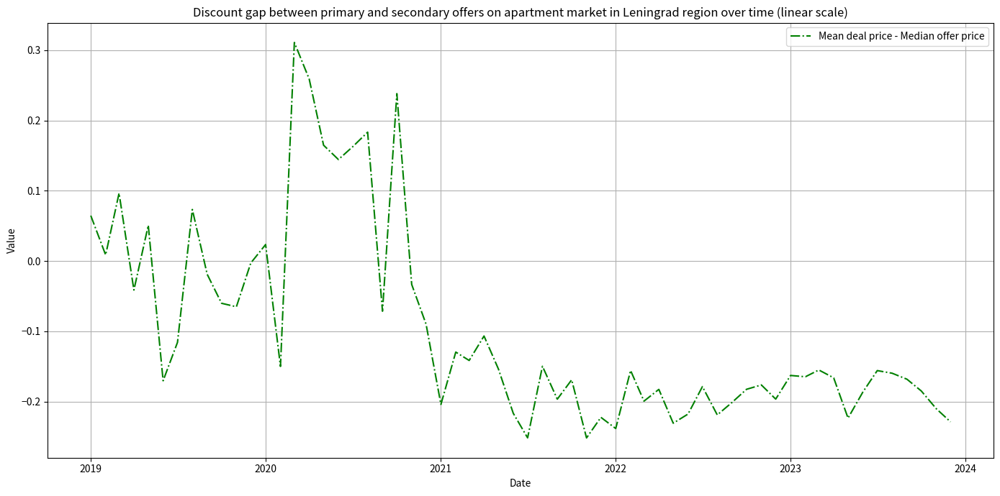

In [123]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in Leningrad region over time (linear scale)')

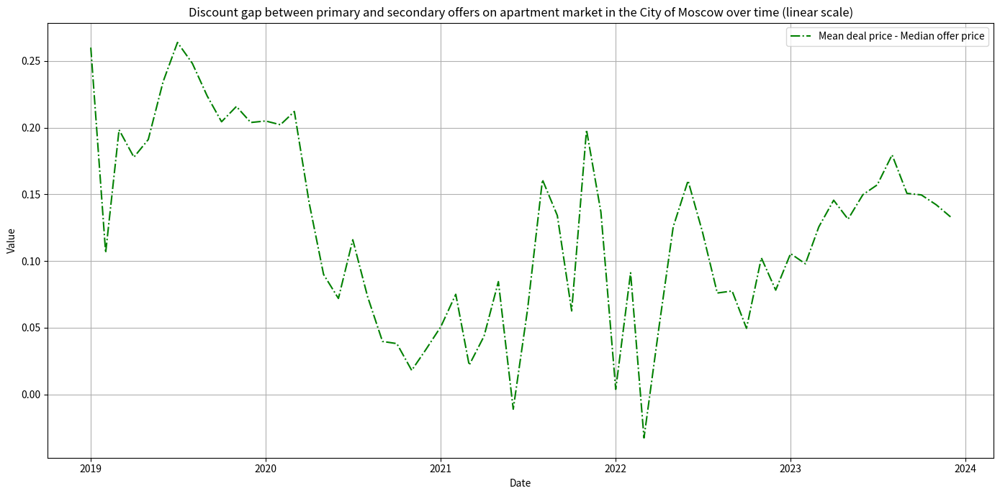

In [124]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in the City of Moscow over time (linear scale)')

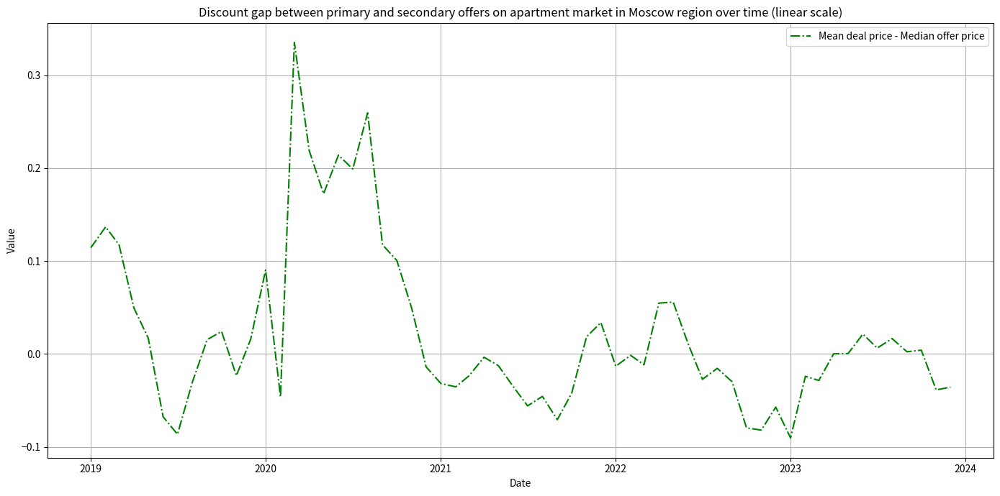

In [125]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in Moscow region over time (linear scale)')

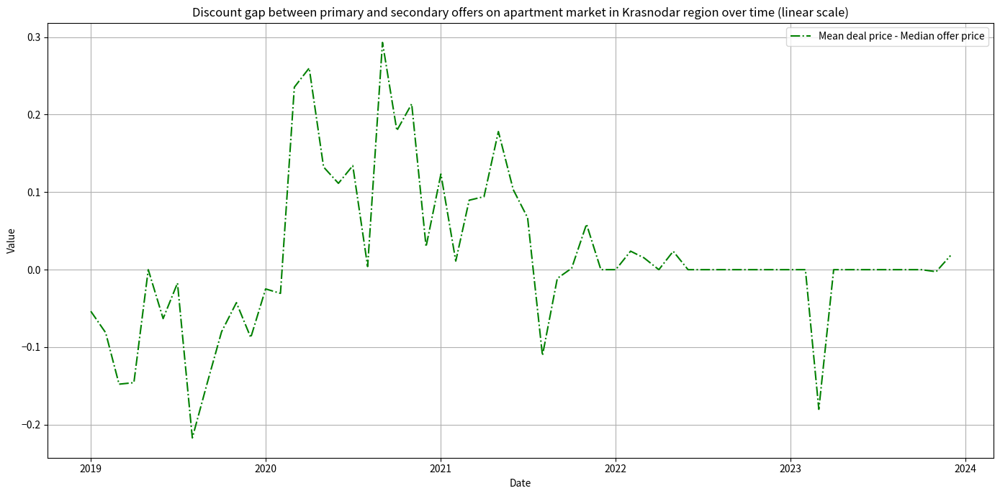

In [126]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in Krasnodar region over time (linear scale)')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [127]:
syv.save_discount_gaps_plots(discounts_gaps_ts,\
                            column_name='value')

### 5.3 Regional inequality dynamics analysis

Graph of the dynamics of the Gini coefficient for mean transaction prices and median bid prices in the primary market.

In [128]:
labels_gini_ts_1 = ['Deals', 'Offers']
labels_gini_ts_2 = ['Primary market', 'Secondary market']
labels_gini_ts_3 = ['Secondary market']

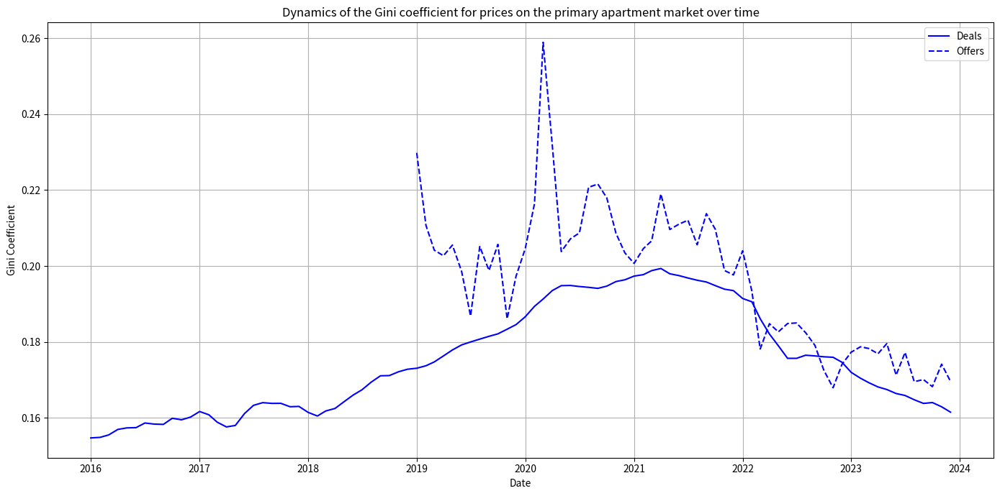

In [129]:
syv.plot_gini_ts(primary_deals_gini_ts, primary_offers_gini_ts,
                           labels=labels_gini_ts_1, colors=['blue', 'blue'], linestyles=['-', '--'],
                           plot_title=f'Dynamics of the Gini coefficient for prices on the primary apartment market over time')

Graph of the dynamics of the Gini coefficient for mean transaction prices and median bid prices in the secondary market.

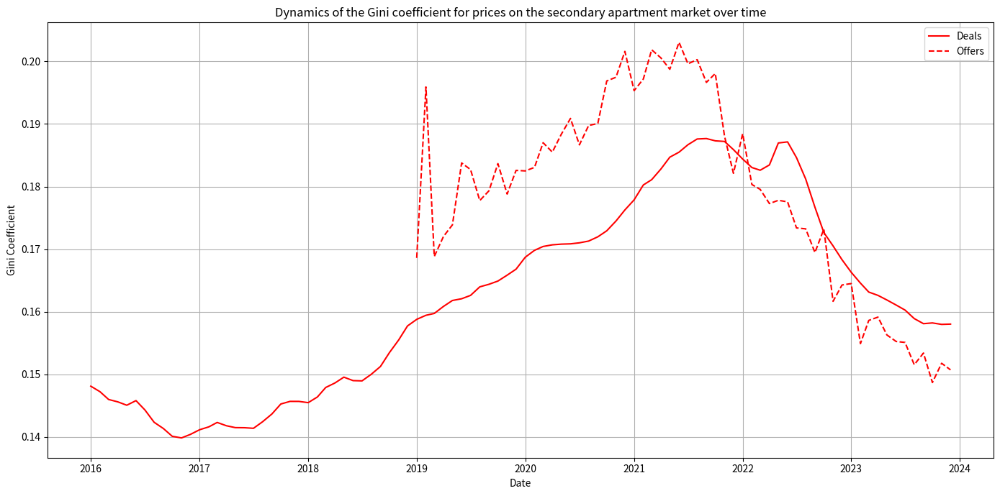

In [130]:
syv.plot_gini_ts(secondary_deals_gini_ts, secondary_offers_gini_ts,
                           labels=labels_gini_ts_1, colors=['red', 'red'], linestyles=['-', '--'],
                           plot_title=f'Dynamics of the Gini coefficient for prices on the secondary apartment market over time')

Graph of the dynamics of the Gini coefficient for primary and secondary market volumes.

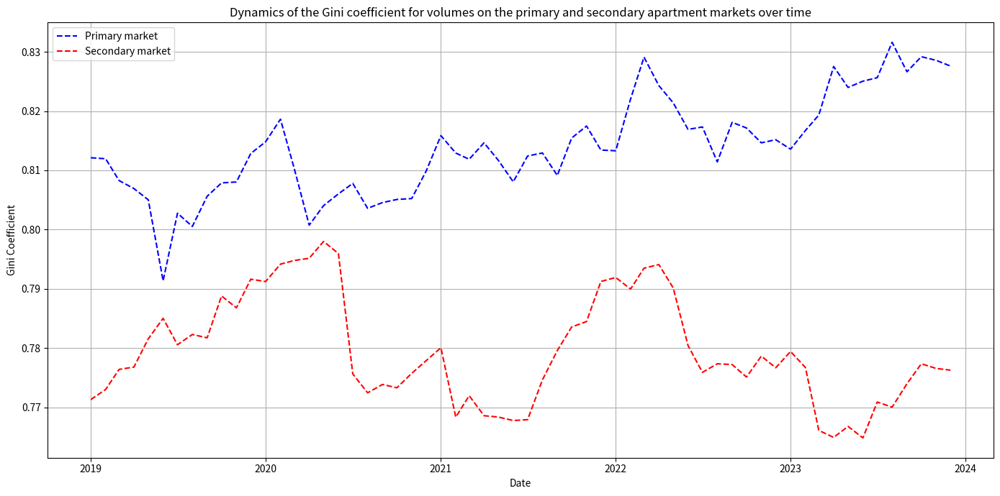

In [131]:
syv.plot_gini_ts(primary_volumes_gini_ts, secondary_volumes_gini_ts,
                           labels=labels_gini_ts_2, colors=['blue', 'red'], linestyles=['--', '--'],
                           plot_title=f'Dynamics of the Gini coefficient for volumes on the primary and secondary apartment markets over time')

Graph of Gini coefficient dynamics for secondary market exposure terms.

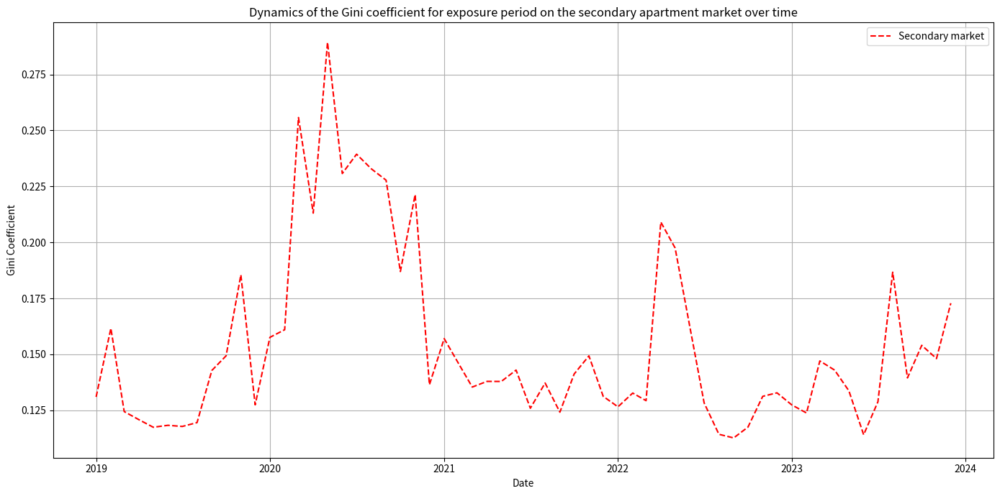

In [132]:
syv.plot_gini_ts(secondary_exposure_gini_ts,
                           labels=labels_gini_ts_3, colors=['red'], linestyles=['--'],
                           plot_title=f'Dynamics of the Gini coefficient for exposure period on the secondary apartment market over time')

Charts are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [133]:
# Save plot for the primary market prices
syv.save_gini_ts_plot(primary_deals_gini_ts, primary_offers_gini_ts,
                  labels = labels_gini_ts_1,
                  file_name = 'primary_prices_gini_ts',
                  colors=['blue', 'blue'],
                  linestyles=['-', '--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for prices on the primary apartment market over time")

# Save plot for the secondary market prices
syv.save_gini_ts_plot(secondary_deals_gini_ts, secondary_offers_gini_ts,
                  labels = labels_gini_ts_1,
                  file_name = 'secondary_prices_gini_ts',
                  colors=['red', 'red'],
                  linestyles=['-', '--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for prices on the secondary apartment market over time")

# Save plot for the primary and secondary markets volumes
syv.save_gini_ts_plot(primary_volumes_gini_ts, secondary_volumes_gini_ts,
                  labels = labels_gini_ts_2,
                  file_name = 'volumes_gini_ts',
                  colors=['blue', 'red'],
                  linestyles=['--', '--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for volumes on the primary and secondary apartment markets over time")

# Save plot for the secondary market exposure period
syv.save_gini_ts_plot(secondary_exposure_gini_ts,
                  labels = labels_gini_ts_3,
                  file_name = 'secondary_exposure_gini_ts',
                  colors=['red'],
                  linestyles=['--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for exposure period on the secondary apartment market over time")

### 5.4 Analysis of real ruble price indicators

#### 5.4.1 Processing of annual inflation rate data

World Bank data is used as a source of [data on inflation in Russia](https://databank.worldbank.org/source/world-development-indicators/Series/NY.GDP.DEFL.KD.ZG#).

In [134]:
annual_inflation_rus = syv.read_inflation_data_rus()

Let's perform data smoothing using the [LOWESS method](https://en.wikipedia.org/wiki/Local_regression).

In [135]:
annual_inflation_rus_smoothed = syv.smooth_lowess(annual_inflation_rus, 'year', 'inflation', frac=0.3)


Let's plot inflation on a linear scale.

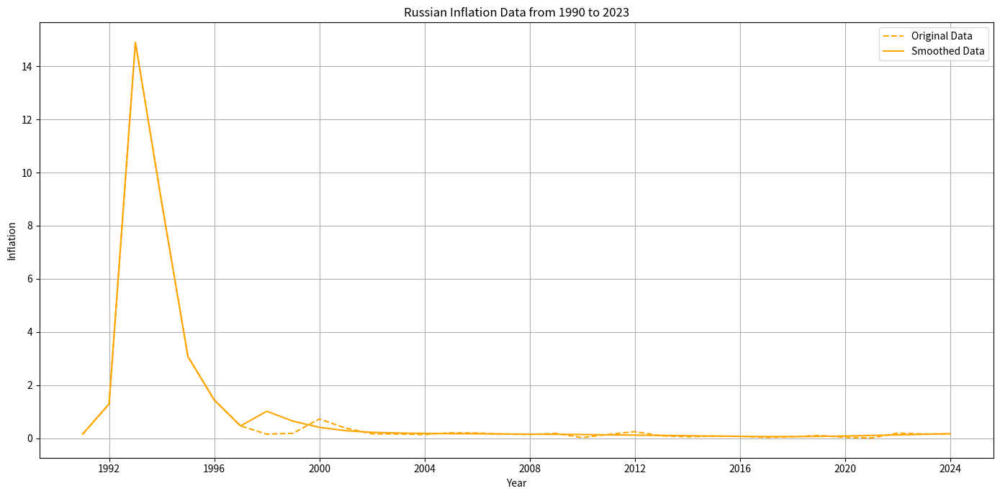

In [136]:
syv.plot_inflation_data(annual_inflation_rus, annual_inflation_rus_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="Russian Inflation Data from 1990 to 2023",
                        yscale = 'linear')

Let's plot inflation on a logarithmic scale.

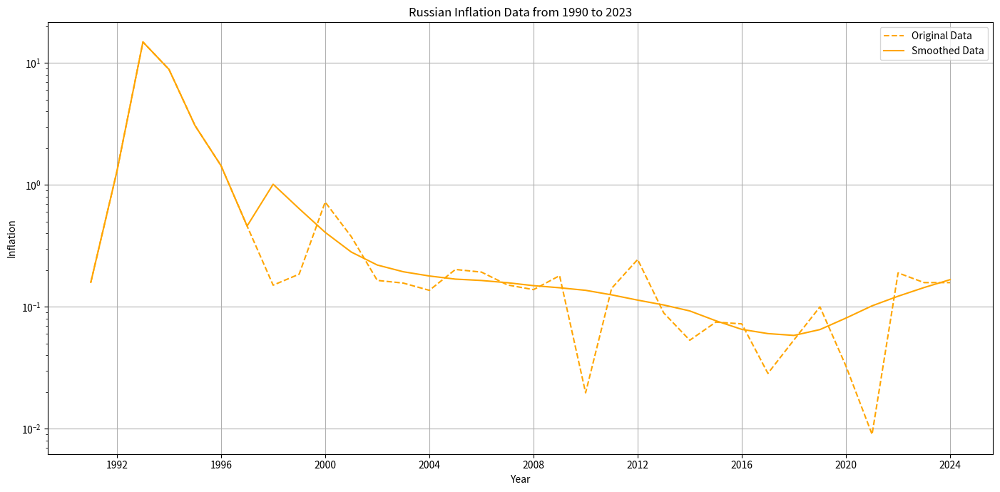

In [137]:
syv.plot_inflation_data(annual_inflation_rus, annual_inflation_rus_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="Russian Inflation Data from 1990 to 2023",
                        yscale = 'log')

Let's plot ruble inflation from 2002 to 2023 inclusive.

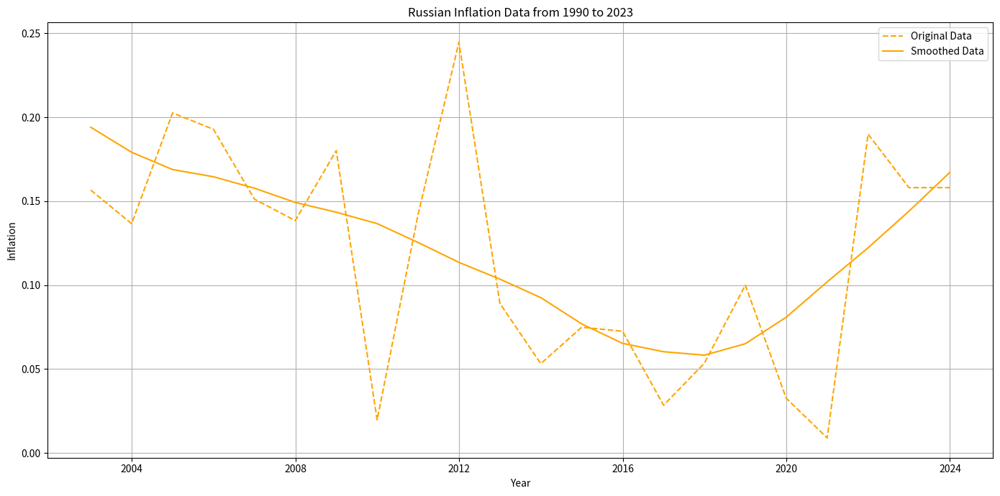

In [138]:
syv.plot_inflation_data(annual_inflation_rus, annual_inflation_rus_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="Russian Inflation Data from 1990 to 2023",
                        yscale = 'linear', start_date="2002-01-01", end_date="2023-12-31")

Charts are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [139]:
# Plot inflation from 1990 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_rus, annual_inflation_rus_smoothed,
                        file_name='annual_inflation_1990_2023_linear',
                        start_date="1990-01-01", end_date="2023-12-31", 
                        yscale='linear', title="Russian Inflation Data from 1990 to 2023 (linear scale)")

# Plot inflation from 1990 to 2023 in logarithmic scale
syv.save_inflation_plot(annual_inflation_rus, annual_inflation_rus_smoothed,
                        file_name='annual_inflation_1990_2023_log',
                        start_date="1990-01-01", end_date="2023-12-31", 
                        yscale='log', title="Russian Inflation Data from 1990 to 2023 (logarithmic scale)")

# Plot inflation from 2002 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_rus, annual_inflation_rus_smoothed,
                        file_name='annual_inflation_2002_2023_linear',
                        start_date="2002-01-01", end_date="2023-12-31", 
                        yscale='linear', title="Russian Inflation Data from 2002 to 2023 (linear scale)")

#### 5.4.2 Monthly inflation calculation

Let's calculate monthly ruble inflation rates.

In [140]:
monthly_inflation_rus = syv.calculate_monthly_inflation(annual_inflation_rus_smoothed,
                                                       inflation_column='smoothed_inflation')
monthly_inflation_rus = syv.filter_date_range(monthly_inflation_rus, start_date="2016-01", end_date="2023-12")
monthly_inflation_rus = syv.convert_date_to_month_year(monthly_inflation_rus)
monthly_inflation_rus = monthly_inflation_rus[0]
monthly_inflation_rus = monthly_inflation_rus.reset_index(drop=True)

Let's calculate the inflation indices relative to the base date 2020-01-01.

In [141]:
monthly_inflation_rus_relative = syv.calculate_relative_inflation(monthly_inflation_rus.copy())

#### 5.4.3 Calculation of real ruble prices for each region and month

Let's calculate real ruble prices of deals and offers.

In [142]:
# Read data
primary_deals_ts, primary_offers_ts,\
secondary_deals_ts, secondary_offers_ts = syv.sort_dataframe_by_date(primary_deals_ts,\
                                                            primary_offers_ts,\
                                                            secondary_deals_ts,\
                                                            secondary_offers_ts)

# Set the appropriate date format
monthly_inflation_rus_relative['date'] = monthly_inflation_rus_relative['date'].dt.to_timestamp()
primary_deals_ts['date'] = pd.to_datetime(primary_deals_ts['date'])
primary_deals_ts['date'] = primary_deals_ts['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts['date'] = pd.to_datetime(primary_offers_ts['date'])
primary_offers_ts['date'] = primary_offers_ts['date'].dt.to_period('M').dt.to_timestamp()
secondary_deals_ts['date'] = pd.to_datetime(secondary_deals_ts['date'])
secondary_deals_ts['date'] = secondary_deals_ts['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts['date'] = pd.to_datetime(primary_offers_ts['date'])
primary_offers_ts['date'] = primary_offers_ts['date'].dt.to_period('M').dt.to_timestamp()


In [143]:
# Calculate real prices
primary_deals_real, primary_offers_real, secondary_deals_real, secondary_offers_real = \
    syv.calculate_real_prices(monthly_inflation_rus_relative, 
                              'cumulative_inflation',
                              primary_deals_ts,
                              primary_offers_ts,
                              secondary_deals_ts,
                              secondary_offers_ts,
                              value_column='value')


In [144]:
# Round real prices
primary_deals_real['value_real'] = primary_deals_real['value_real'].round(0).astype(int)
primary_offers_real['value_real'] = primary_offers_real['value_real'].round(0).astype(int)
secondary_deals_real['value_real'] = secondary_deals_real['value_real'].round(0).astype(int)
secondary_offers_real['value_real'] = secondary_offers_real['value_real'].round(0).astype(int)


#### 5.4.4 Real ruble prices visualization

Let us chart the dynamics of real ruble prices for five key regions: St. Petersburg, Leningrad region, Moscow, Moscow region, Krasnodar region.

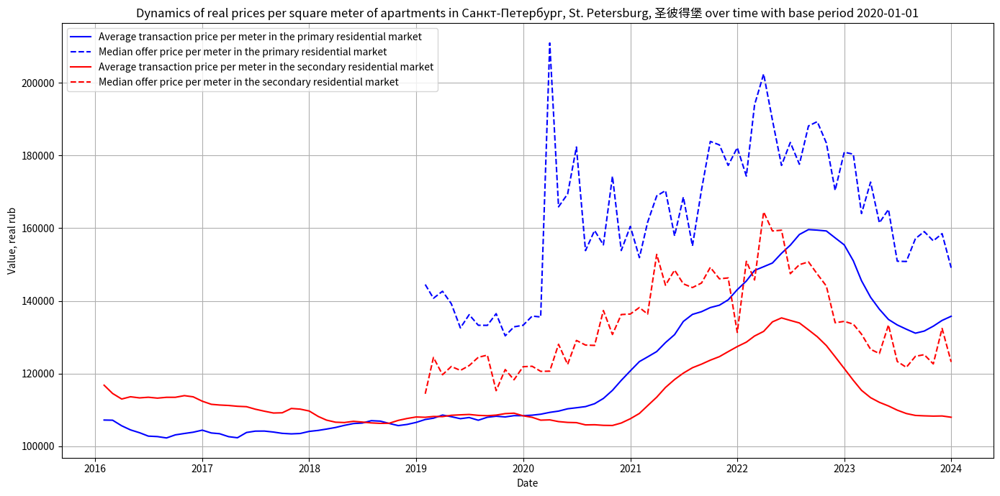

In [145]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Санкт-Петербург, St. Petersburg, 圣彼得堡')

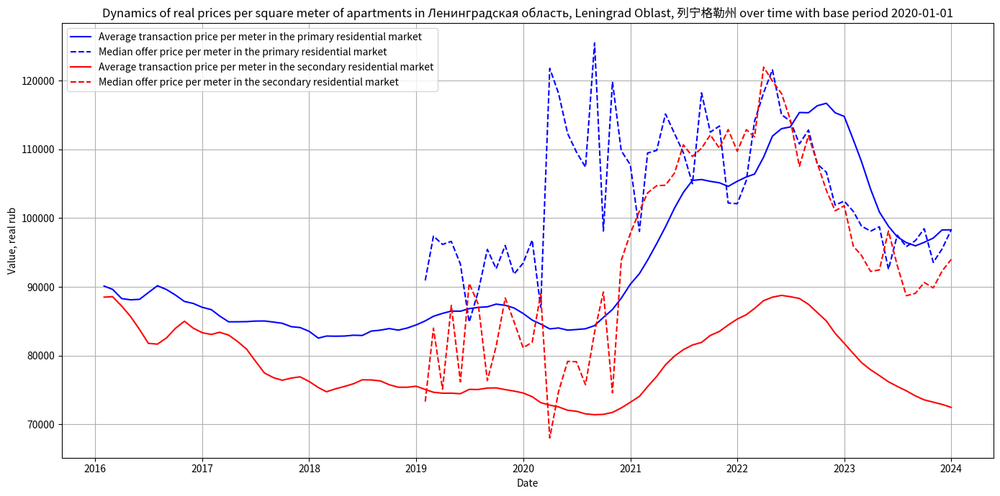

In [146]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Ленинградская область, Leningrad Oblast, 列宁格勒州')

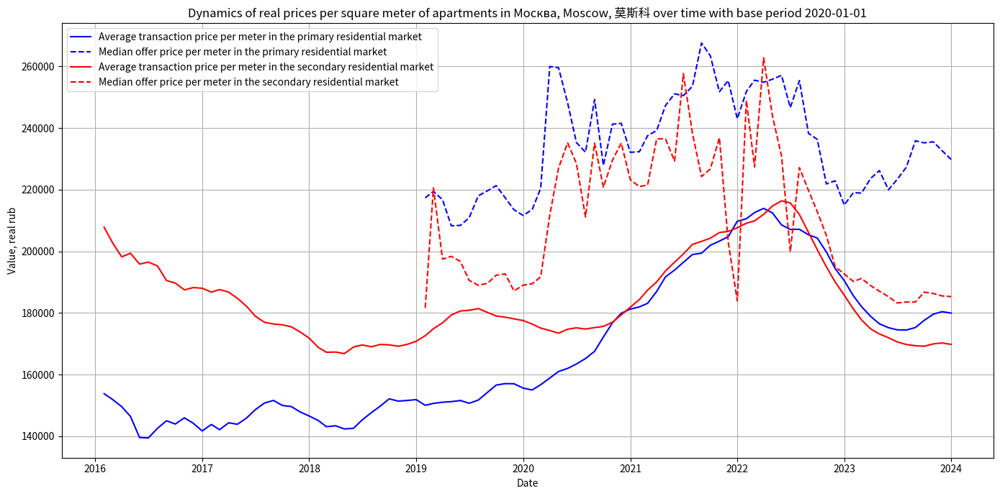

In [147]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Москва, Moscow, 莫斯科')

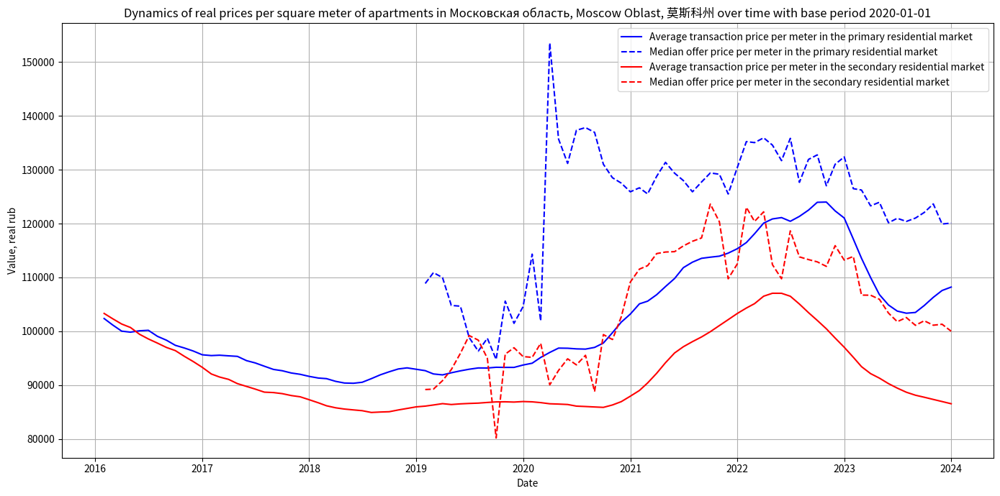

In [148]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Московская область, Moscow Oblast, 莫斯科州')

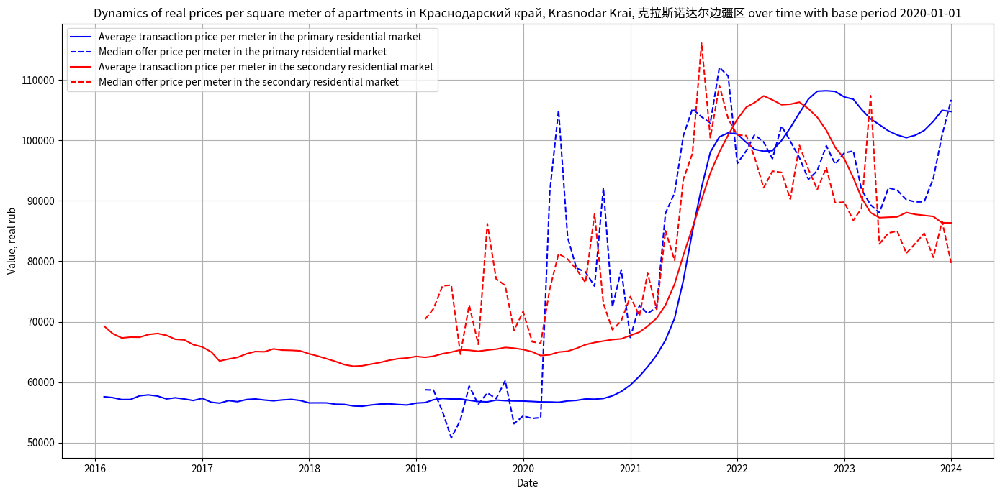

In [149]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [150]:
syv.save_real_prices_plots(primary_deals_real,
                           primary_offers_real,
                           secondary_deals_real,
                           secondary_offers_real)

## 5.5 Analysis of nominal dollar price indicators

The [data of the Central Bank of the Russian Federation](https://www.cbr.ru/currency_base/dynamics/) is used as a source of data on the exchange rate of the U.S. ruble to the dollar for the given dates.

### 5.5.1 Data preparation

Download ruble-dollar exchange rate data. All exchange rates are given at par value after the [1998 monetary reform](https://en.wikipedia.org/wiki/Monetary_reform_in_Russia,_1998). 

In [151]:
usd_rub_rates = syv.get_usd_rub_ex_rate()

Smoothing the data using the LOWESS method.

In [152]:
usd_rub_rates = syv.smooth_exchange_rate(usd_rub_rates)

Visualization of the initial and smoothed data of the dynamics of the dollar-ruble exchange rate.

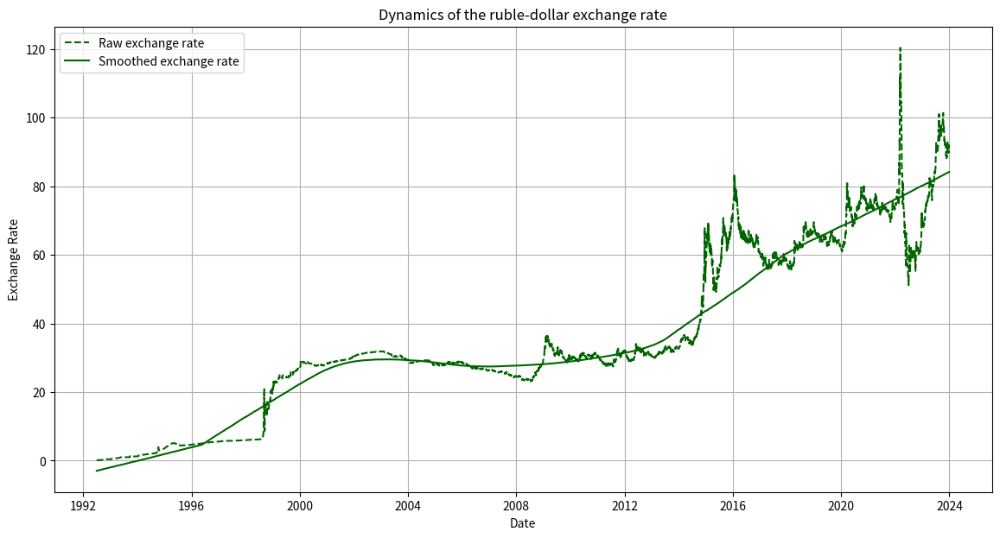

In [153]:
syv.plot_and_save_exchange_rate(usd_rub_rates)


Since the price data is presented on a monthly basis, let's calculate the average exchange rate by month.

In [154]:
monthly_avg_ex_rates = syv.calculate_monthly_avg_ex_rate(usd_rub_rates.copy())
monthly_avg_ex_rates['last_day_of_month'] = monthly_avg_ex_rates['date'].dt.to_timestamp('M') + pd.DateOffset(months=-0, days=-0)
monthly_avg_ex_rates = monthly_avg_ex_rates[['last_day_of_month', 'smoothed_rate']]

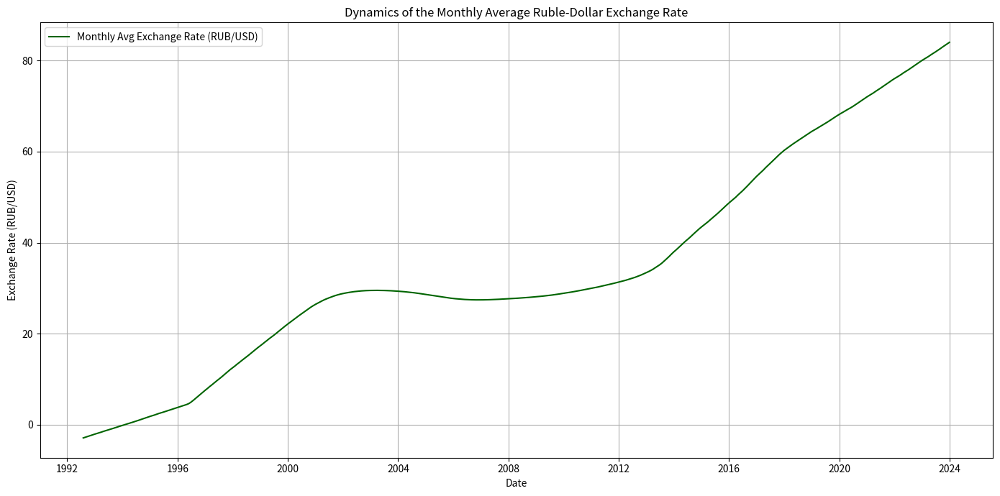

In [155]:
syv.plot_and_save_monthly_avg_exchange_rate(monthly_avg_ex_rates)

Let's calculate nominal dollar prices.

In [156]:
# Convert dates to datetime format
primary_deals_ts['date'] = pd.to_datetime(primary_deals_ts['date'])
primary_offers_ts['date'] = pd.to_datetime(primary_offers_ts['date'])
secondary_deals_ts['date'] = pd.to_datetime(secondary_deals_ts['date'])
secondary_offers_ts['date'] = pd.to_datetime(secondary_offers_ts['date'])


# Calculate prices in dollars
primary_deals_ts_usd = syv.convert_to_usd(primary_deals_ts, monthly_avg_ex_rates, 'value')
primary_offers_ts_usd = syv.convert_to_usd(primary_offers_ts, monthly_avg_ex_rates, 'value')
secondary_deals_ts_usd = syv.convert_to_usd(secondary_deals_ts, monthly_avg_ex_rates, 'value')
secondary_offers_ts_usd = syv.convert_to_usd(secondary_offers_ts, monthly_avg_ex_rates, 'value')

# Round 'value_usd' column to 0 decimal places
primary_deals_ts_usd['value_usd'] = primary_deals_ts_usd['value_usd'].round(0)
primary_offers_ts_usd['value_usd'] = primary_offers_ts_usd['value_usd'].round(0)
secondary_deals_ts_usd['value_usd'] = secondary_deals_ts_usd['value_usd'].round(0)
secondary_offers_ts_usd['value_usd'] = secondary_offers_ts_usd['value_usd'].round(0)

# Convert 'value_usd' column to integer
primary_deals_ts_usd['value_usd'] = primary_deals_ts_usd['value_usd'].astype(int)
primary_offers_ts_usd['value_usd'] = primary_offers_ts_usd['value_usd'].astype(int)
secondary_deals_ts_usd['value_usd'] = secondary_deals_ts_usd['value_usd'].astype(int)
secondary_offers_ts_usd['value_usd'] = secondary_offers_ts_usd['value_usd'].astype(int)

# Sort data frames by date
primary_deals_ts_usd, primary_offers_ts_usd,secondary_deals_ts_usd,\
secondary_offers_ts_usd = syv.sort_dataframe_by_date(primary_deals_ts_usd,\
                                                     primary_offers_ts_usd,\
                                                     secondary_deals_ts_usd,\
                                                     secondary_offers_ts_usd)

### 5.5.2 Nominal dollar prices visualization 

Let us chart the dynamics of nominal dollar prices for five key regions: St. Petersburg, Leningrad Oblast, Moscow, Moscow Oblast, Krasnodar Krai.

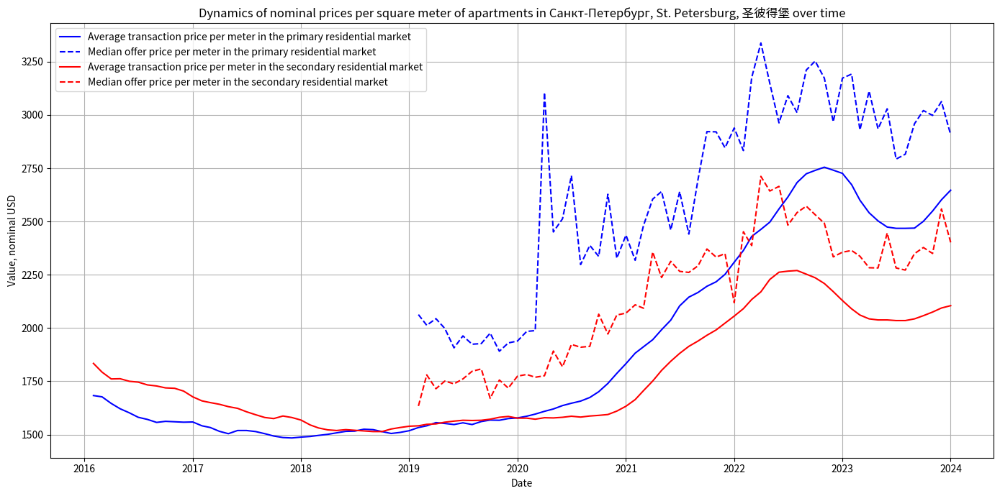

In [157]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Санкт-Петербург, St. Petersburg, 圣彼得堡')

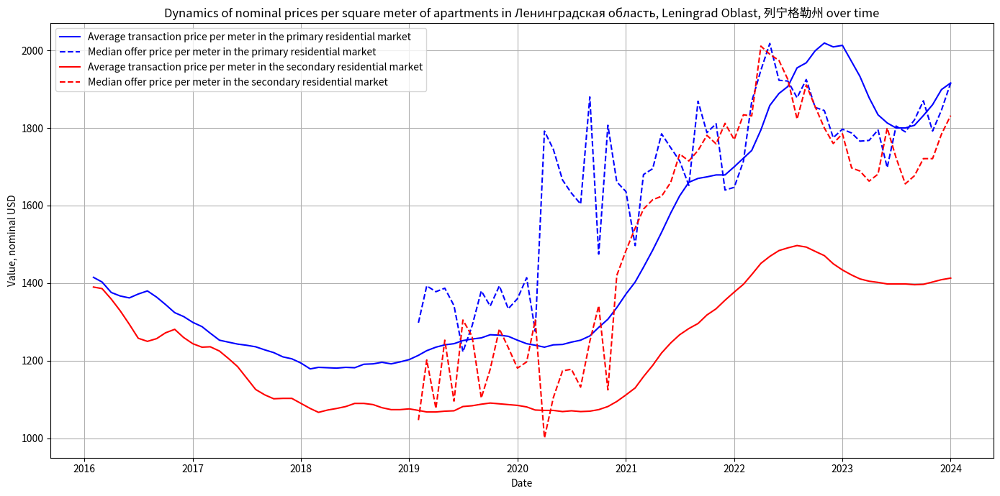

In [158]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Ленинградская область, Leningrad Oblast, 列宁格勒州')

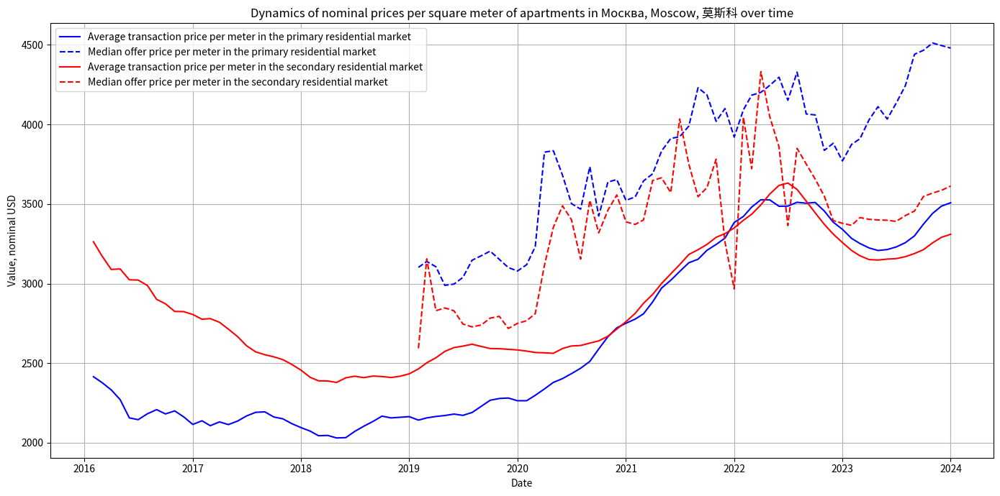

In [159]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Москва, Moscow, 莫斯科')

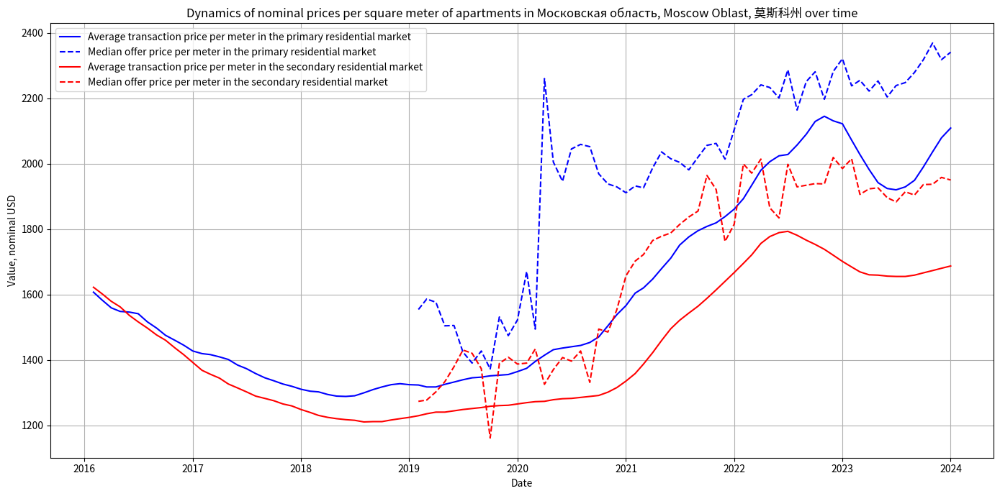

In [160]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Московская область, Moscow Oblast, 莫斯科州')

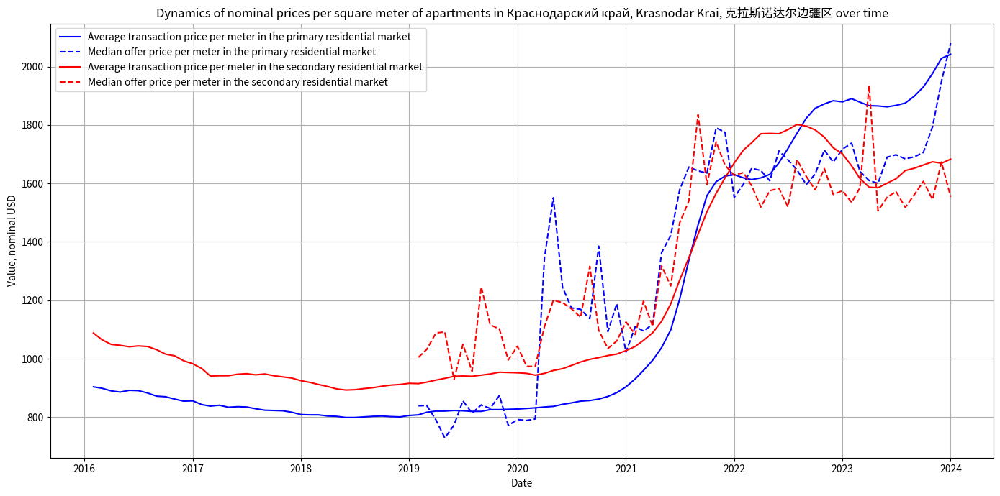

In [161]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [162]:
syv.save_nominal_usd_prices_plots(primary_deals_ts_usd,
                              primary_offers_ts_usd,
                              secondary_deals_ts_usd,
                              secondary_offers_ts_usd)

## 5.6 Analysis of real dollar price indicators.

#### 5.6.1 Processing of annual inflation rate data

World Bank data is used as a source of [data on inflation in the United States](https://databank.worldbank.org/source/world-development-indicators/Series/NY.GDP.DEFL.KD.ZG#).

In [163]:
annual_inflation_usd = syv.read_inflation_data_usa()

Let's perform data smoothing using the LOWESS method.

In [164]:
annual_inflation_usd_smoothed = syv.smooth_lowess(annual_inflation_usd, 'year', 'inflation', frac=0.3)

Let's plot dollar inflation on a linear scale.

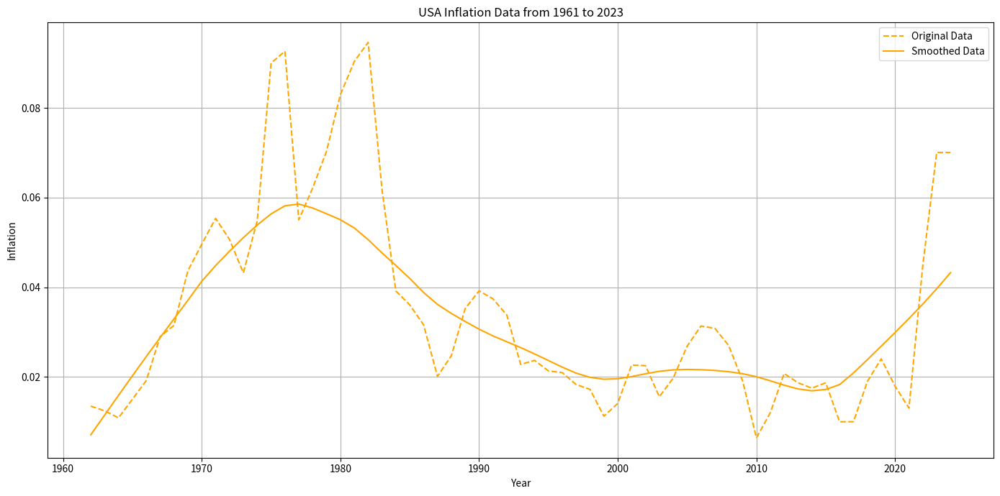

In [165]:
syv.plot_inflation_data(annual_inflation_usd, annual_inflation_usd_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="USA Inflation Data from 1961 to 2023",
                        start_date="1961-01-01",
                        end_date="2023-12-31",
                        yscale = 'linear')

Let's plot dollar inflation from 2002 to 2023 inclusive.

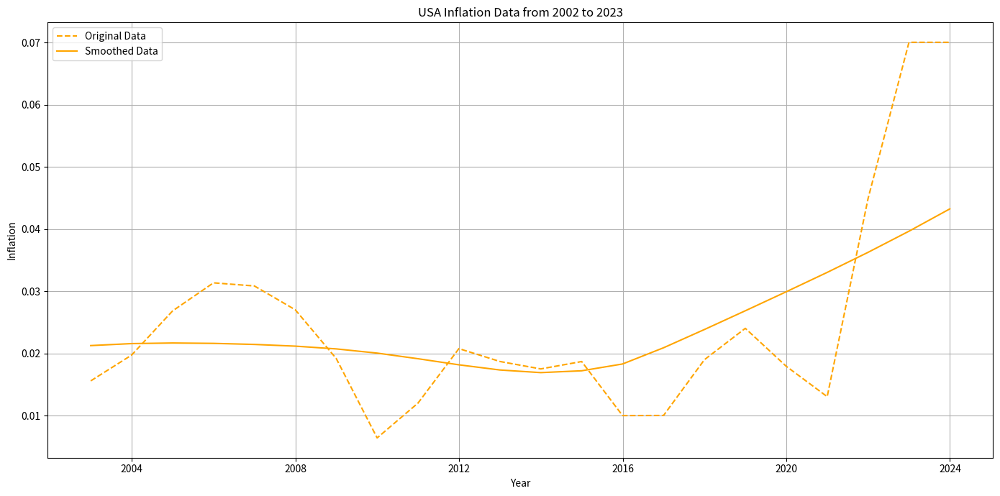

In [166]:
syv.plot_inflation_data(annual_inflation_usd, annual_inflation_usd_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="USA Inflation Data from 2002 to 2023",
                        start_date="2002-01-01",
                        end_date="2023-12-31",
                        yscale = 'linear')

Charts are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [167]:
# Plot inflation from 1961 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_usd, annual_inflation_usd_smoothed,
                        file_name='usa_annual_inflation_1961_2023_linear',
                        start_date="1961-01-01", end_date="2023-12-31", 
                        yscale='linear', title="U.S. inflation data from 1990 to 2023 (linear scale)")

# Plot inflation from 2002 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_usd, annual_inflation_usd_smoothed,
                        file_name='usa_annual_inflation_2002_2023_linear',
                        start_date="2002-01-01", end_date="2023-12-31", 
                        yscale='linear', title="U.S. inflation data from 2002 to 2023 (linear scale)")

#### 5.6.2 Monthly dollar inflation calculation

Let's calculate monthly dollar inflation rates.

In [168]:
monthly_inflation_usd = syv.calculate_monthly_inflation(annual_inflation_usd_smoothed,
                                                       inflation_column='smoothed_inflation')
monthly_inflation_usd = syv.filter_date_range(monthly_inflation_usd, start_date="2016-01", end_date="2023-12")
monthly_inflation_usd = syv.convert_date_to_month_year(monthly_inflation_usd)
monthly_inflation_usd = monthly_inflation_usd[0]
monthly_inflation_usd = monthly_inflation_usd.reset_index(drop=True)

Let's calculate the inflation indices relative to the base date 2020-01-01.

In [169]:
monthly_inflation_usd_relative = syv.calculate_relative_inflation(monthly_inflation_usd.copy())

#### 5.6.3 Calculation of real dollar prices for each region and month

Let's calculate the real dollar prices of deals and bids.

In [170]:
# Read data
primary_deals_ts_usd, primary_offers_ts_usd,\
secondary_deals_ts_usd, secondary_offers_ts_usd = syv.sort_dataframe_by_date(primary_deals_ts_usd,\
                                                            primary_offers_ts_usd,\
                                                            secondary_deals_ts_usd,\
                                                            secondary_offers_ts_usd)

# Set the appropriate date format
monthly_inflation_usd_relative['date'] = monthly_inflation_usd_relative['date'].dt.to_timestamp()
primary_deals_ts_usd['date'] = pd.to_datetime(primary_deals_ts_usd['date'])
primary_deals_ts_usd['date'] = primary_deals_ts_usd['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts_usd['date'] = pd.to_datetime(primary_offers_ts_usd['date'])
primary_offers_ts_usd['date'] = primary_offers_ts_usd['date'].dt.to_period('M').dt.to_timestamp()
secondary_deals_ts_usd['date'] = pd.to_datetime(secondary_deals_ts_usd['date'])
secondary_deals_ts_usd['date'] = secondary_deals_ts_usd['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts_usd['date'] = pd.to_datetime(primary_offers_ts_usd['date'])
primary_offers_ts_usd['date'] = primary_offers_ts_usd['date'].dt.to_period('M').dt.to_timestamp()

In [171]:
# Calculate real prices
primary_deals_real_usd, primary_offers_real_usd,\
secondary_deals_real_usd, secondary_offers_real_usd = \
    syv.calculate_real_prices(monthly_inflation_usd_relative, 
                              'cumulative_inflation',
                              primary_deals_ts_usd,
                              primary_offers_ts_usd,
                              secondary_deals_ts_usd,
                              secondary_offers_ts_usd,
                              value_column='value_usd')

In [172]:
# Round real prices
primary_deals_real_usd['value_usd_real'] = primary_deals_real_usd['value_usd_real'].round(0).astype(int)
primary_offers_real_usd['value_usd_real'] = primary_offers_real_usd['value_usd_real'].round(0).astype(int)
secondary_deals_real_usd['value_usd_real'] = secondary_deals_real_usd['value_usd_real'].round(0).astype(int)
secondary_offers_real_usd['value_usd_real'] = secondary_offers_real_usd['value_usd_real'].round(0).astype(int)

#### 5.6.4 Real dollar prices visualization

Let us chart the dynamics of real dollar prices for five key regions: St. Petersburg, Leningrad Oblast, Moscow, Moscow Oblast, Krasnodar Krai.

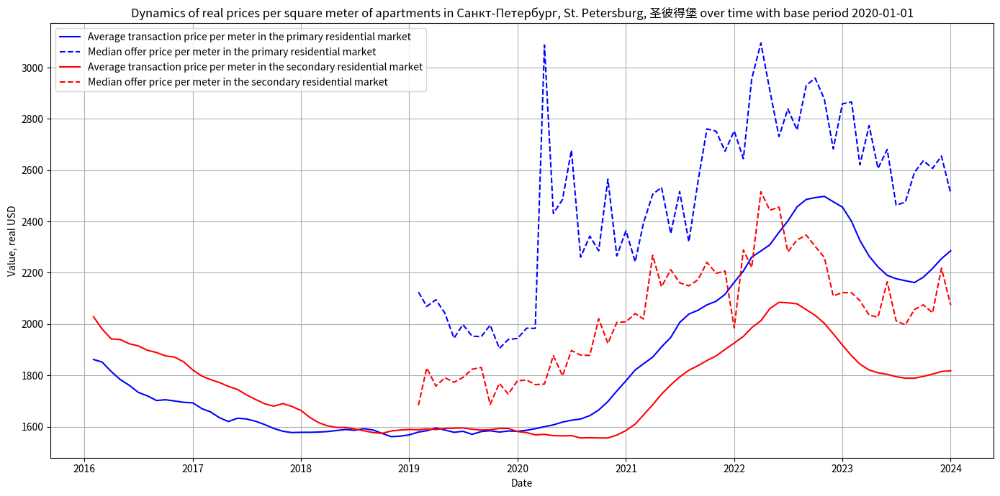

In [173]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Санкт-Петербург, St. Petersburg, 圣彼得堡')

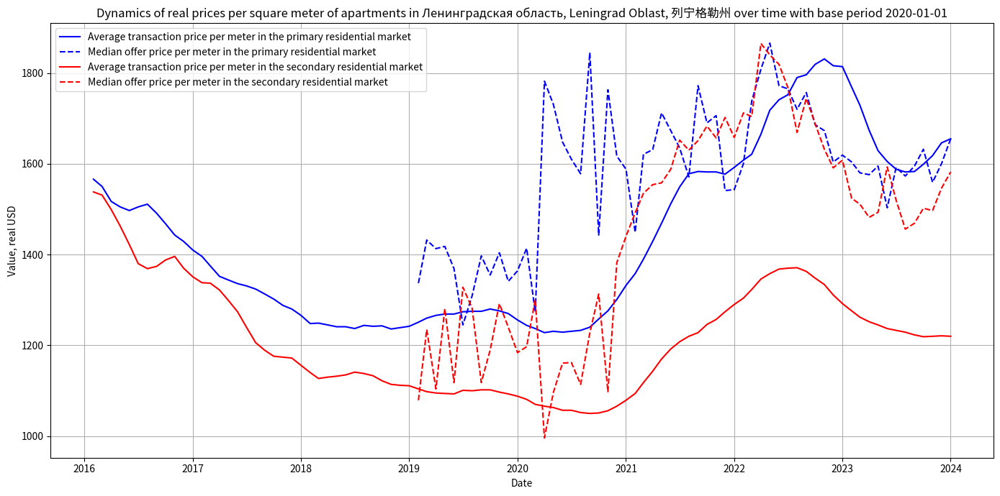

In [174]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Ленинградская область, Leningrad Oblast, 列宁格勒州')

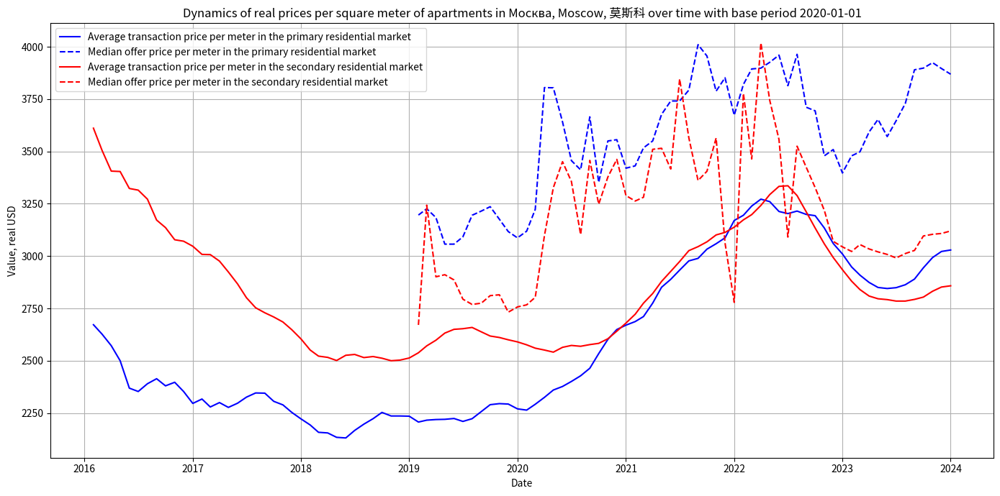

In [175]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Москва, Moscow, 莫斯科')

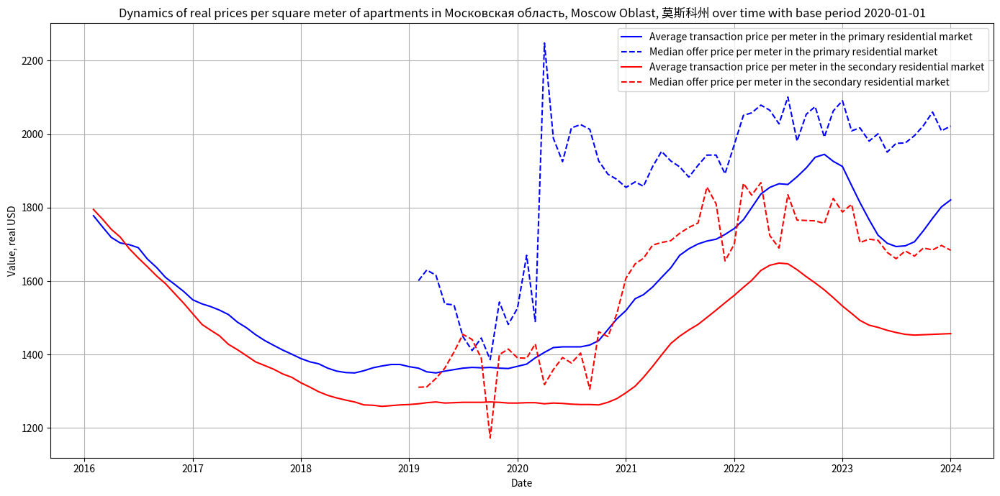

In [176]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Московская область, Moscow Oblast, 莫斯科州')

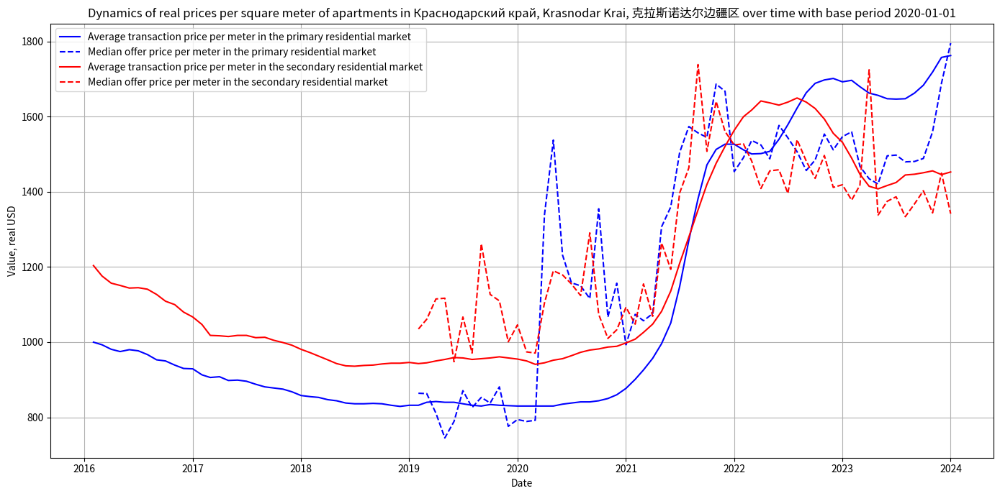

In [177]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Charts for all regions are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [178]:
syv.save_real_usd_prices_plots(primary_deals_real_usd,
                           primary_offers_real_usd,
                           secondary_deals_real_usd,
                           secondary_offers_real_usd)

## 5.7 Analysis of relative changes in price indicators in the regions of the Russian Federation

Let us consider the relative change in nominal ruble prices of transactions in the primary housing market in apartment buildings. For this purpose, we will plot a [scatterplot diagram](https://en.wikipedia.org/wiki/Scatter_plot) with the logarithms of values for January 2020 on the X-axis and January 2024 on the Y-axis. Each point represents a specific region. Its position on the diagram on the X-axis is determined by the value of the logarithm of the average transaction price in the primary market as of 2020-01-01. And its position on the Y-axis is determined by the value of the logarithm of the average transaction price in the primary market as of 2024-01-01. Next, a linear model describing the dependence of the price as of 2024-01-01 on the price as of 2020-01-01 was built. The simplest version of the model was used, using error squares (OLS) as a quality metric. The chart can be interpreted as follows: regions lying above the straight linear model are characterized by price growth above the general trend, and regions lying below the straight linear model are characterized by price growth below the general trend. The following are two diagrams: static and interactive, as well as the general characteristics of the linear model. 

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


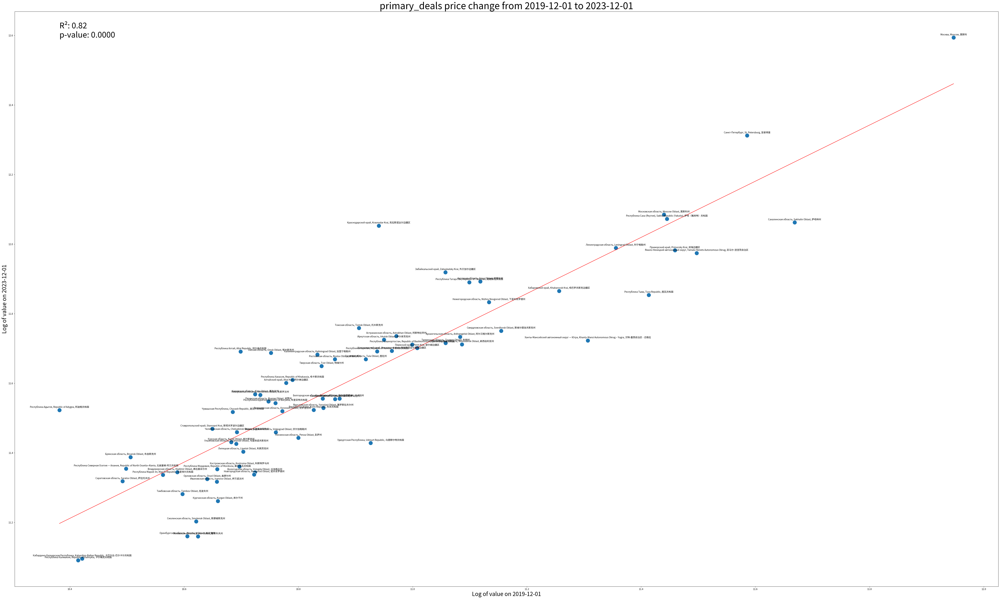

In [179]:
pds_model_summary = syv.plot_log_indicator_change(primary_deals_ts,
                                              'primary_deals', 'value', 'region', '2019-12-01', '2023-12-01')

In [180]:
print(pds_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.817
Model:                             OLS   Adj. R-squared:                  0.814
Method:                  Least Squares   F-statistic:                     316.1
Date:                 Sat, 23 Mar 2024   Prob (F-statistic):           7.43e-28
Time:                         21:50:08   Log-Likelihood:                 51.165
No. Observations:                   73   AIC:                            -98.33
Df Residuals:                       71   BIC:                            -93.75
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [181]:
pdi_model_summary = syv.plot_log_indicator_change_interactive(primary_deals_ts,
                                                      'primary_deals_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Similarly, consider the relative change in nominal ruble transaction prices in the secondary housing market in apartment buildings.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



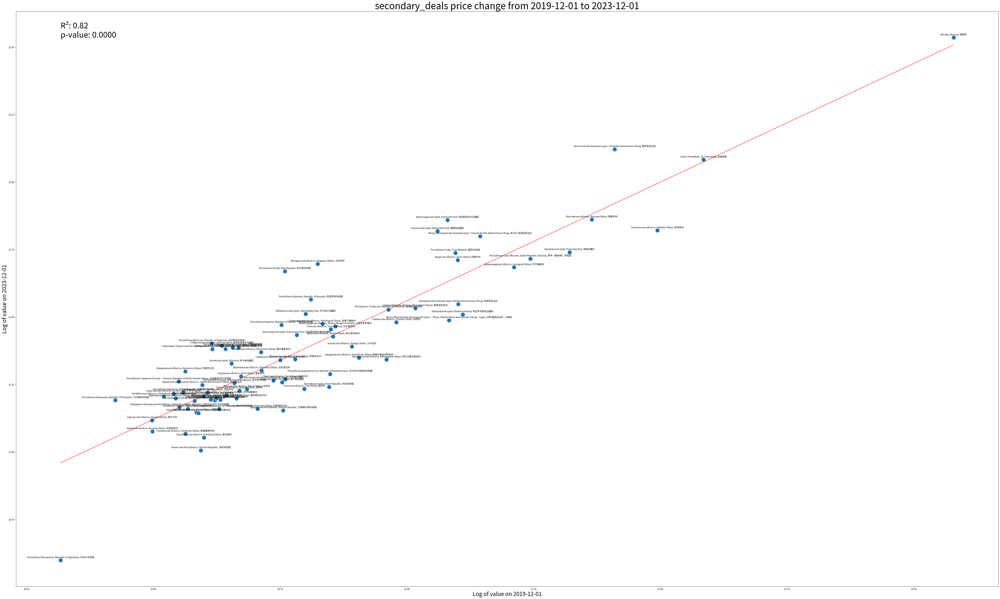

In [182]:
sds_model_summary = syv.plot_log_indicator_change(secondary_deals_ts,
                                              'secondary_deals',
                                                  'value',
                                                  'region',
                                                  '2019-12-01',
                                                  '2023-12-01')

In [183]:
print(sds_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.821
Model:                             OLS   Adj. R-squared:                  0.818
Method:                  Least Squares   F-statistic:                     370.8
Date:                 Sat, 23 Mar 2024   Prob (F-statistic):           5.72e-32
Time:                         21:50:14   Log-Likelihood:                 59.406
No. Observations:                   83   AIC:                            -114.8
Df Residuals:                       81   BIC:                            -110.0
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [184]:
sdi_model_summary = syv.plot_log_indicator_change_interactive(secondary_deals_ts,
                                                      'secondary_deals_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Similarly, let us consider the relative change in nominal ruble prices of offers on the primary housing market in apartment buildings.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



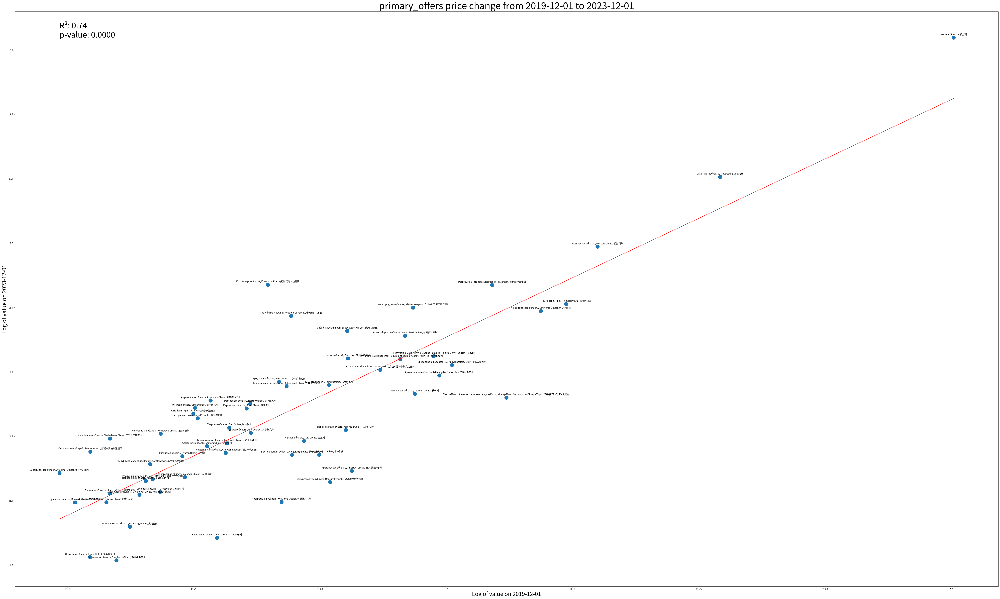

In [185]:
pos_model_summary = syv.plot_log_indicator_change(primary_offers_ts,
                                              'primary_offers', 'value', 'region', '2019-12-01', '2023-12-01')

In [186]:
print(pos_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.744
Model:                             OLS   Adj. R-squared:                  0.740
Method:                  Least Squares   F-statistic:                     162.9
Date:                 Sat, 23 Mar 2024   Prob (F-statistic):           3.24e-18
Time:                         21:50:18   Log-Likelihood:                 30.238
No. Observations:                   58   AIC:                            -56.48
Df Residuals:                       56   BIC:                            -52.36
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [187]:
poi_model_summary = syv.plot_log_indicator_change_interactive(primary_offers_ts,
                                                      'primary_offers_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Similarly, let us consider the relative change in nominal ruble prices of offers on the secondary housing market in apartment buildings.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



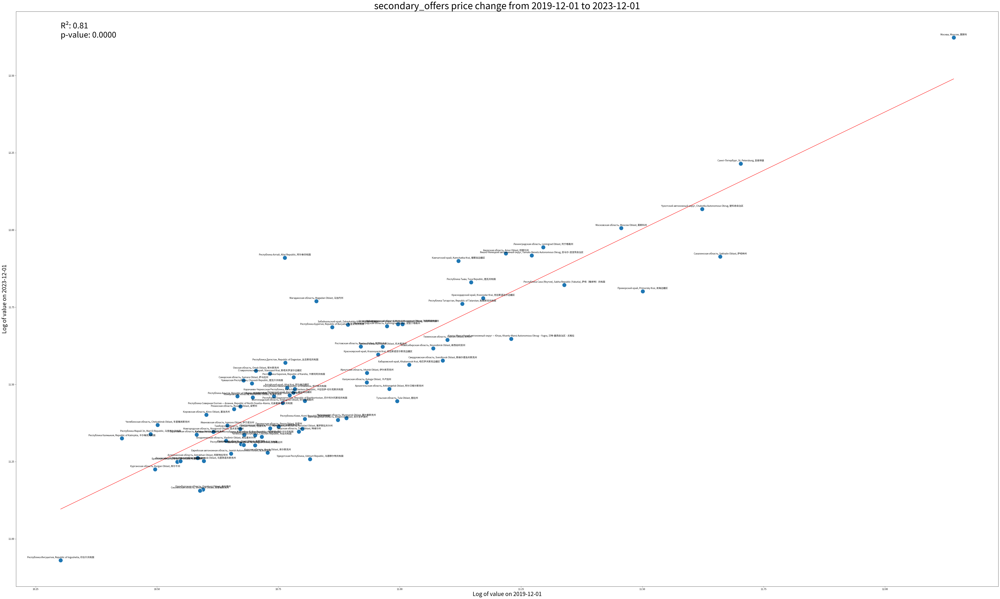

In [188]:
sos_model_summary = syv.plot_log_indicator_change(secondary_offers_ts,
                                              'secondary_offers', 'value', 'region', '2019-12-01', '2023-12-01')

In [189]:
print(sos_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.810
Model:                             OLS   Adj. R-squared:                  0.807
Method:                  Least Squares   F-statistic:                     344.3
Date:                 Sat, 23 Mar 2024   Prob (F-statistic):           6.63e-31
Time:                         21:50:22   Log-Likelihood:                 61.828
No. Observations:                   83   AIC:                            -119.7
Df Residuals:                       81   BIC:                            -114.8
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [190]:
soi_model_summary = syv.plot_log_indicator_change_interactive(secondary_offers_ts,
                                                      'secondary_offers_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Similarly, consider the relative change in bid volumes in the primary housing market for apartment buildings.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



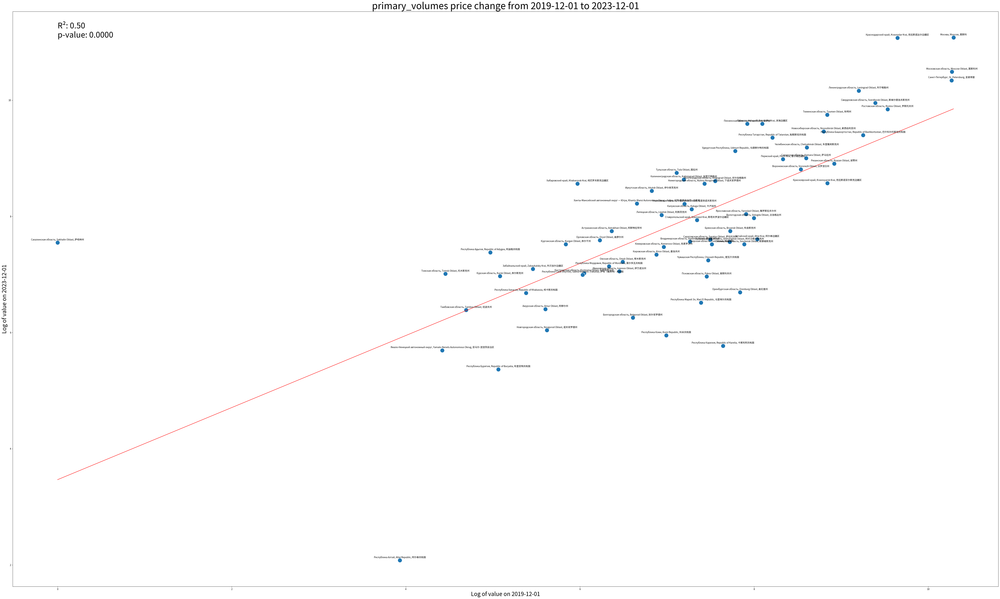

In [191]:
pvs_model_summary = syv.plot_log_indicator_change(primary_volumes_ts,
                                              'primary_volumes', 'value', 'region', '2019-12-01', '2023-12-01')

In [192]:
print(pvs_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.504
Model:                             OLS   Adj. R-squared:                  0.497
Method:                  Least Squares   F-statistic:                     68.09
Date:                 Sat, 23 Mar 2024   Prob (F-statistic):           8.47e-12
Time:                         21:50:28   Log-Likelihood:                -100.69
No. Observations:                   69   AIC:                             205.4
Df Residuals:                       67   BIC:                             209.8
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [193]:
pvi_model_summary = syv.plot_log_indicator_change_interactive(primary_volumes_ts,
                                                      'primary_volumes_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Similarly, consider the relative change in bid volumes in the secondary housing market for apartment buildings.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



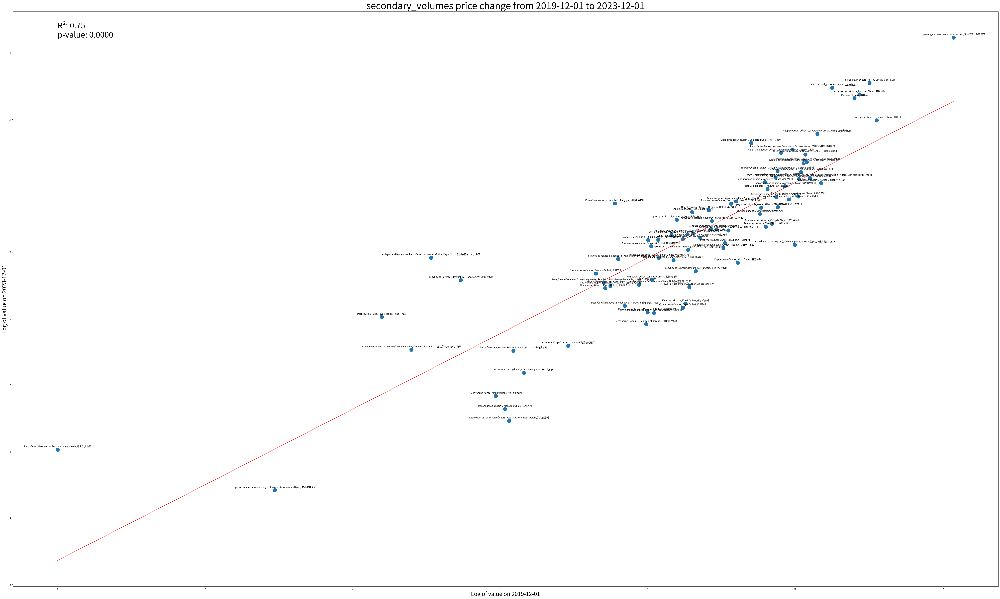

In [194]:
svs_model_summary = syv.plot_log_indicator_change(secondary_volumes_ts,
                                              'secondary_volumes', 'value', 'region', '2019-12-01', '2023-12-01')

In [195]:
print(svs_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.750
Model:                             OLS   Adj. R-squared:                  0.747
Method:                  Least Squares   F-statistic:                     240.4
Date:                 Sat, 23 Mar 2024   Prob (F-statistic):           8.08e-26
Time:                         21:50:33   Log-Likelihood:                -76.484
No. Observations:                   82   AIC:                             157.0
Df Residuals:                       80   BIC:                             161.8
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [196]:
svi_model_summary = syv.plot_log_indicator_change_interactive(secondary_volumes_ts,
                                                      'secondary_volumes_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

## 6 Housing affordability issues in the Russian Federation

As an indicator of housing affordability is used a simple ratio of the average cost of one square meter to the average salary according to Rosstat data. The formula for calculating the affordability index:

\begin{align}
A_{i} = \frac{\text{Mean Transaction Price per 1 Square Meter}}{\text{Mean Salary}}.
\end{align}

Thus, the specific value of the affordability index means the number of square meters that can be bought with one average salary in the region.

Let's harmonize regions names.

In [197]:
salaries_df = syv.read_salary_data()

Salary data loaded successfully.


In [198]:
salaries_df = syv.correct_region_names_with_hardcoded_mapping(salaries_df)

In [199]:
syv.check_region_name_mismatches(primary_deals_ts, secondary_deals_ts,
                             salaries_df, 'region', 'region')

All region names match between price and salary data frames.


In [200]:
salaries_df = syv.set_dates_to_month_end(salaries_df,'date')

We smooth the wage values to eliminate the seasonal component using the Holt-Winters' method and a moving average with a  window of 25.

In [201]:
seasonal_periods = 12 # Assuming monthly data and annual seasonality
salaries_df = syv.apply_holt_winters(salaries_df,
                                       'date', 'region', 'salary',
                                       seasonal_periods,
                                       smoothing_level=0.2,
                                       smoothing_trend=0.2,
                                       smoothing_seasonal=0.1)  # Adjust smoothing parameters as needed

In [202]:
salaries_df = syv.smooth_with_moving_average(
    df=salaries_df,
    date_col='date',
    value_col='smoothed_salary',
    region_col='region',
    window_size=25)  # Adjust window size as needed

### 6.1 Current state of housing affordability in the regions  of the Russian Federation

#### 6.1.1 Primary market 

Let's calculate the housing affordability index values for the period 2016-01 through 2023-12 for all regions represented in the analysis. 

In [203]:
affordability_index_primary_df = syv.calculate_affordability_index(
    price_df=primary_deals_ts, 
    salary_df=salaries_df, 
    price_col='value', 
    salary_col='smoothed_salary_avg'
)

# Display the first few rows of the resulting DataFrame
print(affordability_index_primary_df.head())

                                              region     date  value  \
0      Забайкальский край, Zabaykalsky Krai, 外贝加尔边疆区  2016-01  49890   
1             Самарская область, Samara Oblast, 萨马拉州  2016-01  45176   
2              Рязанская область, Ryazan Oblast, 梁赞州  2016-01  38007   
3           Ростовская область, Rostov Oblast, 罗斯托夫州  2016-01  46371   
4  Республика Хакасия, Republic of Khakassia, 哈卡斯共和国  2016-01  42061   

   smoothed_salary_avg  affordability_index  
0         31609.674333             0.633587  
1         27948.174145             0.618651  
2         26350.949816             0.693318  
3         25486.811410             0.549628  
4         31161.170319             0.740857  


Let's create a separate dataset for the current month of analysis.

In [204]:
# Create a separate data frame for specific month
affordability_index_primary_df_dec_2023 = affordability_index_primary_df[affordability_index_primary_df['date'] == '2023-12']
affordability_index_primary_df_dec_2023 = affordability_index_primary_df_dec_2023.rename(columns={'value': 'primary_market_price'})
affordability_index_primary_df_dec_2023 = affordability_index_primary_df_dec_2023.rename(columns={'affordability_index': 'affordability_index_primary'})
# Display the filtered DataFrame for December 2023
affordability_index_primary_df_dec_2023

,region,date,primary_market_price,smoothed_salary_avg,affordability_index_primary
7114,"Самарская область, Samara Oblast, 萨马拉州",2023-12,104264,55175.596095,0.529191
7115,"Рязанская область, Ryazan Oblast, 梁赞州",2023-12,103529,52277.922916,0.504959
7116,"Ростовская область, Rostov Oblast, 罗斯托夫州",2023-12,116917,52251.363863,0.446910
7117,"Республика Хакасия, Republic of Khakassia, 哈卡斯共和国",2023-12,110172,45841.215984,0.416088
7118,"Республика Тыва, Tuva Republic, 图瓦共和国",2023-12,140615,61784.408724,0.439387
7119,"Республика Татарстан, Republic of Tatarstan, 鞑...",2023-12,145831,61045.048986,0.418601
7120,"Республика Северная Осетия — Алания, Republic ...",2023-12,85356,41388.463153,0.484892
7121,"Республика Коми, Komi Republic, 科米共和国",2023-12,101055,77396.157076,0.765882
7122,"Республика Мордовия, Republic of Mordovia, 莫尔多...",2023-12,85242,45758.392157,0.536806
7123,"Республика Марий Эл, Mari El Republic, 马里埃尔共和国",2023-12,83830,47629.363332,0.568166


Graphically show the relationship between average wages and average prices for 1 sq. m. in the primary market. Let us calculate the correlation coefficients between these indicators and their corresponding p-values. The scatter diagram can be interpreted as follows: the regions located above the red zone are characterized by prices that are ahead of their residents in terms of income. Regions located below the red zone, on the contrary, are characterized by wages that make it relatively easy to buy housing. Regions within the red zone have balanced income and price indicators. As can be seen from the diagram, low housing affordability is characteristic, in particular, of the largest agglomerations (St. Petersburg, Moscow, Krasnodar), which attract many residents of other regions of Russia and other territories with their high standards of living. High housing affordability is characteristic, among others, of oil and gas provinces (Tyumen Oblast, Yamalo-Nenets Autonomous District, Komi Republic, etc.), which provide a high level of income for employees employed in this and related sectors of the economy. At the same time, these regions are characterized by a harsh climate, low level of services (except for Tyumen city itself) and are often not considered as a place of permanent residence.

This analysis shows a significant positive correlation between incomes and prices in the regions.


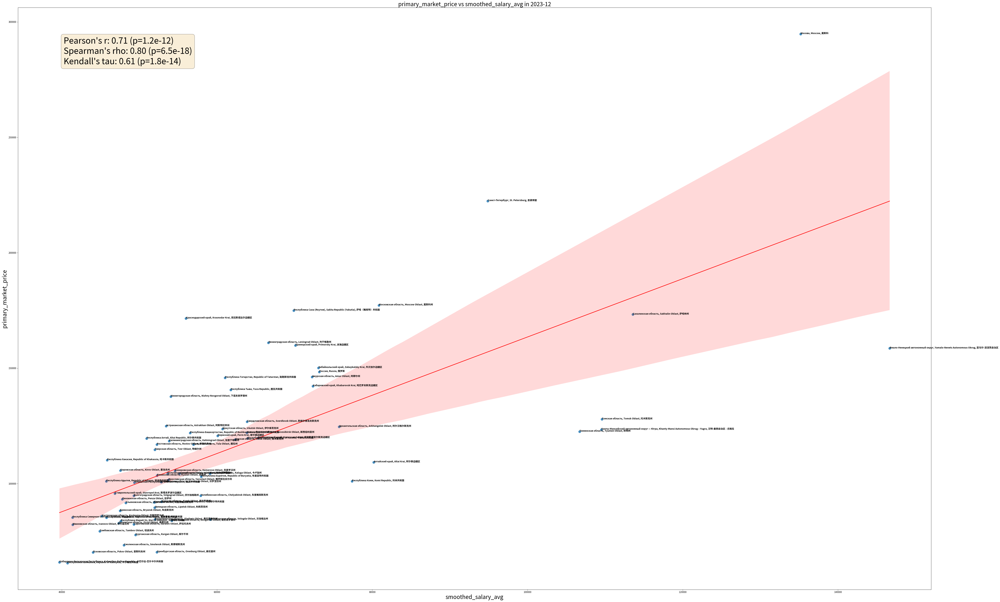

In [205]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_primary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='primary_market_price',
    date_col='date',
    region_col='region'
)

Let us graphically analyze the relationship between income and housing affordability in the regions. The diagram shows that most regions are characterized by a negative relationship between income and housing affordability. The final positive values of correlation coefficients are due to only a few oil-bearing regions. The overall model is statistically insignificant and serves only for graphical analysis.


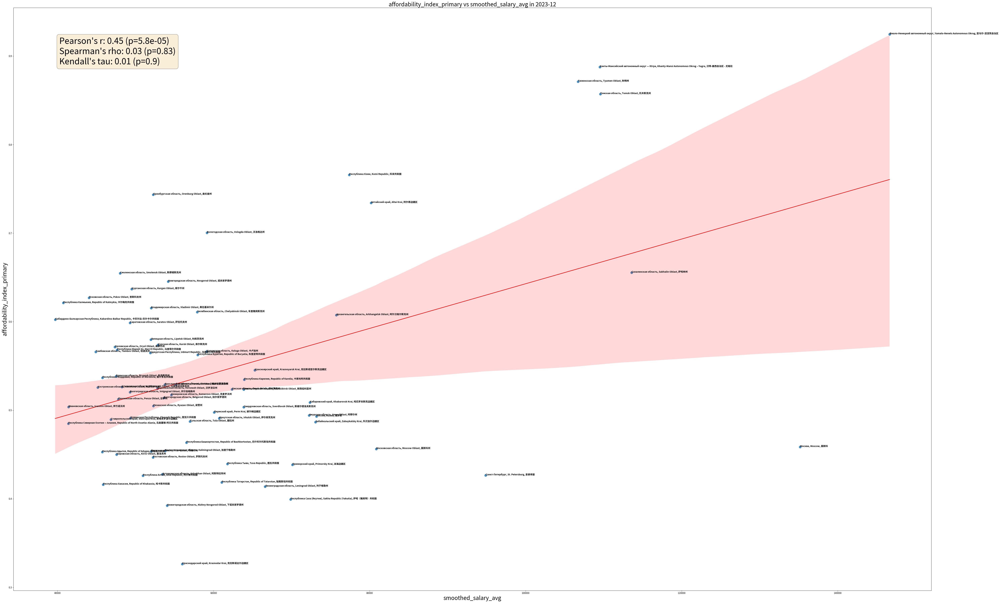

In [206]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_primary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='affordability_index_primary',
    date_col='date',
    region_col='region'
)

Let us graphically analyze the relationship between prices and housing affordability in the regions. As can be seen, there is a moderate statistically significant negative relationship between prices and affordability. The diagram can be interpreted as follows: regions located above the red zone have a relatively high level of affordability, those located below - low, those located inside it have a balanced ratio of price and affordability.

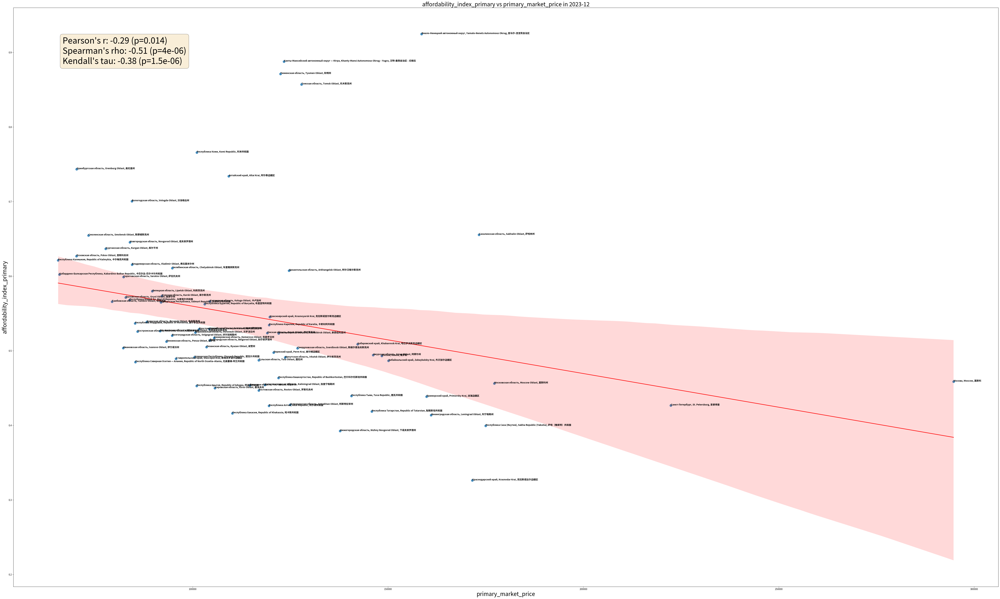

In [207]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_primary_df_dec_2023,
    x_col='primary_market_price',
    y_col='affordability_index_primary',
    date_col='date',
    region_col='region')

Let's run a check on the region names in the housing affordability data and geodata.

In [208]:
syv.check_region_name_matching(df1=affordability_index_primary_df_dec_2023,
                               df2=shifted_gdf,
                               region_col='region')

Regions in the affordability data frame but not in the GeoJSON: {'Россия, Russia, 俄罗斯'}
Regions in the GeoJSON but not in the affordability data frame: {'Ненецкий автономный округ, Nenets Autonomous Okrug, 涅涅茨自治区', 'Камчатский край, Kamchatka Krai, 堪察加边疆区', 'Республика Дагестан, Republic of Dagestan, 达吉斯坦共和国', 'Карачаево-Черкесская Республика, Karachay-Cherkess Republic, 卡拉恰伊-切尔克斯共和国', 'Чеченская Республика, Chechen Republic, 车臣共和国', 'Чукотский автономный округ, Chukotka Autonomous Okrug, 楚科奇自治区', 'Еврейская автономная область, Jewish Autonomous Oblast, 犹太自治州', 'Республика Ингушетия, Republic of Ingushetia, 印古什共和国', 'Магаданская область, Magadan Oblast, 马加丹州', 'Мурманская область, Murmansk Oblast, 摩尔曼斯克州'}


Plot and save a static map of housing affordability by region. Lighter colors mean low affordability, darker colors mean higher affordability.

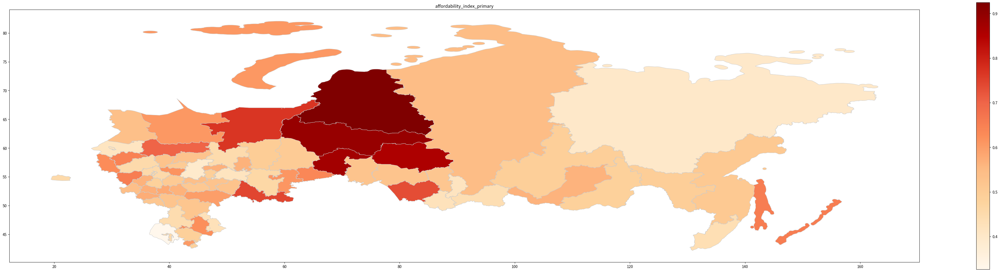

In [209]:
syv.create_and_display_heatmaps_sberindex(
    data=affordability_index_primary_df_dec_2023,
    column_name='affordability_index_primary',
    display_name='affordability_index_primary',
    filename='affordability_index_primary',
    geo_dataframe=shifted_gdf
)

Create and save an interactive accessibility map on the OSM map base.

In [210]:
syv.create_and_save_choropleth_sberindex(
    data=affordability_index_primary_df_dec_2023,
    column_name='affordability_index_primary',
    display_name='Affordability Index for December 2023',
    geo_dataframe=shifted_gdf,
    dataset_name='affordability_index_primary'
)

#### 6.1.2  Secondary market

Let's calculate the housing affordability index values for the period 2016-01 through 2023-12 for all regions represented in the analysis. 

In [211]:
affordability_index_secondary_df = syv.calculate_affordability_index(
    price_df=secondary_deals_ts, 
    salary_df=salaries_df, 
    price_col='value', 
    salary_col='smoothed_salary_avg'
)

Let's create a separate dataset for the current month of analysis.

In [212]:
# Create a separate data frame for specific month
affordability_index_secondary_df_dec_2023 = affordability_index_secondary_df[affordability_index_secondary_df['date'] == '2023-12']
affordability_index_secondary_df_dec_2023 = affordability_index_secondary_df_dec_2023.rename(
    columns={'value': 'secondary_market_price'}
)
affordability_index_secondary_df_dec_2023 = affordability_index_secondary_df_dec_2023.rename(
    columns={'affordability_index': 'affordability_index_secondary'}
)

Let us graphically show the relationship between average wages and average prices for 1 sq. m. in the secondary market. Let us calculate the correlation coefficients between these indicators and their corresponding p-values. The scatter diagram can be interpreted as follows: the regions located above the red zone are characterized by prices that outpace the income opportunities of their residents. Regions located below the red zone, on the contrary, are characterized by wages that make it relatively easy to buy housing. Regions located inside the red zone have balanced income and price indicators. As can be seen from the diagram, low housing affordability is characteristic, in particular, of the largest agglomerations (St. Petersburg, Moscow, Krasnodar), which attract many residents of other regions of Russia and other territories with their high standards of living. High housing affordability is characteristic, among other things, of oil and gas provinces (Tyumen Region, NAO, Khanty-Mansi Autonomous Okrug, etc.), which provide a high level of income for employees employed in this and related sectors of the economy. At the same time, these regions are characterized by harsh climate, low level of services (except for Tyumen city itself) and are often not considered as a place of permanent residence.

This analysis shows a significant positive correlation between incomes and prices in the regions.


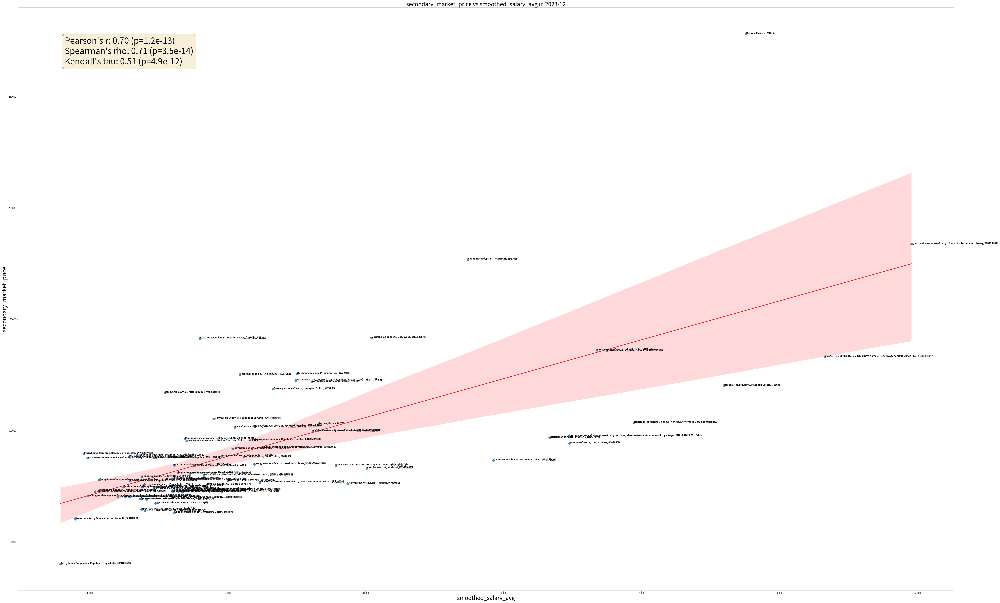

In [213]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_secondary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='secondary_market_price',
    date_col='date',
    region_col='region'
)

Let us graphically analyze the relationship between income and housing affordability in the regions. The diagram shows that most regions are characterized by a contradictory relationship between income and housing affordability. The final positive values of correlation coefficients are due to the presence of a number of oil and gas bearing regions. The general model is statistically significant and can be used with caution.

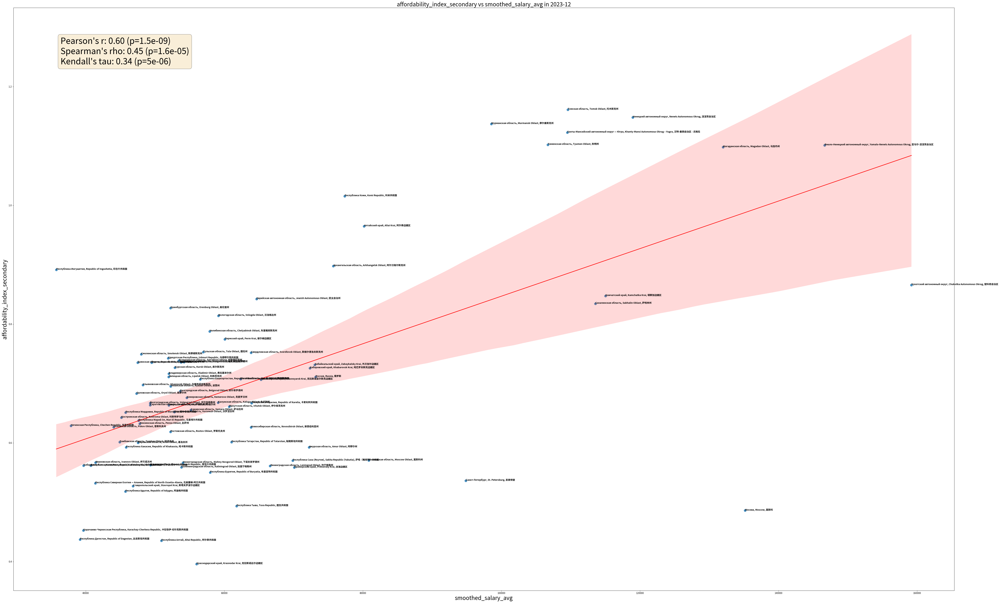

In [214]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_secondary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='affordability_index_secondary',
    date_col='date',
    region_col='region'
)

Let us graphically analyze the relationship between prices and housing affordability in the regions. As can be seen, there is a small statistically insignificant negative relationship between prices and affordability. The diagram can be interpreted as follows: regions located above the red zone have a relatively high level of affordability, those located below &mdash; low, those located inside it have a balanced ratio of price and affordability. The model is statistically insignificant and cannot be directly used for analysis. 

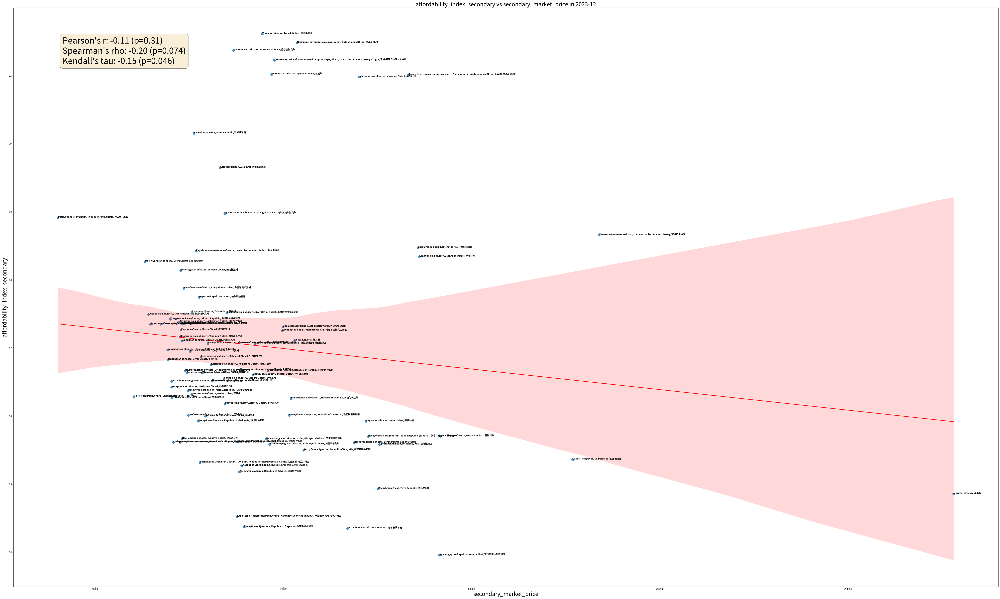

In [215]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_secondary_df_dec_2023,
    x_col='secondary_market_price',
    y_col='affordability_index_secondary',
    date_col='date',
    region_col='region'
)

Plot and save a static map of housing affordability by region. Lighter colors mean low affordability, darker colors mean higher affordability.

In [216]:
syv.check_region_name_matching(
    df1=affordability_index_secondary_df_dec_2023,
    df2=shifted_gdf,
    region_col='region')

Regions in the affordability data frame but not in the GeoJSON: {'Россия, Russia, 俄罗斯'}
All regions in the second data frame are also in the first data frame.


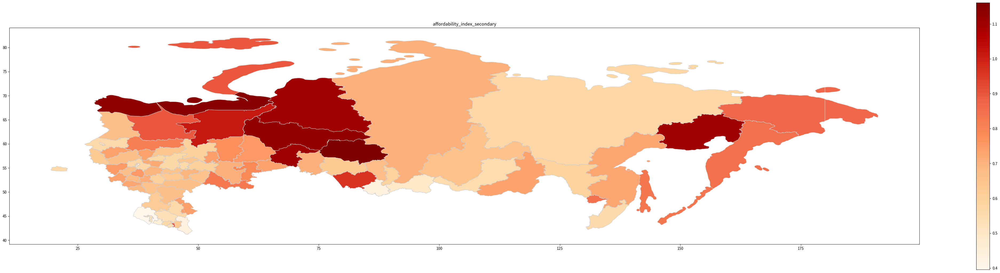

In [217]:
syv.create_and_display_heatmaps_sberindex(
    data=affordability_index_secondary_df_dec_2023,
    column_name='affordability_index_secondary',
    display_name='affordability_index_secondary',
    filename='affordability_index_secondary',
    geo_dataframe=shifted_gdf
)

Create and save an interactive accessibility map on the OSM map base.

In [218]:
syv.create_and_save_choropleth_sberindex(
    data=affordability_index_primary_df_dec_2023,
    column_name='affordability_index_primary',
    display_name='Affordability Index for December 2023',
    geo_dataframe=shifted_gdf,
    dataset_name='affordability_index_primary'
)

### 6.2 Dynamics of Affordability

Let us consider the dynamics of primary housing affordability by region. For this purpose, we will plot a scatterplot diagram, along the X-axis of which we will postpone the values of the affordability index as of 2020-01-01, along the Y-axis &mdash; as of 2024-01-01. We also design a linear model in which the predictor is the value of the accessibility index as of 2020-01-01, and the response is the value of the on 2024-01-01. Let's add a linear trend to the graph.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



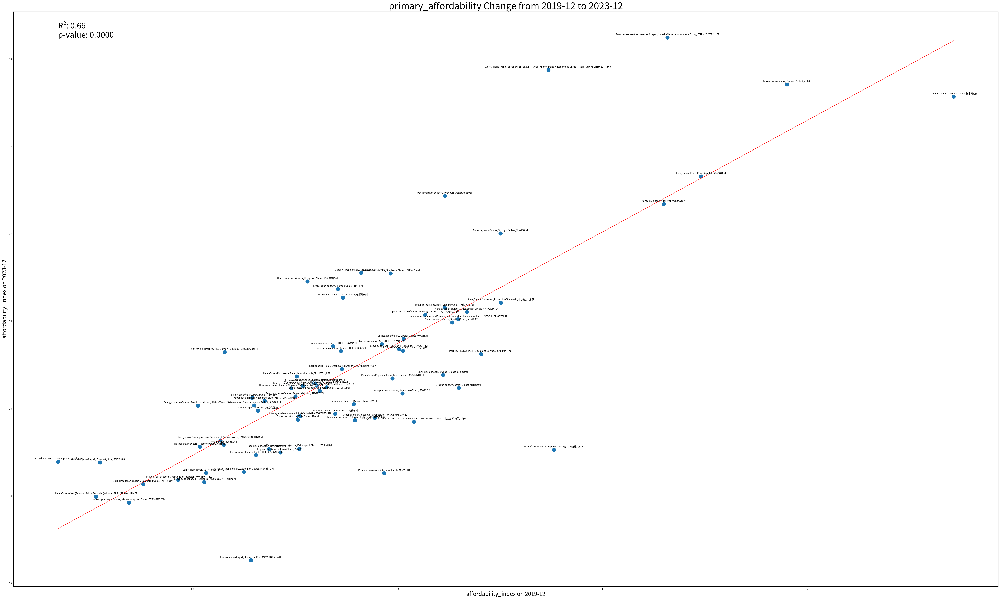

In [219]:
primary_affordability_model_summary = syv.plot_indicator_change(
    affordability_index_primary_df,
    'primary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12')

Let's give general information about the linear model. The main metrics: R-square, p-value for the predictor, values of the Durbin-Watson criterion, skewness, and kurtosis coefficients indicate the significance of the model.

In [220]:
print(primary_affordability_model_summary)

                            OLS Regression Results                            
Dep. Variable:                2023-12   R-squared:                       0.659
Model:                            OLS   Adj. R-squared:                  0.654
Method:                 Least Squares   F-statistic:                     137.0
Date:                Sat, 23 Mar 2024   Prob (F-statistic):           3.09e-18
Time:                        21:52:46   Log-Likelihood:                 92.196
No. Observations:                  73   AIC:                            -180.4
Df Residuals:                      71   BIC:                            -175.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0639      0.042      1.521      0.1

Let's create a similar interactive scatter plot.

In [221]:
pai_model_summary = syv.plot_indicator_change_interactive(
    affordability_index_primary_df,
    'primary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12'
)

Let us consider the dynamics of secondary housing affordability by region. For this purpose, we will plot a scatterplot diagram, along the X-axis of which we will postpone the values of the affordability index as of 2020-01-01, along the Y-axis — as of 2024-01-01. We also design a linear model in which the predictor is the value of the accessibility index as of 2020-01-01, and the response is the value of the on 2024-01-01. Let's add a linear trend to the graph. 

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



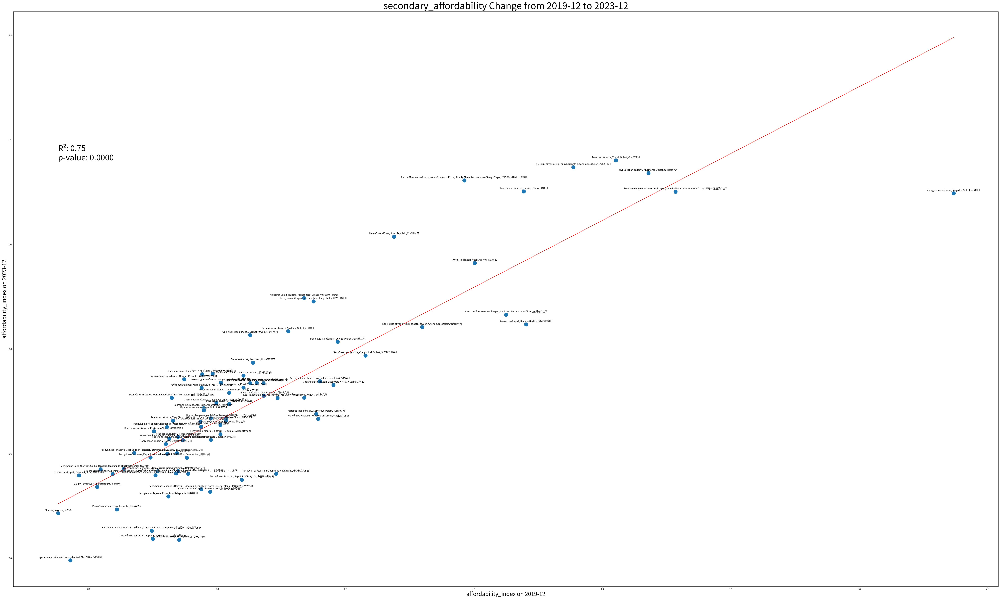

In [222]:
secondary_affordability_model_summary = syv.plot_indicator_change(
    affordability_index_secondary_df,
    'secondary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12')

Let's give general information about the linear model. The main metrics: R-square, p-value for the predictor, values of the Durbin-Watson criterion, skewness, and kurtosis coefficients indicate the significance of the model.

In [223]:
print(secondary_affordability_model_summary)

                            OLS Regression Results                            
Dep. Variable:                2023-12   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     244.6
Date:                Sat, 23 Mar 2024   Prob (F-statistic):           3.46e-26
Time:                        21:52:58   Log-Likelihood:                 85.878
No. Observations:                  83   AIC:                            -167.8
Df Residuals:                      81   BIC:                            -162.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.1512      0.037      4.130      0.0

Let's create a similar interactive scatter plot.

In [224]:
sai_model_summary = syv.plot_indicator_change_interactive(
    affordability_index_secondary_df,
    'secondary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12'
)

Let us plot the dynamics of housing affordability in five key regions: St. Petersburg, Leningrad Region, Moscow, Moscow Region, Krasnodar Krai.

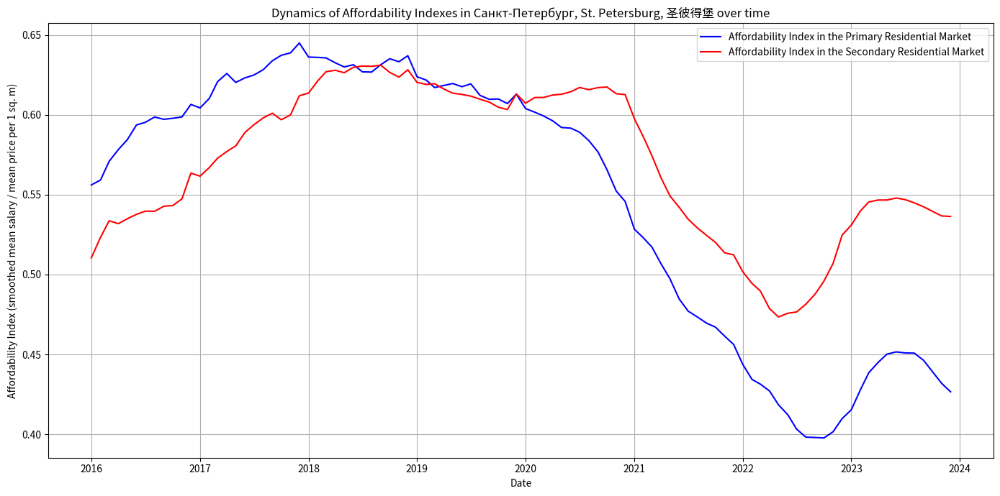

In [225]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Санкт-Петербург, St. Petersburg, 圣彼得堡')

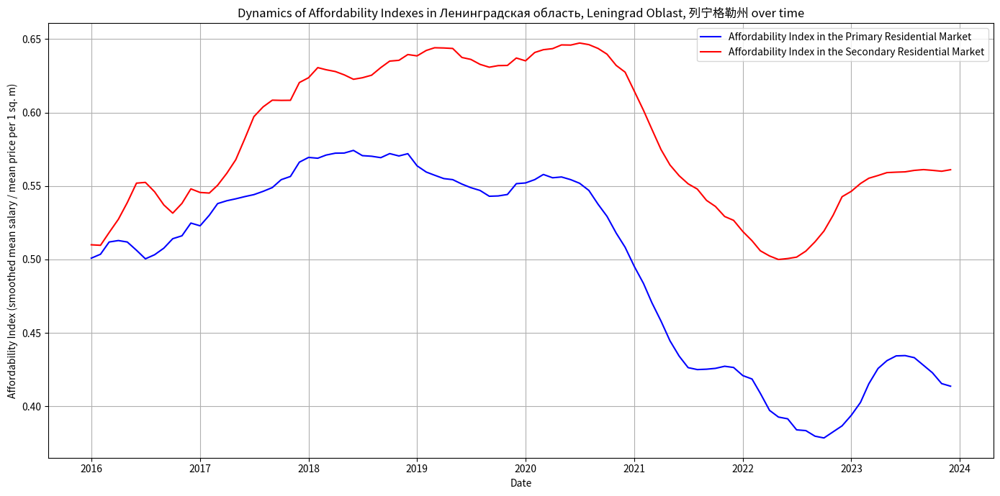

In [226]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Ленинградская область, Leningrad Oblast, 列宁格勒州')

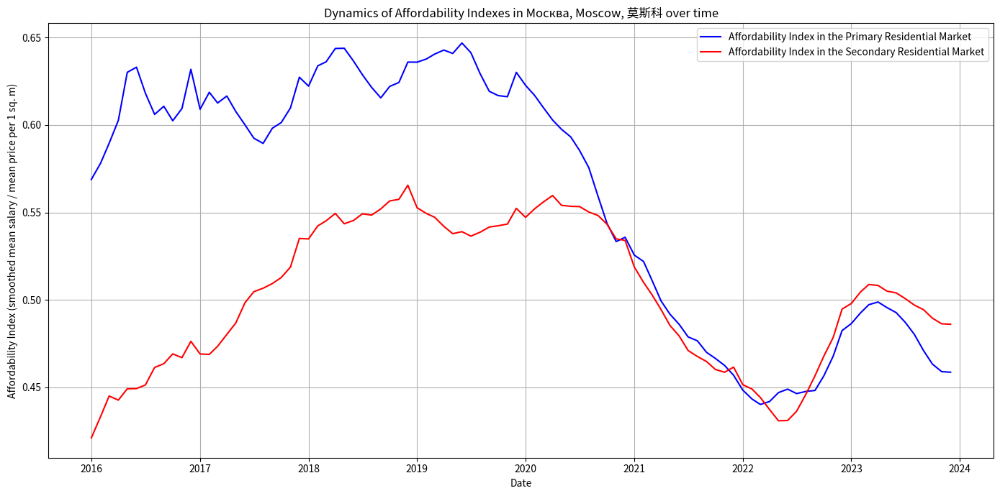

In [227]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Москва, Moscow, 莫斯科')

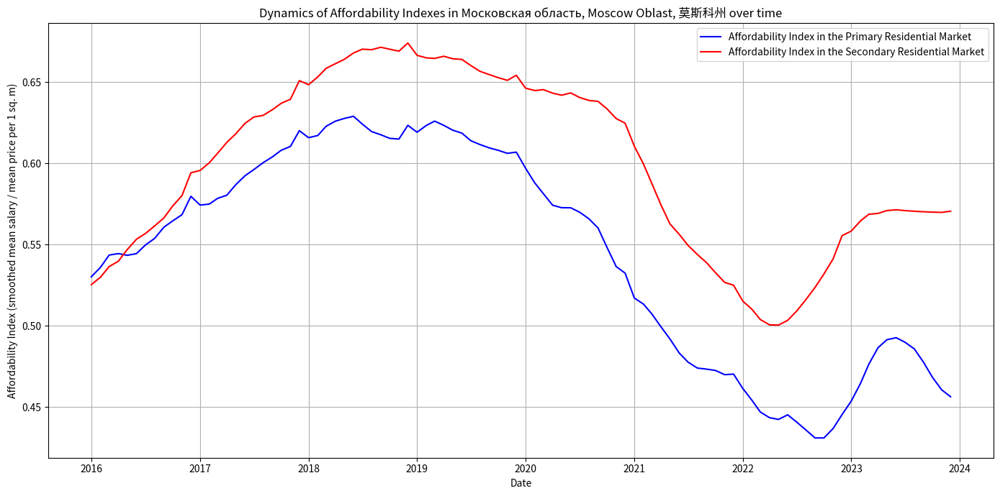

In [228]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Московская область, Moscow Oblast, 莫斯科州')

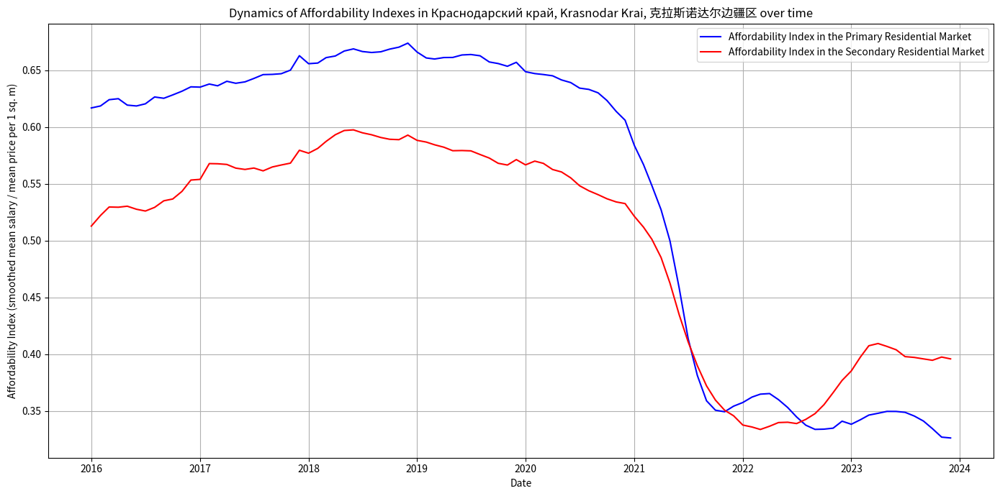

In [229]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Save charts for all regions. They are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [230]:
syv.save_affordability_indicators_charts(
    affordability_index_primary_df,
    affordability_index_secondary_df
)

'Charts saved successfully'

## 7 Macroeconomic indicators

Let us analyze the relationship between macroeconomic indicators: monetary aggregates (M2 and Broad Money), Key Rate and real ruble prices.

### 7.1 Relationship between monetary aggregates and real prices

Read the data on the size of monetary aggregates.

In [231]:
aggregates_df = syv.read_monetary_aggregates()
aggregates_df = syv.adjust_dates_and_offset_aggregates_by_day(aggregates_df)
aggregates_df = aggregates_df[aggregates_df['date'] >= '2016-01-31']

Monetary Aggregates Data loaded successfully.


Merge the two tables into one using the merge() method and set the keys for the merge on the 'region' and 'date' columns:

In [232]:
merged_primary_secondary_df = syv.merge_primary_secondary_with_end_of_month_dates(
    primary_deals_real,
    secondary_deals_real
)
merged_primary_secondary_df.drop(['date_primary', 'date_secondary'], axis=1, inplace=True) # Drop unnecessary columns

Combine the data on prices and monetary aggregates. Sort them by date. Save the result to the merged_primary_secondary_df object.

In [233]:
merged_agg_primary_secondary_df = syv.merge_price_with_aggregates(
    merged_primary_secondary_df,
    aggregates_df=aggregates_df,
    prices_date_col='month_end_date',
    aggregates_date_col='date'
)

Plot scatter diagrams for key regions, as well as for Russia as a whole. The abscissa axis presents data on the value of the monetary aggregate. On the axis of ordinates are data on real prices of primary and secondary markets.

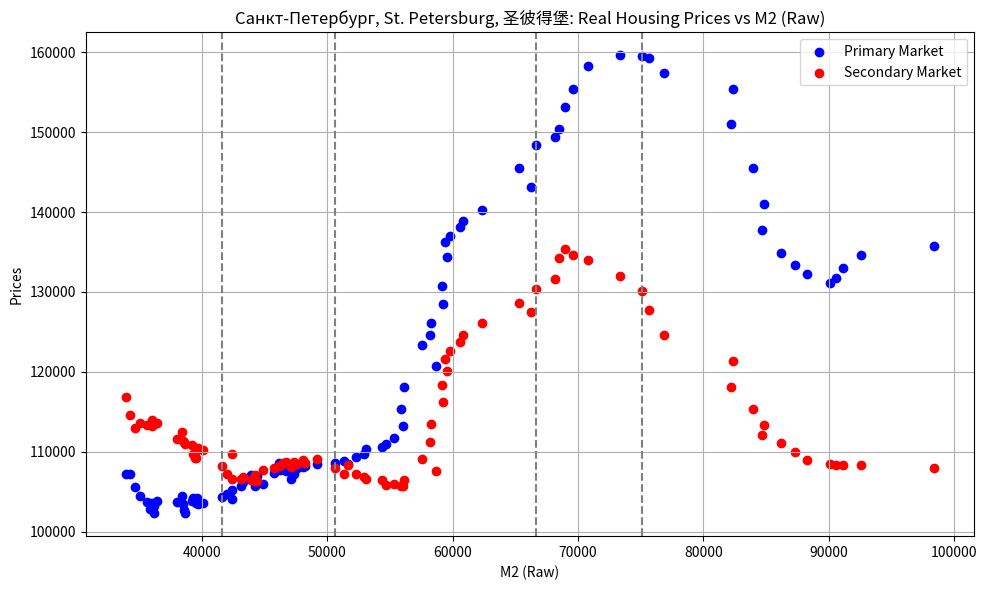

In [234]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

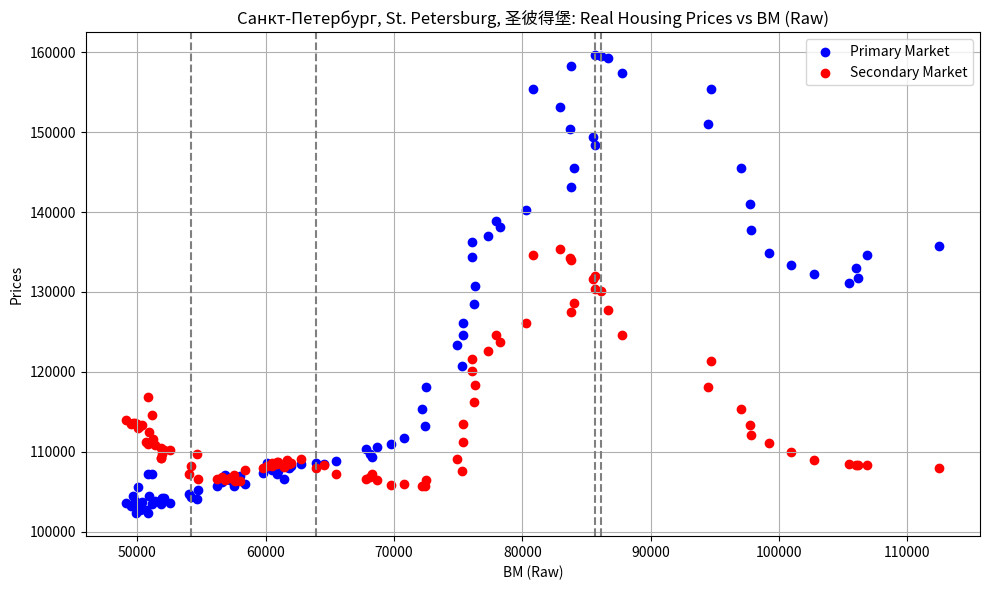

In [235]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='BM',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

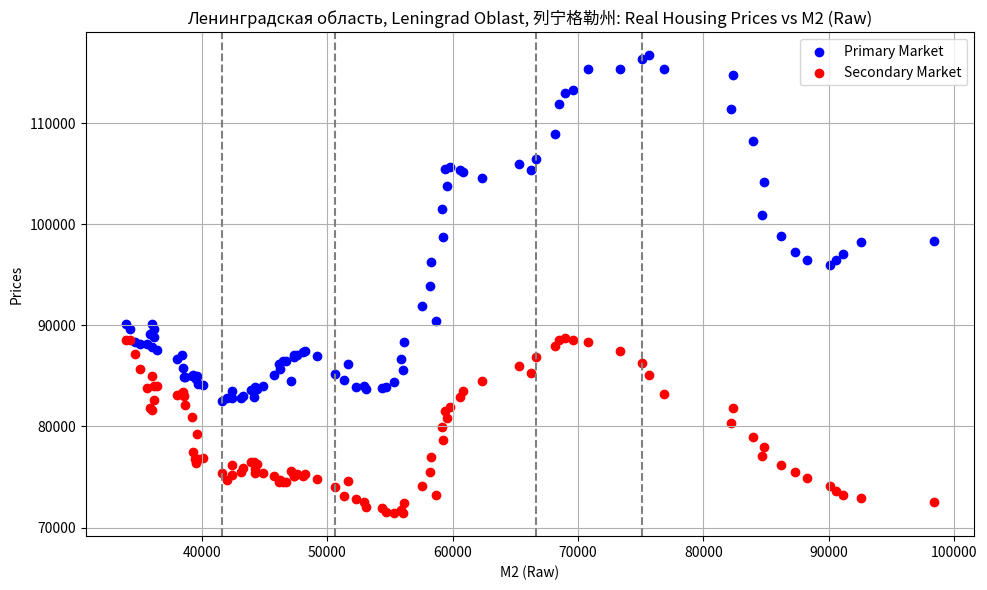

In [236]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

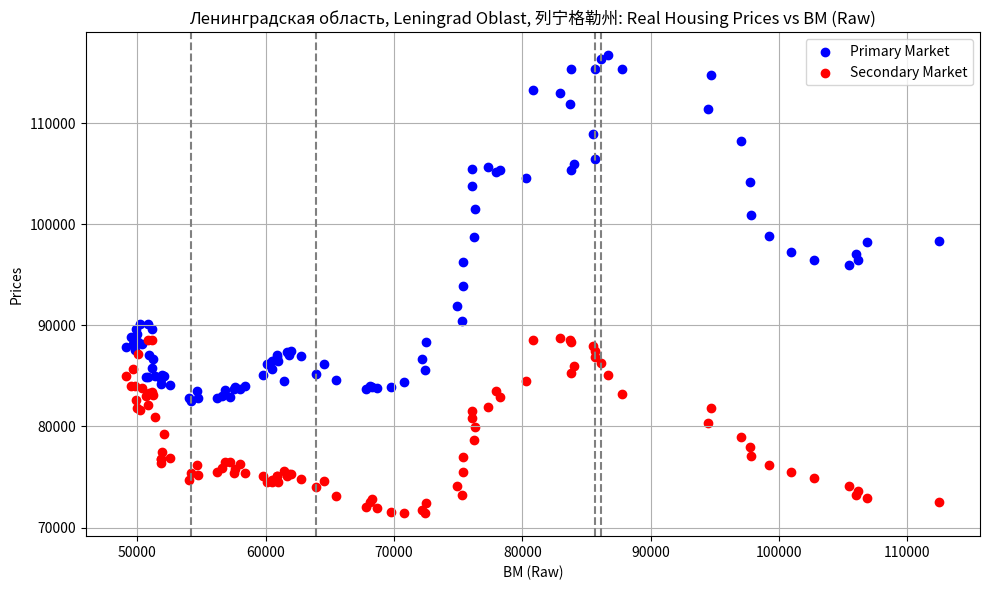

In [237]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='BM',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

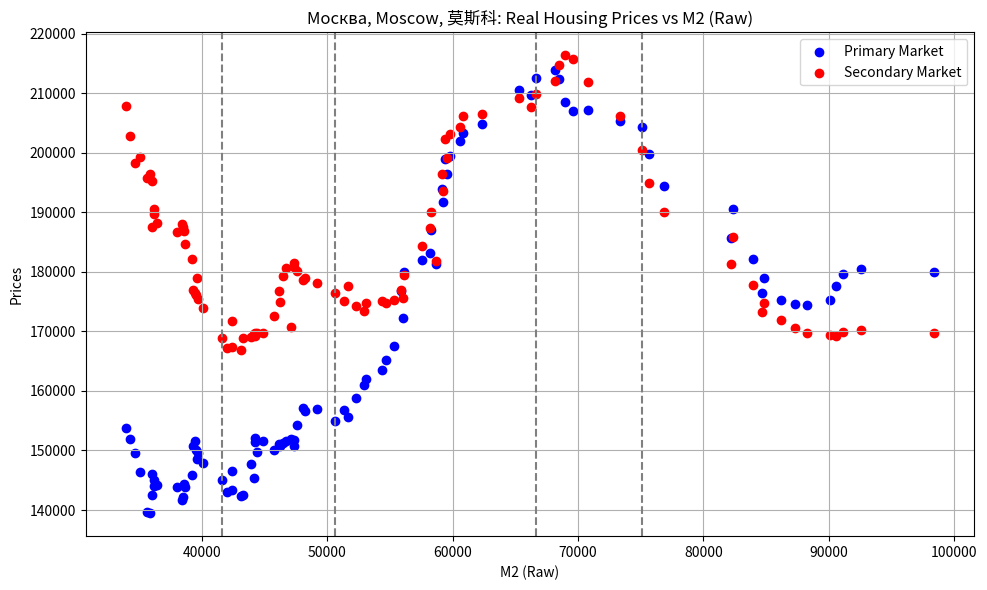

In [238]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

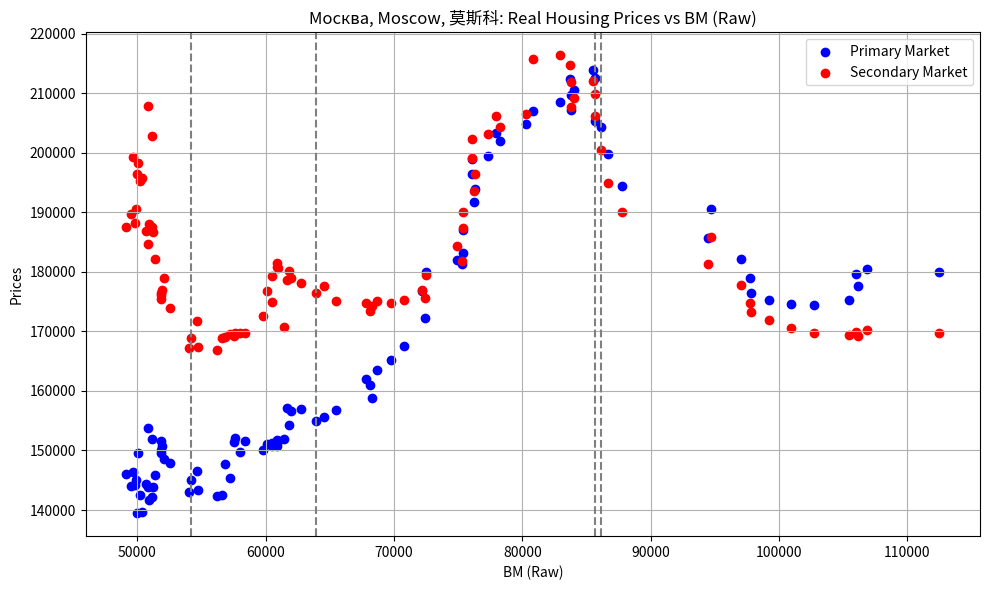

In [239]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='BM',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

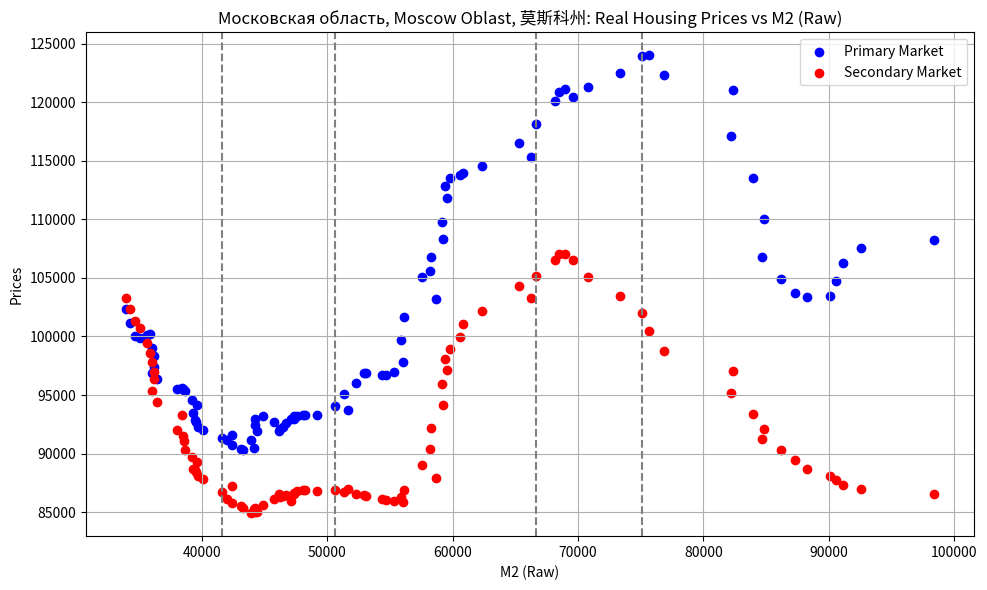

In [240]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

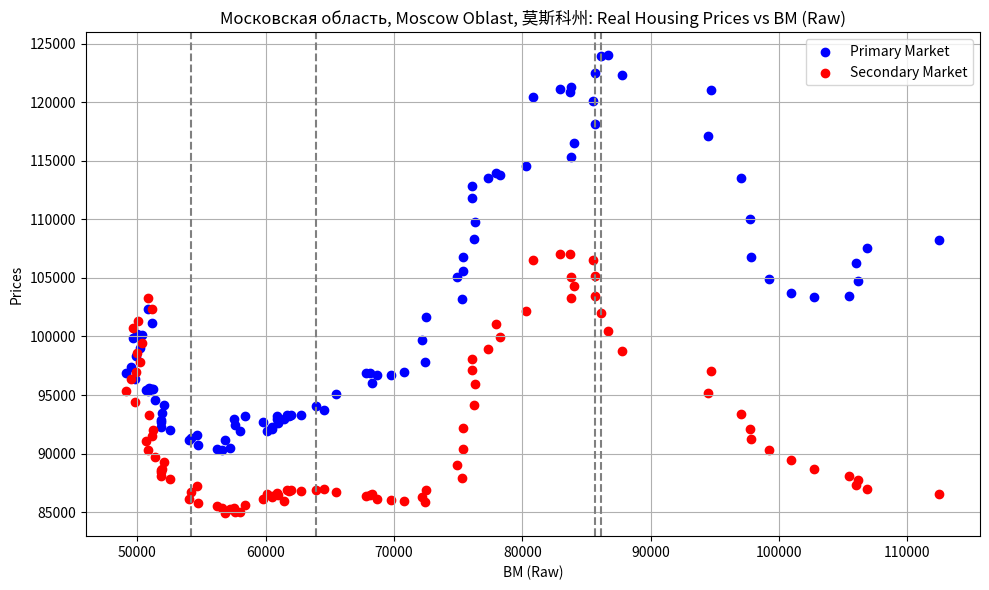

In [241]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='BM',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

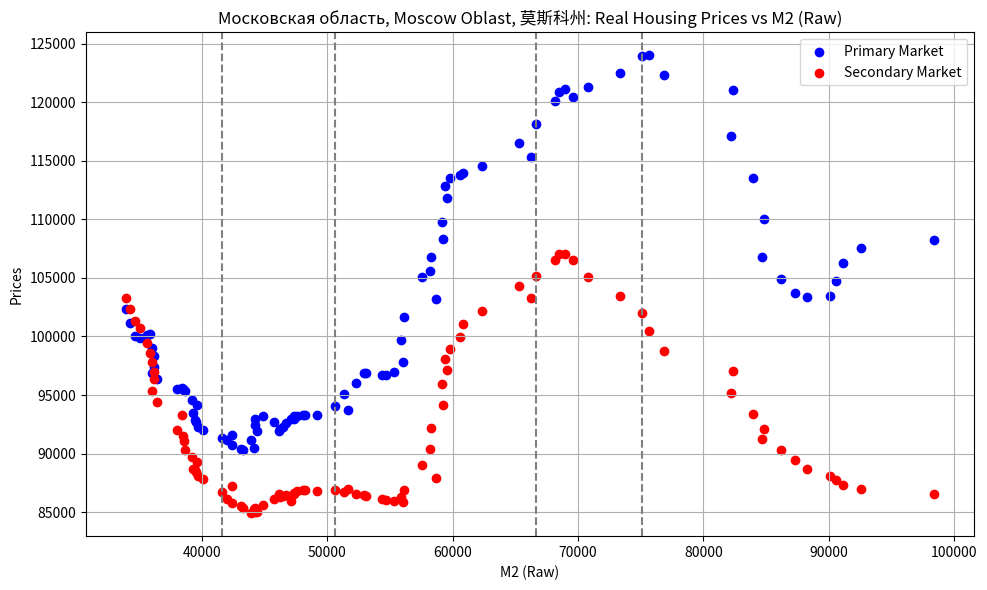

In [242]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

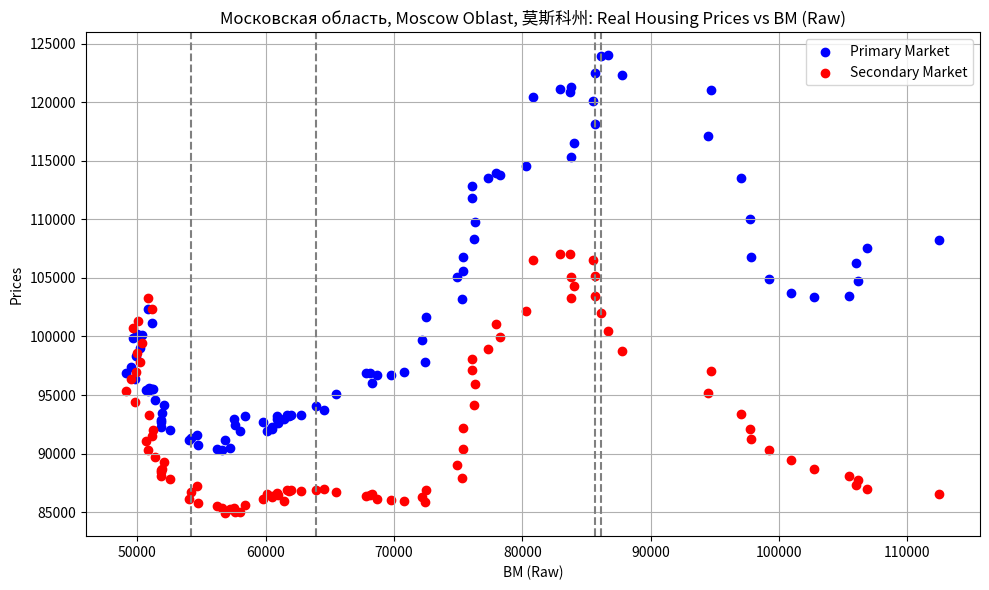

In [243]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='BM',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

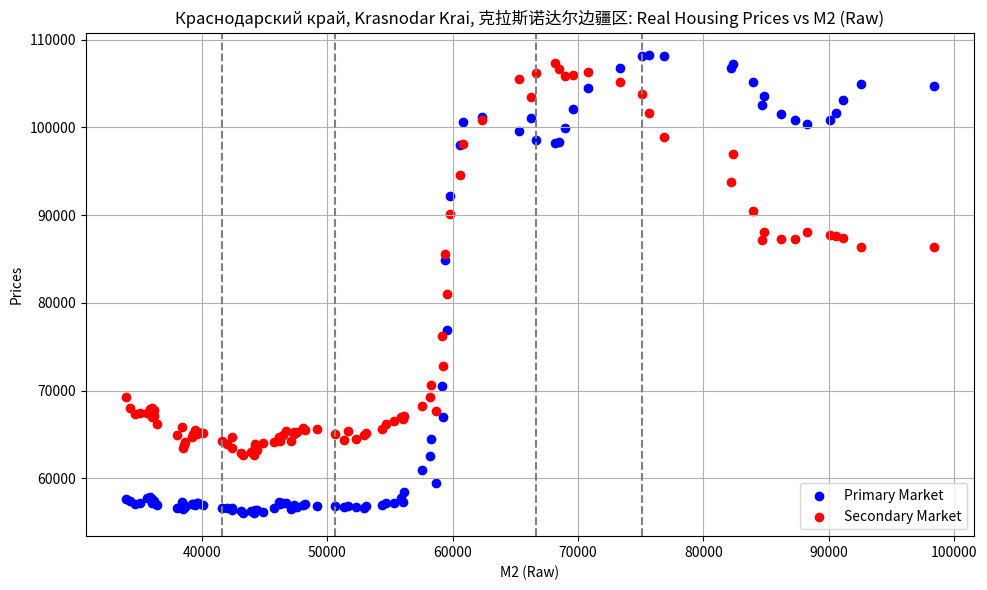

In [244]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

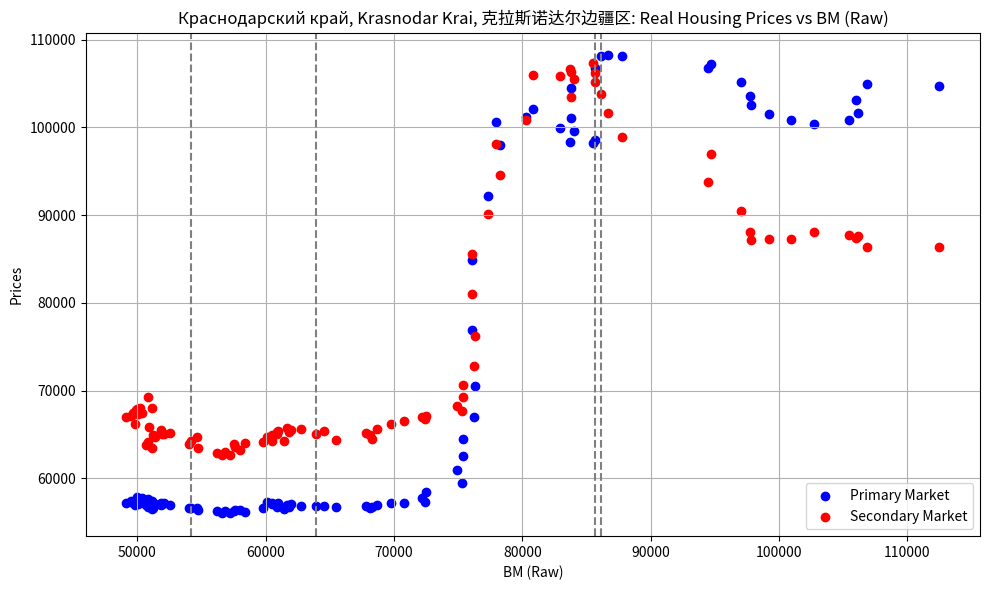

In [245]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='BM',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

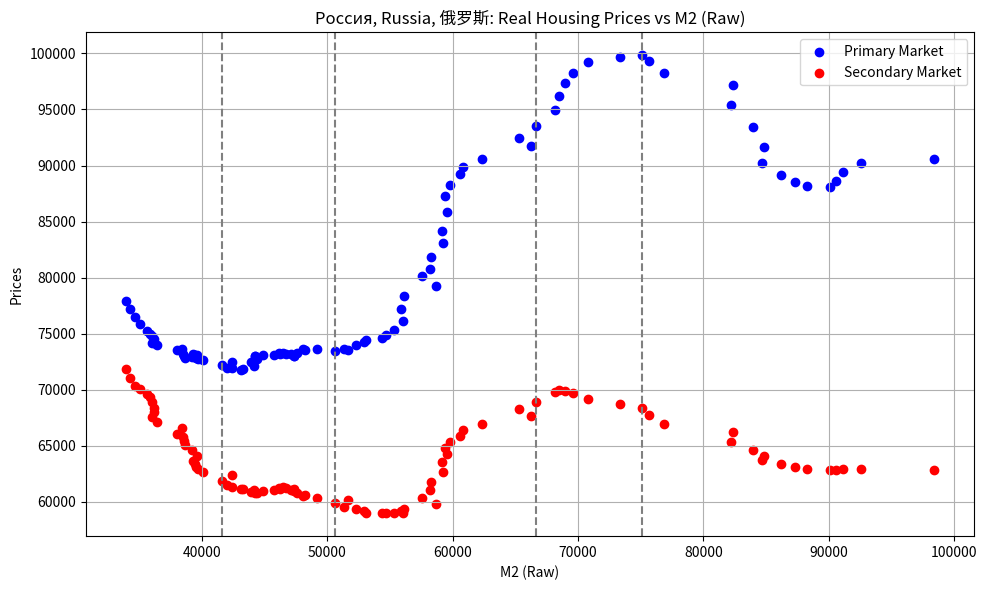

In [246]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

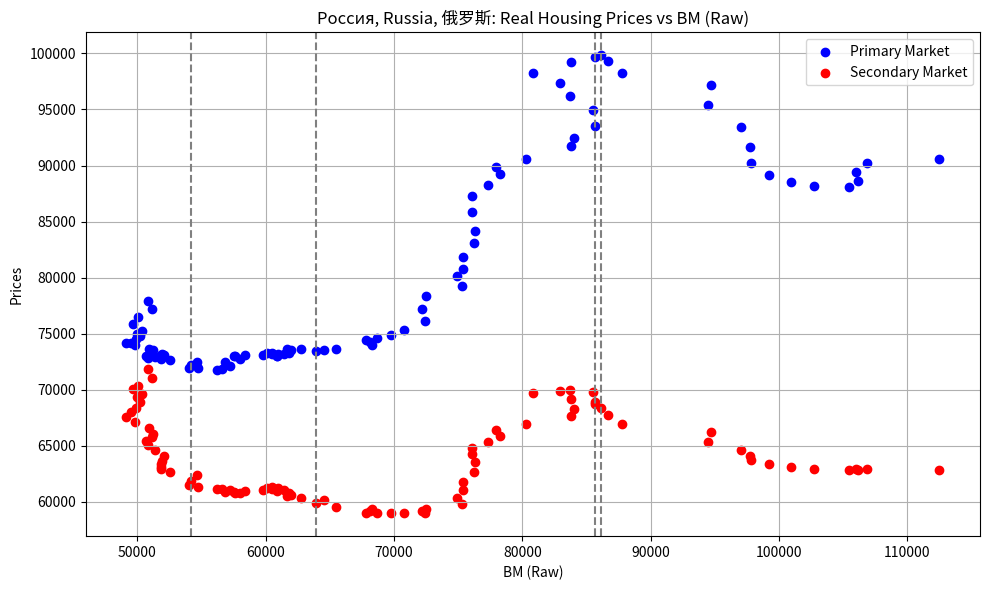

In [247]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='BM',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

Save charts for all regions. They are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [248]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']
syv.save_scatter_plots_for_regions(
    merged_agg_primary_secondary_df,
    'value_real_primary',
    'value_real_secondary',
    'raw',
    specific_dates
)

In [249]:
merged_agg_primary_secondary_df = syv.calculate_growth_rates(merged_agg_primary_secondary_df)

Let us plot graphs showing changes in real prices as well as in M2 money supply and broad money supply for key regions as well as Russia as a whole.

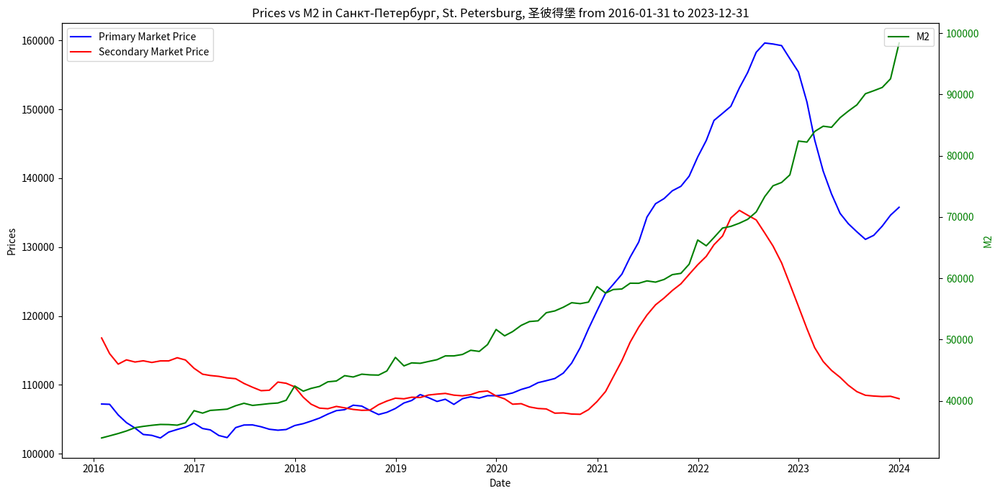

In [250]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

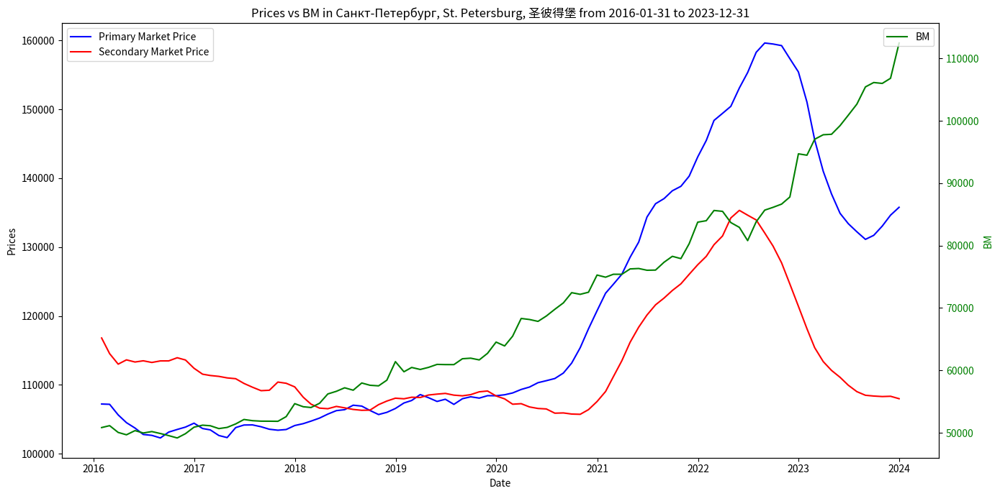

In [251]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='BM',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

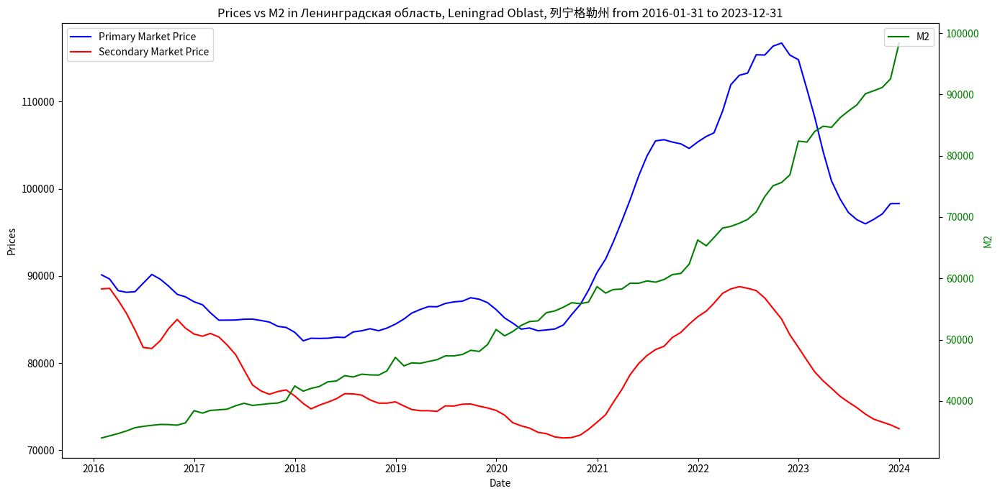

In [252]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

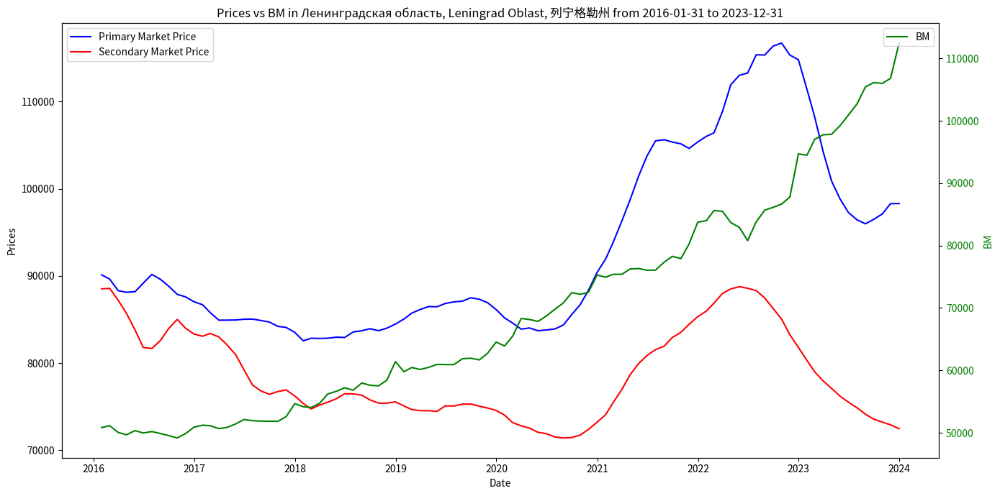

In [253]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='BM',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

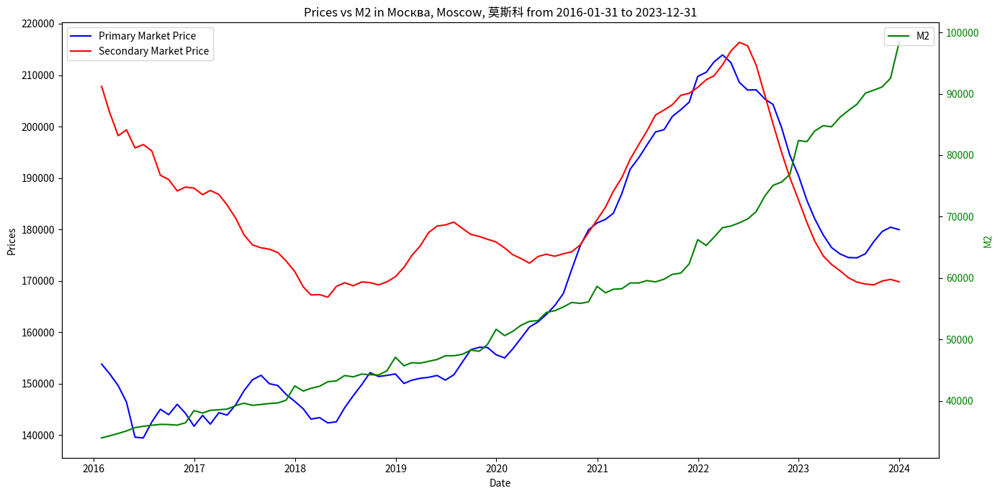

In [254]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

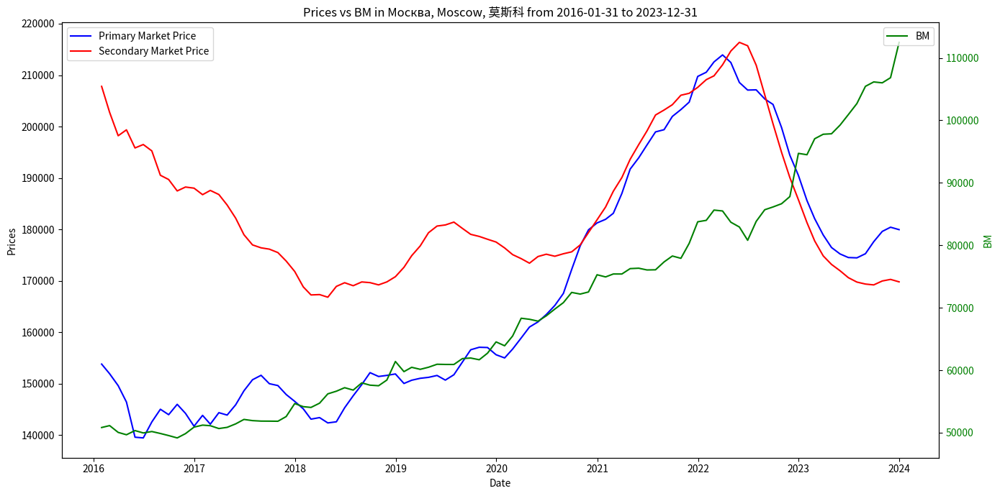

In [255]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='BM',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

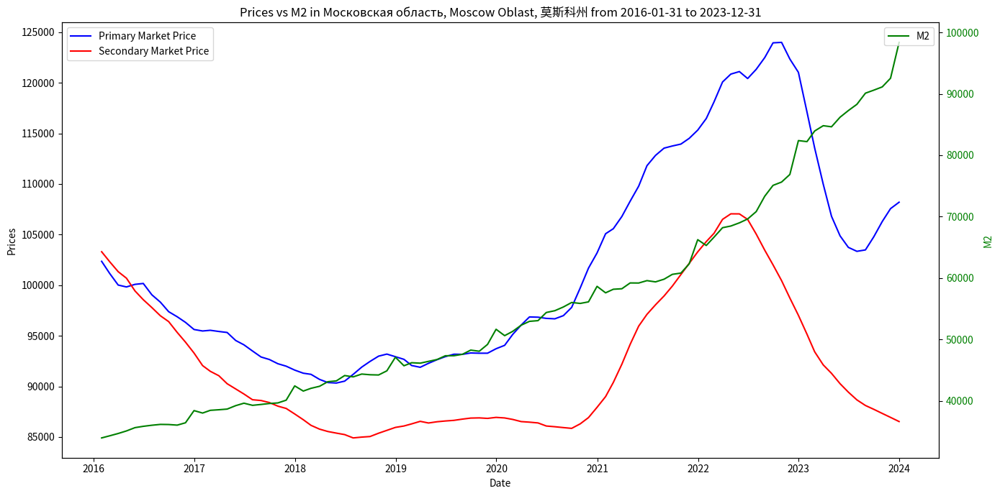

In [256]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

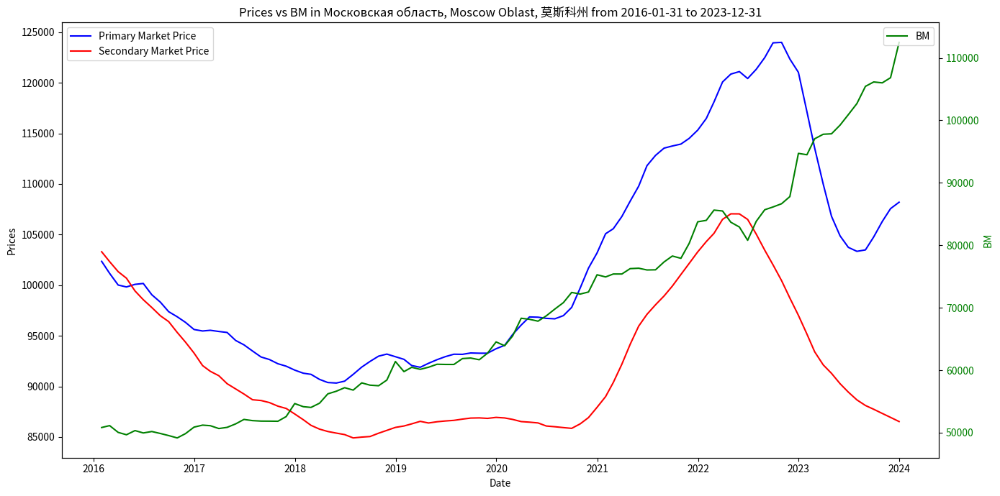

In [257]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='BM',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

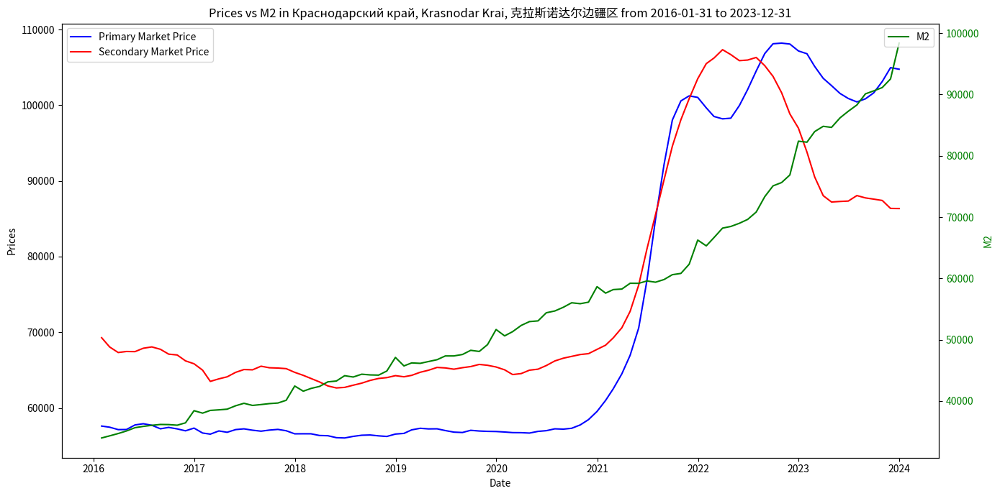

In [258]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

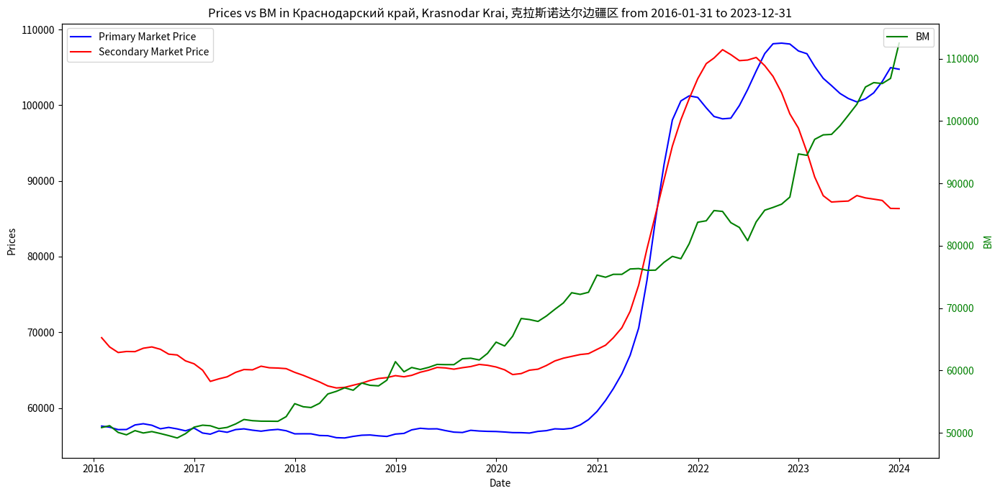

In [259]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='BM',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

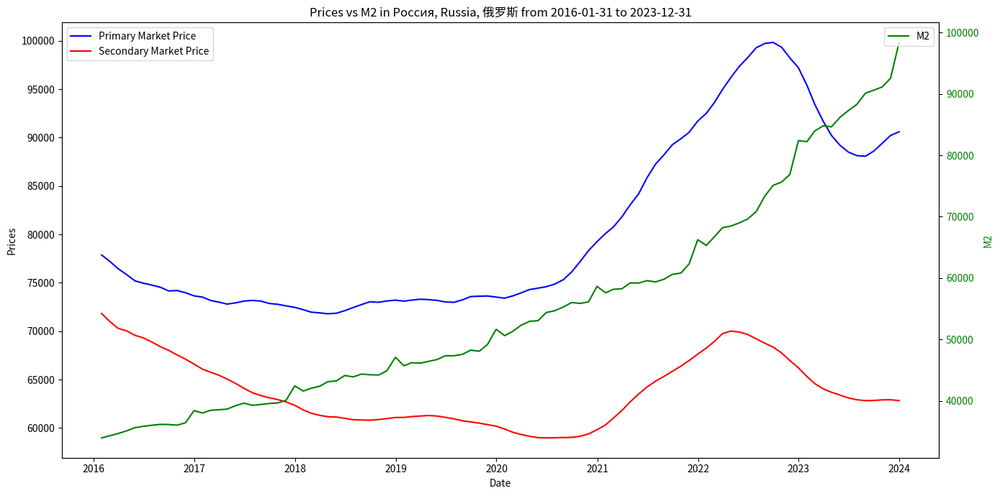

In [260]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

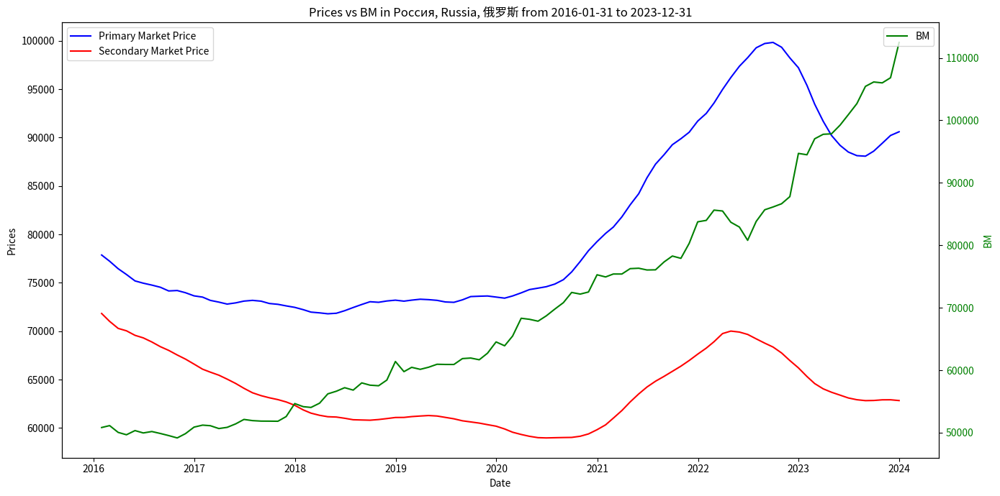

In [261]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='BM',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

Save charts for all regions. They are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [262]:
syv.save_all_regions_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    'M2',
    '2016-01-31',
    '2023-12-31'
)

In [263]:
syv.save_all_regions_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    'BM',
    '2016-01-31',
    '2023-12-31'
)

### 7.2 Relationship between the Key Rate and real prices

Read the Key Rate data.

In [264]:
key_rate_df = syv.read_key_rate_data()
key_rate_df.reset_index(drop=True, inplace=True)
print(key_rate_df.head(5))
print(key_rate_df.tail(5))

         date  key_rate
0  2016-01-01      0.11
1  2016-01-11      0.11
2  2016-01-12      0.11
3  2016-01-13      0.11
4  2016-01-14      0.11
            date  key_rate
1996  2023-12-26      0.16
1997  2023-12-27      0.16
1998  2023-12-28      0.16
1999  2023-12-29      0.16
2000  2024-01-03      0.16


Let's calculate weighted average values of the CBR key rate for each month.

In [265]:
weighted_key_rates = syv.calculate_weighted_average_key_rate(key_rate_df)
weighted_key_rates

,date,average_key_rate
0,2016-01-31,0.110000
1,2016-02-29,0.110000
2,2016-03-31,0.110000
3,2016-04-30,0.110000
4,2016-05-31,0.110000
5,2016-06-30,0.107167
6,2016-07-31,0.105000
7,2016-08-31,0.105000
8,2016-09-30,0.102813
9,2016-10-31,0.100000


Let's combine price and weighted average key rate data.

In [266]:
prices_vs_rates_df = syv.merge_prices_with_key_rates(merged_primary_secondary_df, weighted_key_rates)

Let's plot the dynamics of prices and key rate for 5 main regions: St. Petersburg, Leningrad Region, Moscow, Moscow Region, Krasnodar Krai, as well as for Russia as a whole.

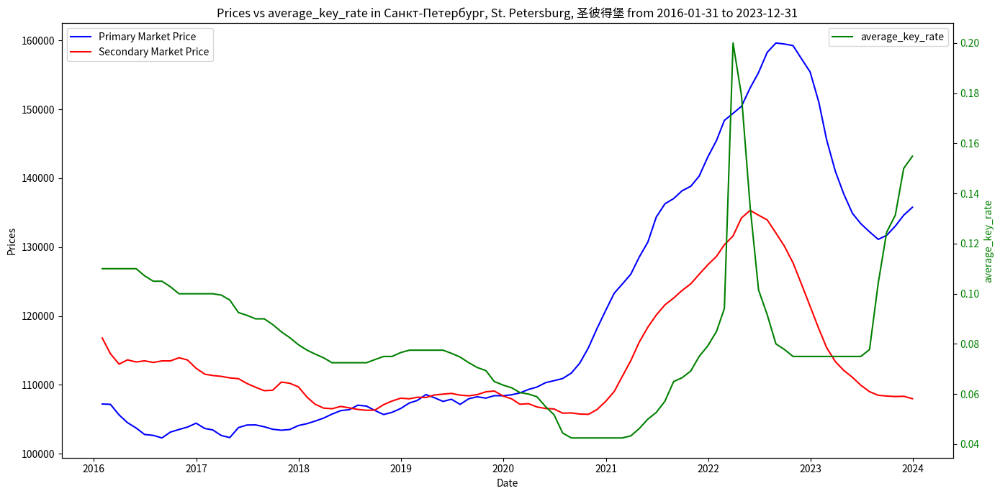

In [267]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

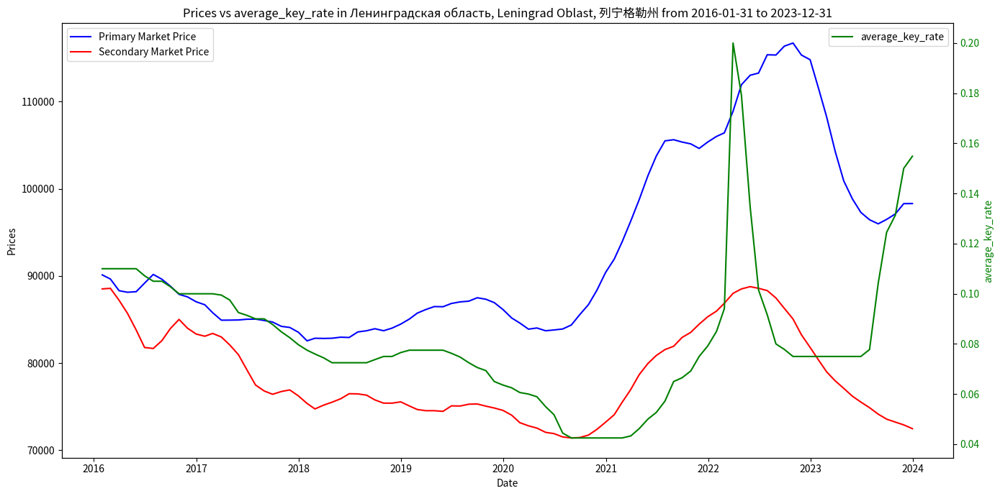

In [268]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

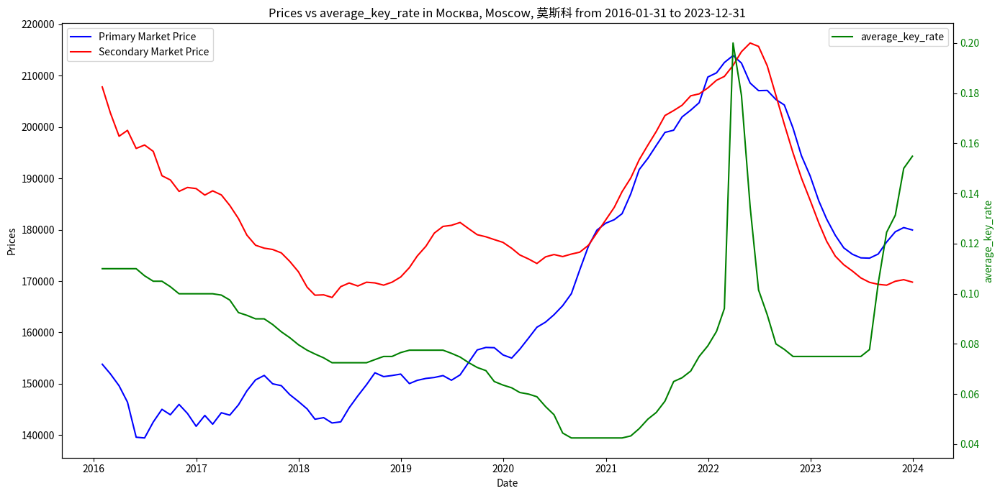

In [269]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

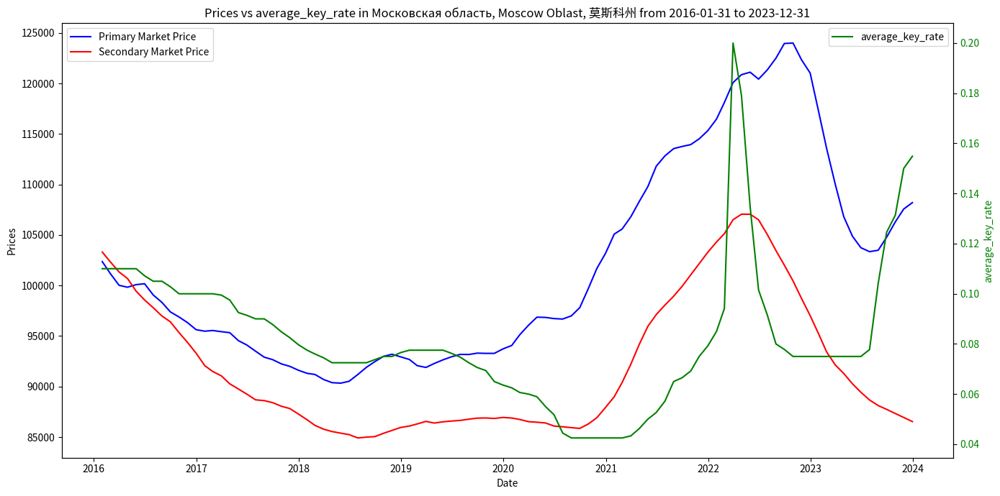

In [270]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

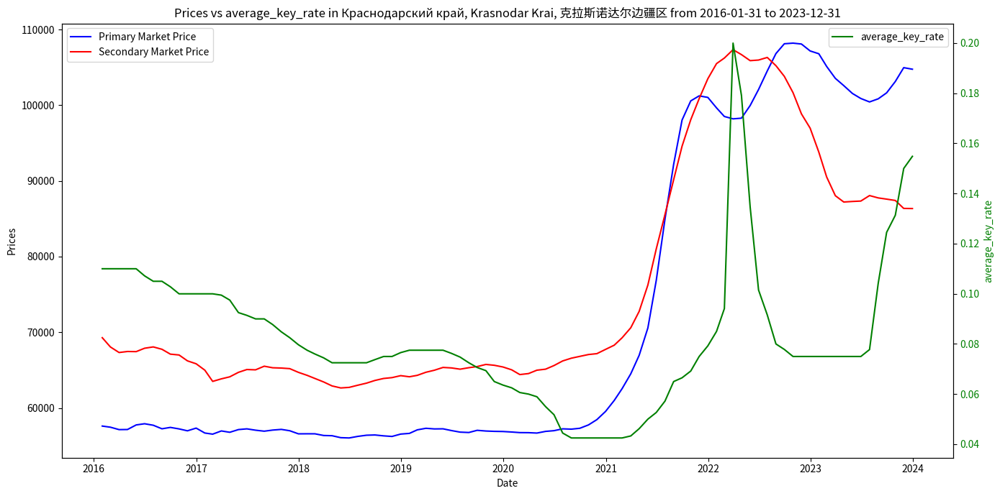

In [271]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

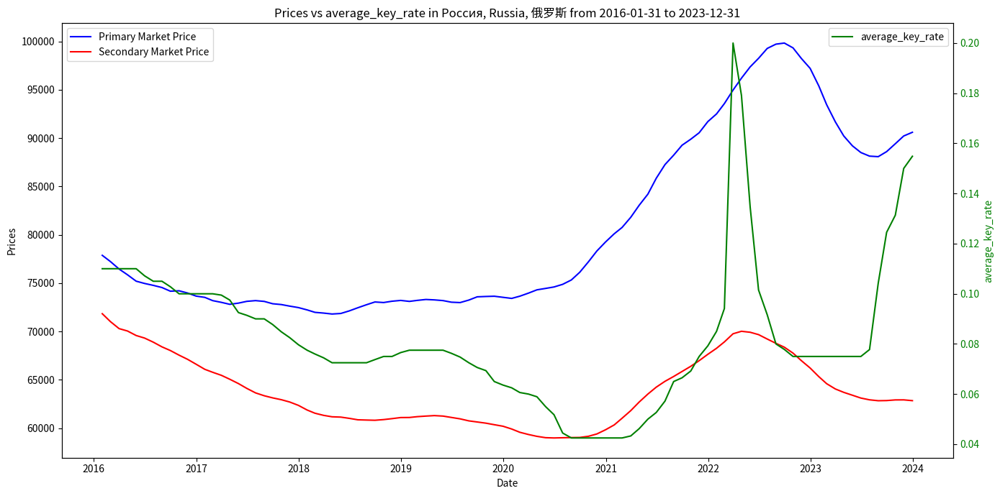

In [272]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

Save charts for all regions. They are available at [link](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [273]:
syv.save_all_regions_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    'average_key_rate',
    '2016-01-31',
    '2023-12-31'
)

## Feedback

For feedback, questions and suggestions use: [Facebook group Artificial Intelligence in Valuation](https://www.facebook.com/groups/1977067932456703) or [Telegram channel Artificial Intelligence in Valuation](https://t.me/AIinValuation).